In [1]:
#!/bin/env python

import os
import sys
import glob
import pickle
import h5py
from pyhdf.SD import SD, SDC
import numpy as np
import pandas as pd
import datetime
import time
from scipy.io import readsav
from scipy import interpolate
from scipy import stats
from scipy.optimize import curve_fit
import matplotlib as mpl
#mpl.use('Agg')
import matplotlib.pyplot as plt
from matplotlib.ticker import FixedLocator
from matplotlib import rcParams
import matplotlib
import matplotlib.gridspec as gridspec
import matplotlib.patches as mpatches

from er3t.pre.atm import atm_atmmod
from er3t.pre.abs import abs_16g, abs_oco_idl
from er3t.pre.cld import cld_sat
from er3t.pre.sfc import sfc_sat
from er3t.pre.pha import pha_mie_wc as pha_mie # newly added for phase function
from er3t.util.modis import modis_l1b, modis_l2, modis_03, modis_09a1, grid_modis_by_extent, grid_modis_by_lonlat, download_modis_https, get_sinusoidal_grid_tag, get_filename_tag, download_modis_rgb
from er3t.util.oco2 import oco2_std, download_oco2_https
from er3t.util import cal_r_twostream

from er3t.rtm.mca_v010 import mca_atm_1d, mca_atm_3d, mca_sfc_2d
from er3t.rtm.mca_v010 import mcarats_ng
from er3t.rtm.mca_v010 import mca_out_ng
from er3t.rtm.mca_v010 import mca_sca # newly added for phase function

import timeit
import argparse

from oco_rgb_test_ywc_0203 import *
import matplotlib.image as mpimg
from matplotlib import cm
from scipy.interpolate import interpn
from scipy import stats
import seaborn as sns
import pandas as pd

from oco_post_class_ywc import *
import copy

%matplotlib inline

In [2]:
def cmap_map(function, cmap):
    """ Applies function (which should operate on vectors of shape 3: [r, g, b]), on colormap cmap.
    This routine will break any discontinuous points in a colormap.
    """
    cdict = cmap._segmentdata
    step_dict = {}
    # Firt get the list of points where the segments start or end
    for key in ('red', 'green', 'blue'):
        step_dict[key] = list(map(lambda x: x[0], cdict[key]))
    step_list = sum(step_dict.values(), [])
    step_list = np.array(list(set(step_list)))
    # Then compute the LUT, and apply the function to the LUT
    reduced_cmap = lambda step : np.array(cmap(step)[0:3])
    old_LUT = np.array(list(map(reduced_cmap, step_list)))
    new_LUT = np.array(list(map(function, old_LUT)))
    # Now try to make a minimal segment definition of the new LUT
    cdict = {}
    for i, key in enumerate(['red','green','blue']):
        this_cdict = {}
        for j, step in enumerate(step_list):
            if step in step_dict[key]:
                this_cdict[step] = new_LUT[j, i]
            elif new_LUT[j,i] != old_LUT[j, i]:
                this_cdict[step] = new_LUT[j, i]
        colorvector = list(map(lambda x: x + (x[1], ), this_cdict.items()))
        colorvector.sort()
        cdict[key] = colorvector

    return matplotlib.colors.LinearSegmentedColormap('colormap',cdict,1024)

In [3]:
def run_er3t_rgb(band_tag, cfg_info):

    # define date and region to study
    # ===============================================================
    date   = datetime.datetime(int(cfg_info['date'][:4]),    # year
                               int(cfg_info['date'][4:6]),   # month
                               int(cfg_info['date'][6:])     # day
                              )
    # subdomain of one tile
    extent = [float(loc) for loc in cfg_info['subdomain']]
    # whole domain of the master interested region (png file)
    full_domain = [float(loc) for loc in cfg_info['pngwesn']]
    print(cfg_info['cfg_name'])
    name_tag = '%s_%s' % (cfg_info['cfg_name'], date.strftime('%Y%m%d'))
    # ===============================================================

    # create data/australia_YYYYMMDD directory if it does not exist
    # ===============================================================
    fdir_data = os.path.abspath('data/%s' % name_tag)
    if not os.path.exists(fdir_data):
        os.makedirs(fdir_data)
    # ===============================================================
    
    # download satellite data based on given date and region
    # ===============================================================
    fname_sat = '%s/sat.pk' % fdir_data
    sat0 = satellite_download(date=date, fdir_out=fdir_data, extent=extent, fname=fname_sat, overwrite=False)
    # ===============================================================
    return sat0

In [4]:
def run_sim(cfg):
    cfg_info = grab_cfg(cfg)
    # check whether the output file exist
    # run simulation only when there is no output file
    if 1:#not check_h5_info(cfg, 'o2'): 
        starttime = timeit.default_timer()
        o2_h5 = run_er3t_rgb('o2a', cfg_info)
        #save_h5_info(cfg, 'o2', o2_h5)
        endtime = timeit.default_timer()
        print('O2A band duration:',(endtime-starttime)/3600.,' h')
        return o2_h5, cfg_info

In [5]:
def para_corr(lon0, lat0, vza, vaa, cld_h, sfc_h, R_earth=6378000.0, verbose=True):

    """
    Parallax correction for the cloud positions

    lon0: input longitude
    lat0: input latitude
    vza : sensor zenith angle [degree]
    vaa : sensor azimuth angle [degree]
    cld_h: cloud height [meter]
    sfc_h: surface height [meter]
    """

    if verbose:
        print('Message [para_corr]: Please make sure the units of \'cld_h\' and \'sfc_h\' are in \'meter\'.')

    dist = (cld_h-sfc_h)*np.tan(np.deg2rad(vza))

    delta_lon = dist*np.sin(np.deg2rad(vaa)) / (np.pi*R_earth) * 180.0
    delta_lat = dist*np.cos(np.deg2rad(vaa)) / (np.pi*R_earth) * 180.0

    lon = lon0 + delta_lon
    lat = lat0 + delta_lat

    return lon, lat

def wind_corr(lon0, lat0, u, v, dt, R_earth=6378000.0, verbose=True):

    """
    Wind correction for the cloud positions

    lon0: input longitude
    lat0: input latitude
    u   : meridional wind [meter/second], positive when eastward
    v   : zonal wind [meter/second], positive when northward
    dt  : delta time [second]
    """

    if verbose:
        print('Message [wind_corr]: Please make sure the units of \'u\' and \'v\' are in \'meter/second\' and \'dt\' in \'second\'.')
        print('Message [wind_corr]: U: %.4f m/s; V: %.4f m/s; Time offset: %.2f s' % (u, v, dt))

    delta_lon = (u*dt) / (np.pi*R_earth) * 180.0
    delta_lat = (v*dt) / (np.pi*R_earth) * 180.0

    lon = lon0 + delta_lon
    lat = lat0 + delta_lat

    return lon, lat


In [6]:
def output_h5_info(cfg, index):
    """
    Check whether the output h5 name is saved in cfg file
    """
    try: 
        cfg_file = grab_cfg(cfg)
    except OSError as err:
        print('{} not exists!'.format(cfg))
        return False
    if index in cfg_file.keys():
        if cfg_file[index][-2:] == 'h5':
            return cfg_file[index]
    else:
        return False

In [7]:

id_list = []
cfg_dir = '../simulation/'

boundary_list = []
cfg = 'cfg/20181004_8.csv'


cfg_info = grab_cfg(f'{cfg_dir}/{cfg}')
if 'o2' in cfg_info.keys():
    id_list.append(output_h5_info(f'{cfg_dir}/{cfg}', 'o2')[-12:-3])
    boundary_list.append([[float(i) for i in cfg_info['subdomain']], 'r'])
else:
    boundary_list.append([[float(i) for i in cfg_info['subdomain']], 'orange'])

print(id_list)
for i in range(len(id_list)):
    id_num = id_list[i]
    #filename = '../simulation/output_1e8/data_all_20150622_{}_{}.h5'
    filename = '../simulation/data_all_20181004_{}_{}_cer_cot_2.5e6_7runs.h5'
    o2a_file  = filename.format('o2a', id_num)
    #wco2_file = filename.format('wco2', id_num)
    #sco2_file = filename.format('sco2', id_num)
    for (var, varfile) in [('o1', o2a_file),]:# ('o2', wco2_file)]:#, ('o3', sco2_file)]:
        vars()['{}_temp{}'.format(var, i)] = OCOSIM(varfile)
        #for j in range(8):
        #    vars()['{}_temp{}'.format(var, i)].slopes(j)
        #near_rad_calc(vars()['{}_temp{}'.format(var, i)])
        #slopes_propagation(vars()['{}_temp{}'.format(var, i)])
for var in ['o1',]:# 'o2']:#, 'o3']:
    vars()[var] = copy.copy(vars()['{}_temp0'.format(var)])
    #for i in range(1, len(id_list)):
    #    vars()[var].combine(vars()['{}_temp{}'.format(var, i)])

['6310_6332']


In [8]:
o1.snd[0,0]

2018100409221271

In [9]:
o1.snd.shape#.flatten()

(22, 8)

In [42]:
cfg = 'cfg/20181004_8.csv'
sat, cfg_info = run_sim(cfg)
#png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
#       [-57.97, -57.51, 1.63, 2.25]]
#mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
#lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
#                                                      mod.data['ref']['data'][0, :], extent=sat.extent)
#lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
#                                                      mod.data['ref']['data'][1, :], extent=sat.extent)

"""
fig = plt.figure(figsize=(5, 11))

ax1 = fig.add_axes([0.05, 0.3, 0.9, 0.65])
ax2 = fig.add_axes([0.05, 0.185, 0.9, 0.1])
ax3 = fig.add_axes([0.05, 0.025, 0.9, 0.1])
label_size = 14

img = mpimg.imread(sat.fnames['mod_rgb'][0])
ax1.imshow(img,extent=sat.extent)
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]
ax1.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax1.set_ylim(np.min(lat_dom), np.max(lat_dom))
ax1.set_xlabel('Longitude', fontsize=label_size)
ax1.set_ylabel('Latitude', fontsize=label_size)

sns.histplot(rgb_array[['r', 'g', 'b']], kde=True, fill=False, ax=ax2)
ax2.set_xlabel('Scale', fontsize=label_size)
ax2.set_ylabel('Counts', fontsize=label_size)
ax2.set_xlim(0, 1)

sns.histplot(mod_sfc_alb_2d_band1.flatten(), kde=True, fill=False, ax=ax3, label='band 1:620-670nm')
sns.histplot(mod_sfc_alb_2d_band2.flatten(), kde=True, fill=False, ax=ax3, label='band 2:841-876nm')
ax3.set_xlabel('Mod09', fontsize=label_size)
ax3.set_ylabel('Counts', fontsize=label_size)
ax3.legend()
ax3.set_xlim(0, 1)
plt.show()
"""

20181004_8
O2A band duration: 1.7605147223144336e-06  h


"\nfig = plt.figure(figsize=(5, 11))\n\nax1 = fig.add_axes([0.05, 0.3, 0.9, 0.65])\nax2 = fig.add_axes([0.05, 0.185, 0.9, 0.1])\nax3 = fig.add_axes([0.05, 0.025, 0.9, 0.1])\nlabel_size = 14\n\nimg = mpimg.imread(sat.fnames['mod_rgb'][0])\nax1.imshow(img,extent=sat.extent)\nlon_dom = sat.extent[:2]\nlat_dom = sat.extent[2:]\nax1.set_xlim(np.min(lon_dom), np.max(lon_dom))\nax1.set_ylim(np.min(lat_dom), np.max(lat_dom))\nax1.set_xlabel('Longitude', fontsize=label_size)\nax1.set_ylabel('Latitude', fontsize=label_size)\n\nsns.histplot(rgb_array[['r', 'g', 'b']], kde=True, fill=False, ax=ax2)\nax2.set_xlabel('Scale', fontsize=label_size)\nax2.set_ylabel('Counts', fontsize=label_size)\nax2.set_xlim(0, 1)\n\nsns.histplot(mod_sfc_alb_2d_band1.flatten(), kde=True, fill=False, ax=ax3, label='band 1:620-670nm')\nsns.histplot(mod_sfc_alb_2d_band2.flatten(), kde=True, fill=False, ax=ax3, label='band 2:841-876nm')\nax3.set_xlabel('Mod09', fontsize=label_size)\nax3.set_ylabel('Counts', fontsize=label_

In [43]:
[sat.fnames['mod_09'][0].replace('/data/schmidt/er3t/oco/', '')]

['/Users/yuch8913/Desktop/oco/simulation/data/20181004_8_20181004/MOD09A1.A2018273.h22v04.061.2021350154008.hdf']

In [68]:
#cfg = 'cfg/20181004_1.csv'
oco_alb_o2a, oco_alb_wco2, oco_alb_sco2 = [], [], []
mod09_alb_band1, mod09_alb_band2, mod09_alb_band3 = [], [], []
mod09_alb_band4, mod09_alb_band6, mod09_alb_band7 = [], [], []

sat, cfg_info = run_sim(cfg)
#png       = ['../simulation/data/20181004_9_20181004/aqua_rgb_2018-10-04_55.80-56.30-41.70-42.50.png',
#             [55.8, 56.3, 41.7, 42.5]]
png       = ['../simulation/data/20181004_3_20181004/aqua_rgb_2018-10-04_55.80-56.05-42.10-42.50.png',
             [55.8, 56.05, 42.1, 42.5]]
mod = modis_09a1(fnames=[sat.fnames['mod_09'][0].replace('/data/schmidt/er3t/oco/', '')], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][0, :], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][1, :], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][2, :], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][3, :], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][5, :], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][6, :], extent=sat.extent)
lon_2d_modis = lon_2d.copy()
lat_2d_modis = lat_2d.copy()



vnames = [
        'BRDFResults/brdf_reflectance_o2',              # 0.77 microns
        'BRDFResults/brdf_reflectance_slope_o2',
        'BRDFResults/brdf_reflectance_strong_co2',      # 2.06 microns
        'BRDFResults/brdf_reflectance_slope_strong_co2',
        'BRDFResults/brdf_reflectance_weak_co2',        # 1.615 microns
        'BRDFResults/brdf_reflectance_slope_weak_co2'
          ]
oco = oco2_std(fnames=sat.fnames['oco_std'], vnames=vnames, extent=sat.extent)

oco_lon = oco.data['lon']['data']
oco_lat = oco.data['lat']['data']
logic = (oco_lon>=sat.extent[0]) & (oco_lon<=sat.extent[1]) & (oco_lat>=sat.extent[2]) & (oco_lat<=sat.extent[3])
oco_lon = oco_lon[logic]
oco_lat = oco_lat[logic]
oco_sfc_alb_o2a = oco.data['brdf_reflectance_o2']['data']

oco_sfc_alb_wco2 = oco.data['brdf_reflectance_weak_co2']['data']

oco_sfc_alb_sco2 = oco.data['brdf_reflectance_strong_co2']['data']

img = mpimg.imread(sat.fnames['mod_rgb'][0].replace('/data/schmidt/er3t/oco/', ''))
img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
img_lon2d, img_lat2d = np.meshgrid(img_lon, img_lat)

lat_interval = abs(lat_2d[0, 1]-lat_2d[0, 0])/2
lon_interval = abs(lon_2d[1, 0]-lon_2d[0, 0])/2
img_reshape = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
print(len(lat_2d[:, 0]), len(lon_2d[0, :]))
print(img_reshape.shape)
for i in range(len(lon_2d[:, 0])):
    for j in range(len(lat_2d[0, :])):
        index_lon2 = np.argmin(np.abs(img_lon-lon_2d[i, 0]-lon_interval))
        index_lon1 = np.argmin(np.abs(img_lon-lon_2d[i, 0]+lon_interval))
        index_lat2 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]-lat_interval))
        index_lat1 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]+lat_interval))
        img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:index_lon2+1, :3], axis=(0, 1))

        """if index_lat2 == len(lat_2d[0, :])-1 and index_lon2 != len(lon_2d[0, :])-1:
            img_reshape[j, i, :] = np.nanmean(img[index_lat1:, index_lon1:index_lon2+1, :3], axis=(0, 1))
        elif index_lat2 != len(lat_2d[0, :])-1 and index_lon2 == len(lon_2d[0, :])-1:
            img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:, :3], axis=(0, 1))
        elif index_lat2 == len(lat_2d[0, :])-1 and index_lon2 == len(lon_2d[0, :])-1:
            img_reshape[j, i, :] = np.nanmean(img[index_lat1:, index_lon1:, :3], axis=(0, 1))
        else:
            img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:index_lon2+1, :3], axis=(0, 1))

        """
points = np.transpose(np.vstack((lon_2d.ravel(), lat_2d.ravel())))
data_bkg_band1 = interpolate.griddata(points, mod_sfc_alb_2d_band1.ravel(),
                                      (oco_lon, oco_lat), method='nearest')
data_bkg_band2 = interpolate.griddata(points, mod_sfc_alb_2d_band2.ravel(),
                                      (oco_lon, oco_lat), method='nearest')
data_bkg_band3 = interpolate.griddata(points, mod_sfc_alb_2d_band3.ravel(),
                                      (oco_lon, oco_lat), method='nearest')
data_bkg_band4 = interpolate.griddata(points, mod_sfc_alb_2d_band4.ravel(),
                                      (oco_lon, oco_lat), method='nearest')
data_bkg_band6 = interpolate.griddata(points, mod_sfc_alb_2d_band6.ravel(),
                                      (oco_lon, oco_lat), method='nearest')
data_bkg_band7 = interpolate.griddata(points, mod_sfc_alb_2d_band7.ravel(),
                                      (oco_lon, oco_lat), method='nearest')
oco_alb_o2a.extend(oco_sfc_alb_o2a)
oco_alb_wco2.extend(oco_sfc_alb_wco2)
oco_alb_sco2.extend(oco_sfc_alb_sco2)

mod09_alb_band1.extend(data_bkg_band1)
mod09_alb_band2.extend(data_bkg_band2)
mod09_alb_band3.extend(data_bkg_band3)
mod09_alb_band4.extend(data_bkg_band4)
mod09_alb_band6.extend(data_bkg_band6)
mod09_alb_band7.extend(data_bkg_band7)

# band 1: 620  - 670  nm, index 0
# band 2: 841  - 876  nm, index 1
# band 3: 459  - 479  nm, index 2
# band 4: 545  - 565  nm, index 3
# band 5: 1230 - 1250 nm, index 4
# band 6: 1628 - 1652 nm, index 5
# band 7: 2105 - 2155 nm, index 6

#R = 0.66 μm
#G = 0.55 μm
#B = 0.47 μm

20181004_8
O2A band duration: 2.3038472212040992e-07  h
52 82
(82, 52, 3)


In [69]:
(lon_2d.shape)

(52, 82)

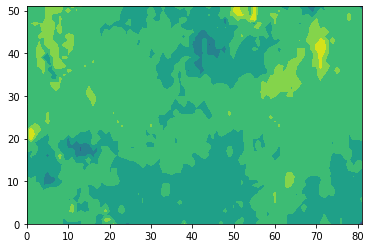

In [70]:
plt.contourf(mod_sfc_alb_2d_band1)

In [71]:
def rgb2hsv(rgb):
    """ convert RGB to HSV color space

    :param rgb: np.ndarray
    :return: np.ndarray
    """

    rgb = rgb.astype('float')
    maxv = np.amax(rgb, axis=2)
    maxc = np.argmax(rgb, axis=2)
    minv = np.amin(rgb, axis=2)
    minc = np.argmin(rgb, axis=2)

    hsv = np.zeros(rgb.shape, dtype='float')
    hsv[maxc == minc, 0] = np.zeros(hsv[maxc == minc, 0].shape)
    hsv[maxc == 0, 0] = (((rgb[..., 1] - rgb[..., 2]) * 60.0 / (maxv - minv + np.spacing(1))) % 360.0)[maxc == 0]
    hsv[maxc == 1, 0] = (((rgb[..., 2] - rgb[..., 0]) * 60.0 / (maxv - minv + np.spacing(1))) + 120.0)[maxc == 1]
    hsv[maxc == 2, 0] = (((rgb[..., 0] - rgb[..., 1]) * 60.0 / (maxv - minv + np.spacing(1))) + 240.0)[maxc == 2]
    hsv[maxv == 0, 1] = np.zeros(hsv[maxv == 0, 1].shape)
    hsv[maxv != 0, 1] = (1 - minv / (maxv + np.spacing(1)))[maxv != 0]
    hsv[..., 2] = maxv

    return hsv

In [140]:
mod_rgb = mpl_img.imread(sat.fnames['mod_rgb'][0])

lon_rgb0 = np.linspace(sat.extent[0], sat.extent[1], mod_rgb.shape[1]+1)
lat_rgb0 = np.linspace(sat.extent[2], sat.extent[3], mod_rgb.shape[0]+1)
lon_rgb = (lon_rgb0[1:]+lon_rgb0[:-1])/2.0
lat_rgb = (lat_rgb0[1:]+lat_rgb0[:-1])/2.0
lon_rgb_2d, lat_rgb_2d = np.meshgrid(lon_rgb, lat_rgb[::-1], indexing='xy')

mod_r = mod_rgb[:, :, 0]
mod_g = mod_rgb[:, :, 1]
mod_b = mod_rgb[:, :, 2]
mod_hsv = rgb2hsv(mod_rgb[:,:,:3])
mod_h = mod_hsv[:, :, 0]
mod_s = mod_hsv[:, :, 1]
mod_v = mod_hsv[:, :, 2]
rgb_array = pd.DataFrame(mod_rgb.reshape(mod_rgb.shape[0]*mod_rgb.shape[1], mod_rgb.shape[2]),
                        columns=['r', 'g', 'b', 'scale'])
rgb_array['h'] = mod_h.reshape(mod_rgb.shape[0]*mod_rgb.shape[1])
rgb_array['s'] = mod_s.reshape(mod_rgb.shape[0]*mod_rgb.shape[1])
rgb_array['v'] = mod_v.reshape(mod_rgb.shape[0]*mod_rgb.shape[1])
rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
value = np.array(rgb_array['v']).reshape(mod_rgb.shape[0], mod_rgb.shape[1])
rgb_array

,r,g,b,scale,h,s,v,r/g,r/b,g/b
0,0.658824,0.603922,0.490196,1.0,40.465120,0.255952,0.658824,1.090909,1.344000,1.232000
1,0.658824,0.603922,0.490196,1.0,40.465120,0.255952,0.658824,1.090909,1.344000,1.232000
2,0.658824,0.603922,0.490196,1.0,40.465120,0.255952,0.658824,1.090909,1.344000,1.232000
3,0.658824,0.603922,0.490196,1.0,40.465120,0.255952,0.658824,1.090909,1.344000,1.232000
4,0.658824,0.603922,0.490196,1.0,40.465120,0.255952,0.658824,1.090909,1.344000,1.232000
...,...,...,...,...,...,...,...,...,...,...
1200271,0.800000,0.788235,0.729412,1.0,50.000000,0.088235,0.800000,1.014925,1.096774,1.080645
1200272,0.800000,0.788235,0.729412,1.0,50.000000,0.088235,0.800000,1.014925,1.096774,1.080645
1200273,0.800000,0.788235,0.729412,1.0,50.000000,0.088235,0.800000,1.014925,1.096774,1.080645
1200274,0.800000,0.788235,0.729412,1.0,50.000000,0.088235,0.800000,1.014925,1.096774,1.080645


In [49]:
np.array([mod_r, mod_g, mod_b]).shape

(3, 1386, 866)

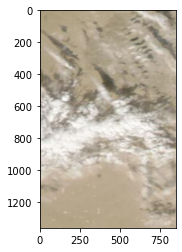

In [20]:
plt.imshow(mod_rgb)


(array([  5848.,   9193.,  74529.,  93651., 171398., 572359., 151569.,
         60352.,  46806.,  14571.]),
 array([0.30588236, 0.37529413, 0.44470589, 0.51411766, 0.58352942,
        0.65294118, 0.72235295, 0.79176471, 0.86117647, 0.93058824,
        1.        ]),
 <BarContainer object of 10 artists>)

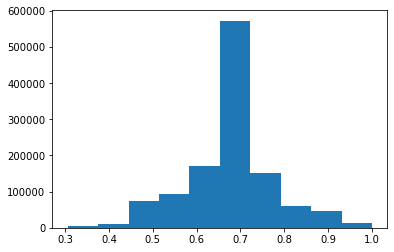

In [158]:
plt.hist(mod_v.flatten())

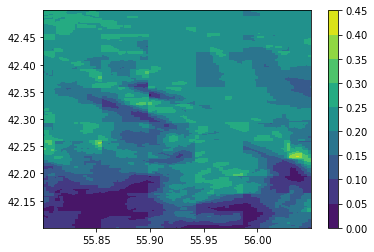

In [161]:
plt.contourf(lon_rgb_2d, lat_rgb_2d, mod_s)
plt.colorbar()

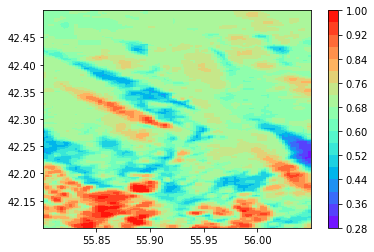

In [167]:
plt.contourf(lon_rgb_2d, lat_rgb_2d, mod_v, levels=21, cmap='rainbow')
plt.colorbar()

In [116]:
mod_r.shape

(1386, 866)

'\nif ymax>3.8:\n    ymax = 3.8\n    ax.set_ylim(ymin, ymax)\nif ymin<-0.2:\n    ymin = -0.2\n    ax.set_ylim(ymin, ymax)\n'

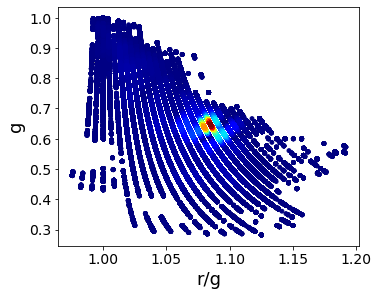

In [112]:
fig, (ax) = plt.subplots(1, 1, figsize=(6, 5), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
#ax_list = [ax11, ax12, ax21, ax22]
label_size = 18
tick_size = 14
xy_list = [('r/g', 'g'), ('r', 'b'), ('r', 'r/g'), ('r', 'r/b')]
#ax = ax_list[i]
i=0

x = rgb_array['r/g']
y = rgb_array['g']
mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
x, y = x[mask], y[mask]
# Calculate the point density
data , x_e, y_e = np.histogram2d(x, y, bins=25, density=True)
z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
z[np.where(np.isnan(z))] = 0.0
z[np.where(np.isinf(z))] = np.nanmax(z)
z[np.where(z<0)] = 0.0
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]

# plot figure
ax.scatter(plot_x, plot_y, c=z, s=15, cmap=light_jet)
x_array = np.array([np.min(x), np.max(x)])

"""
ax.plot(x_array, x_array, 'r', label='ideal')
slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
"""
ax.set_xlabel(xy_list[i][0], fontsize=label_size)
ax.set_ylabel(xy_list[i][1], fontsize=label_size)
#ax.set_xticks(range(0, 160, 20))
ax.xaxis.set_tick_params(labelsize=tick_size)
ax.yaxis.set_tick_params(labelsize=tick_size)
xmin, xmax = ax.get_xlim()
ymin, ymax = ax.get_ylim()
"""
if ymax>3.8:
    ymax = 3.8
    ax.set_ylim(ymin, ymax)
if ymin<-0.2:
    ymin = -0.2
    ax.set_ylim(ymin, ymax)
"""
#ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')

#ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
#        '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')

In [ ]:
rgb_array

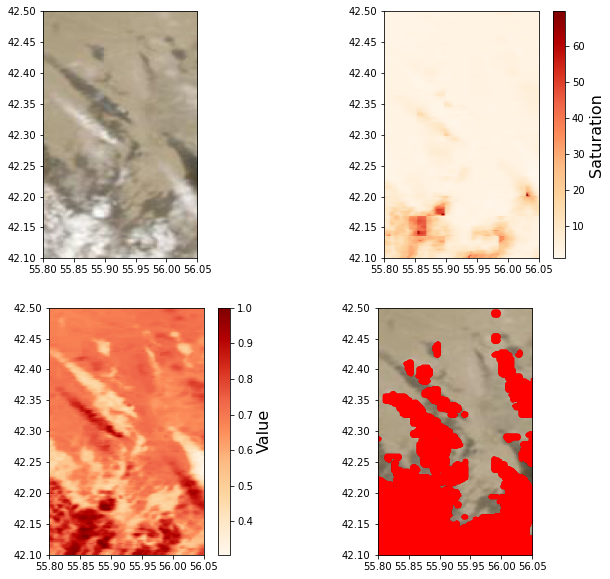

In [181]:
f,((frame0, frame1), (frame2, frame3))=plt.subplots(2, 2, figsize=(11, 10))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)

lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
for ax in [frame0, frame1, frame2, frame3]:
    ax.imshow(img,extent=wesn)
    ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax.set_ylim(np.min(lat_dom), np.max(lat_dom))

cc = frame1.scatter(lon_rgb_2d.flatten(), lat_rgb_2d.flatten(), c=rgb_array['v/s'],
              s=20, marker='o', cmap='OrRd')
cbar = f.colorbar(cc, ax=frame1)
cbar.set_label('Saturation', fontsize=16)

cc2 = frame2.scatter(lon_rgb_2d.flatten(), lat_rgb_2d.flatten(), c=rgb_array['v'],
              s=20, marker='o', cmap='OrRd')

cbar2 = f.colorbar(cc2, ax=frame2)
cbar2.set_label('Value', fontsize=16)

#mask = np.logical_and(rgb_array['v']>=0.75, rgb_array['s']<=0.15)
#mask = rgb_array['v']>=0.8
mask = rgb_array['s']<=0.18
cc3 = frame3.scatter(lon_rgb_2d.flatten()[mask], lat_rgb_2d.flatten()[mask], c='r',
              s=5, marker='o', cmap='OrRd')
#cbar3 = f.colorbar(cc3, ax=frame3)
#cbar3.set_label('r/g', fontsize=16)

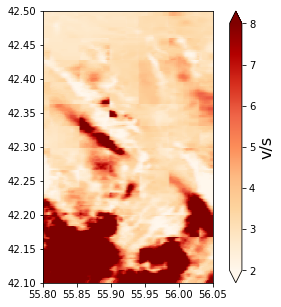

In [204]:
f, ax = plt.subplots(1, 1, figsize=(6, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
ax.imshow(img,extent=wesn)
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))

#"""
cc = ax.scatter(lon_rgb_2d.flatten(), lat_rgb_2d.flatten(), c=rgb_array['v']/rgb_array['s'],
              s=20, marker='o', cmap='OrRd',
              vmin=2, vmax=8)

cbar = f.colorbar(cc, ax=ax, extend='both')
cbar.set_label('v/s', fontsize=16)
#"""

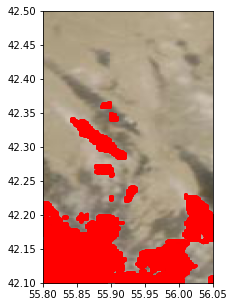

In [224]:
f, ax = plt.subplots(1, 1, figsize=(6, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
ax.imshow(img,extent=wesn)
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))

#"""
mask = rgb_array['v/s']>=6
cc3 = ax.scatter(lon_rgb_2d.flatten()[mask], lat_rgb_2d.flatten()[mask], c='r',
              s=1, marker='o', cmap='OrRd')
#"""

In [295]:
oco_lon.shape

(98,)

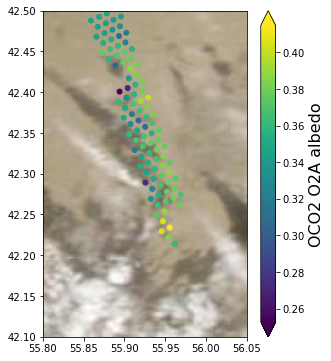

In [299]:
f, ax = plt.subplots(1, 1, figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
ax.imshow(img,extent=wesn)
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))

#"""
cc = ax.scatter(oco_lon, oco_lat, c=oco_alb_o2a, s=25)
cbar = f.colorbar(cc, ax=ax, extend='both')
cbar.set_label('OCO2 O2A albedo', fontsize=16)
#"""


In [165]:
f = h5py.File(sat.fnames['oco_l1b'][0], 'r')
lon_oco_l1b = f['SoundingGeometry/sounding_longitude'][...]
lat_oco_l1b = f['SoundingGeometry/sounding_latitude'][...]
logic = (lon_oco_l1b>=sat.extent[0]) & (lon_oco_l1b<=sat.extent[1]) & (lat_oco_l1b>=sat.extent[2]) & (lat_oco_l1b<=sat.extent[3])
sza = f['SoundingGeometry/sounding_solar_zenith'][...][logic].mean()
saa = f['SoundingGeometry/sounding_solar_azimuth'][...][logic].mean()
vza = f['SoundingGeometry/sounding_zenith'][...][logic].mean()
vaa = f['SoundingGeometry/sounding_azimuth'][...][logic].mean()
f.close()

In [167]:
sza

49.88012

In [72]:
mod03      = modis_03(fnames=[sat.fnames['mod_03'][0].replace('/data/schmidt/er3t/oco/', '')], extent=sat.extent, vnames=['Height'])
logic_sfh  = (mod03.data['height']['data']>0.0)
lon1       = mod03.data['lon']['data']
lat1       = mod03.data['lat']['data']
sfh1       = mod03.data['height']['data']/1000.0 # units: km
sza1       = mod03.data['sza']['data']
saa1       = mod03.data['saa']['data']
vza1       = mod03.data['vza']['data']
vaa1       = mod03.data['vaa']['data']

In [164]:
saa1.mean()+360

207.75245958429562

In [170]:
modl1b = modis_l1b(fnames=[sat.fnames['mod_02'][0].replace('/data/schmidt/er3t/oco/', '')], extent=sat.extent)
lon_2d, lat_2d, ref_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent)
lon_2d, lat_2d, rad_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent)
print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][0]))
l1b_650_lon_2d, l1b_650_lat_2d, ref_650_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent)#, NxNy=(110*2, 148*2))
l1b_650_lon_2d, l1b_650_lat_2d, rad_650_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent)#, NxNy=(110*2, 148*2))
print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][1]))
l1b_860_lon_2d, l1b_860_lat_2d, ref_860_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][1, ...], extent=sat.extent)#, NxNy=(110*2, 148*2))
l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][1, ...], extent=sat.extent)#, NxNy=(110*2, 148*2))

a0         = np.median(ref_2d)
#a0 = 0.065
mu0        = np.cos(np.deg2rad(sza1.mean()))

xx_2stream = np.linspace(0.0, 200.0, 10000)
yy_2stream = cal_r_twostream(xx_2stream, a=a0, mu=mu0)

threshold  = 0.065#a0 * 1.0 # needs to be improved
#indices    = np.where(ref_2d>threshold)
indices    = np.where(ref_650_2d*ref_860_2d>threshold)
indices_x  = indices[0]
indices_y  = indices[1]
lon        = lon_2d[indices_x, indices_y]
lat        = lat_2d[indices_x, indices_y]


wavelength: 650.0nm
wavelength: 860.0nm


In [191]:
indices_x.shape

(2264,)

In [190]:
np.where(ref_860_2d>0.35)[0].shape

(877,)

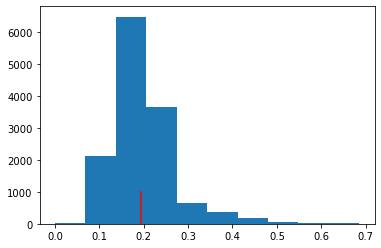

In [171]:
plt.hist(ref_2d.flatten())
plt.plot([a0, a0], [0, 1000], 'r')

In [175]:
modl2      = modis_l2(fnames=[sat.fnames['mod_l2'][0].replace('/data/schmidt/er3t/oco/', '')], extent=sat.extent,
                      vnames=['Sensor_Zenith', 'Sensor_Azimuth', 'Cloud_Top_Height'], resolution='5km')
modl2_1km      = modis_l2(fnames=[sat.fnames['mod_l2'][0].replace('/data/schmidt/er3t/oco/', '')], extent=sat.extent,
                      vnames=['cloud_top_height_1km', 'cloud_top_temperature_1km',
                              'IRW_Low_Cloud_Temperature_From_COP', 'Cirrus_Reflectance',
                              'Cloud_Effective_Radius_16', 'Cloud_Effective_Radius_37'],
                          resolution='1km')

In [75]:
sat.fnames['mod_l2'][0].replace('/data/schmidt/er3t/oco/', '')

'/Users/yuch8913/Desktop/oco/simulation/data/20181004_8_20181004/MYD06_L2.A2018277.0925.061.2018277201545.hdf'

In [178]:
modl2_1km.data.keys()

dict_keys(['lon', 'lat', 'ctp', 'cot', 'cer', 'cot_err', 'cer_err', 'pcl', 'lon_5km', 'lat_5km', 'cloud_top_height_1km', 'cloud_top_temperature_1km', 'irw_low_cloud_temperature_from_cop', 'cirrus_reflectance', 'cloud_effective_radius_16', 'cloud_effective_radius_37'])

In [192]:
cth_1km.shape

(2264,)

In [181]:
lon0       = modl2.data['lon_5km']['data']
lat0       = modl2.data['lat_5km']['data']
cth0       = modl2.data['cloud_top_height']['data']/1000.0 

logic_cth  = np.logical_and(modl2.data['cloud_top_height']['data']>0.0, modl2.data['cloud_top_height']['data']<14000.0)

points     = np.transpose(np.vstack((lon0[logic_cth], lat0[logic_cth])))

cth        = interpolate.griddata(points, cth0[logic_cth], (lon, lat), method='nearest')

lon_1km       = modl2.data['lon']['data']
lat_1km       = modl2.data['lat']['data']
cth0_1km       = modl2_1km.data['cloud_top_height_1km']['data']/1000.0 
# 'cloud_top_temperature_1km',
#'IRW_Low_Cloud_Temperature_From_COP', 'Cirrus_Reflectance'
ct_temp_1km = modl2_1km.data['cloud_top_temperature_1km']['data']+15000
lc_temp_1km = modl2_1km.data['irw_low_cloud_temperature_from_cop']['data']+15000
cir_ref_1km = modl2_1km.data['cirrus_reflectance']['data']
logic_cth_1km  = np.logical_and(modl2_1km.data['cloud_top_height_1km']['data']>0.0, modl2_1km.data['cloud_top_height_1km']['data']<14000.0)
points_1km     = np.transpose(np.vstack((lon_1km[logic_cth_1km], lat_1km[logic_cth_1km])))
cth_1km        = interpolate.griddata(points_1km, cth0_1km[logic_cth_1km], (lon, lat), method='nearest')
#cth_1km[cth_1km<5]=5

#(ref_860_2d)

lon_cer    = modl2.data['lon']['data']
lat_cer    = modl2.data['lat']['data']
cer0       = modl2.data['cer']['data']
cer0_16       = modl2_1km.data['cloud_effective_radius_16']['data']
cer0_37       = modl2_1km.data['cloud_effective_radius_37']['data']
cot0       = modl2.data['cot']['data']

points_cer = np.transpose(np.vstack((lon_cer, lat_cer)))
cer        = interpolate.griddata(points_cer, cer0, (lon, lat), method='nearest')
cer_2d = np.zeros_like(lon_2d)
cer_2d[indices_x, indices_y] = cer 
cer_2d[cer_2d<=12] = 12
modl1b.data['cer_2d'] = dict(name='Gridded cloud effective radius'  , units='micro'      , data=cer_2d)

cth_2d = np.zeros_like(lon_2d)
cth_2d[indices_x, indices_y] = cth_1km

modl1b.data['cth_2d'] = dict(name='Gridded cloud top height', units='km', data=cth_2d)

cot        = interpolate.griddata(points_cer, cot0, (lon, lat), method='nearest')
cot_2d = np.zeros_like(lon_2d)
cot_2d[indices_x, indices_y] = cot
modl1b.data['cot_2d'] = dict(name='Gridded cloud optical thickness' , units='N/A'        , data=cot_2d)


points     = np.transpose(np.vstack((lon1[logic_sfh], lat1[logic_sfh])))
sfh        = interpolate.griddata(points, sfh1[logic_sfh], (lon, lat), method='nearest')

points     = np.transpose(np.vstack((lon1, lat1)))
vza        = interpolate.griddata(points, vza1, (lon, lat), method='nearest')
vaa        = interpolate.griddata(points, vaa1, (lon, lat), method='nearest')

In [78]:
l1b_860_lon_2d, l1b_860_lat_2d, 

(array([[55.8013587 , 55.8013587 , 55.8013587 , ..., 55.8013587 ,
         55.8013587 , 55.8013587 ],
        [55.80407609, 55.80407609, 55.80407609, ..., 55.80407609,
         55.80407609, 55.80407609],
        [55.80679348, 55.80679348, 55.80679348, ..., 55.80679348,
         55.80679348, 55.80679348],
        ...,
        [56.04320652, 56.04320652, 56.04320652, ..., 56.04320652,
         56.04320652, 56.04320652],
        [56.04592391, 56.04592391, 56.04592391, ..., 56.04592391,
         56.04592391, 56.04592391],
        [56.0486413 , 56.0486413 , 56.0486413 , ..., 56.0486413 ,
         56.0486413 , 56.0486413 ]]),
 array([[42.10135135, 42.10405405, 42.10675676, ..., 42.49324324,
         42.49594595, 42.49864865],
        [42.10135135, 42.10405405, 42.10675676, ..., 42.49324324,
         42.49594595, 42.49864865],
        [42.10135135, 42.10405405, 42.10675676, ..., 42.49324324,
         42.49594595, 42.49864865],
        ...,
        [42.10135135, 42.10405405, 42.10675676, ..., 4

In [96]:
points_rad     = np.transpose(np.vstack((l1b_860_lon_2d.flatten(), l1b_860_lat_2d.flatten())))
rad0        = interpolate.griddata(points_rad, (rad_650_2d*rad_860_2d).flatten(), (lon0[logic_cth], lat0[logic_cth]), method='nearest')
plt.scatter(rad0, cth0[logic_cth])

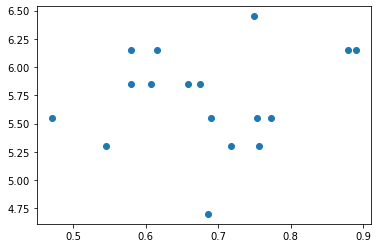

In [142]:
points_rgb     = np.transpose(np.vstack((lon_rgb_2d.flatten(), lat_rgb_2d.flatten())))
rgb0_v        = interpolate.griddata(points_rgb, value.flatten(), (lon0[logic_cth], lat0[logic_cth]), method='nearest')
plt.scatter(rgb0_v, cth0[logic_cth])

In [98]:
, 

array([5.85, 5.85, 6.45, 6.15, 5.55, 5.55, 5.85, 6.15, 5.3 , 5.3 , 5.55,
       6.15, 5.55, 5.85, 6.15, 5.3 , 4.7 ])

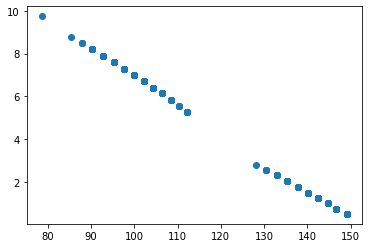

In [124]:
plt.scatter(ct_temp_1km[logic_cth_1km], cth0_1km[logic_cth_1km])

(0.0, 160.0)

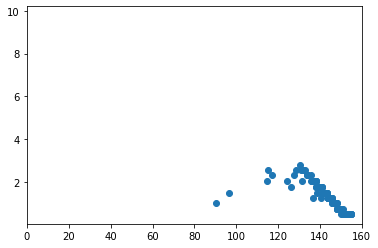

In [126]:
plt.scatter(lc_temp_1km[logic_cth_1km], cth0_1km[logic_cth_1km])
plt.xlim(0, 160)

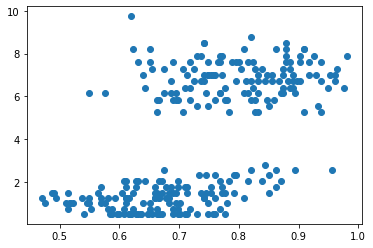

In [144]:
points_rgb     = np.transpose(np.vstack((lon_rgb_2d.flatten(), lat_rgb_2d.flatten())))
rgb0_v        = interpolate.griddata(points_rgb, value.flatten(), (lon_1km[logic_cth_1km], lat_1km[logic_cth_1km]), method='nearest')
plt.scatter(rgb0_v, cth0_1km[logic_cth_1km])

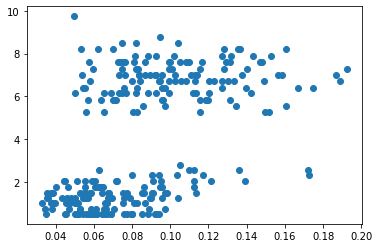

In [127]:
points_rad     = np.transpose(np.vstack((l1b_860_lon_2d.flatten(), l1b_860_lat_2d.flatten())))
rad0_1km        = interpolate.griddata(points_rad, (rad_650_2d*rad_860_2d).flatten(), (lon_1km[logic_cth_1km], lat_1km[logic_cth_1km]), method='nearest')
plt.scatter(rad0_1km, cth0_1km[logic_cth_1km])

In [107]:
lon_1km[logic_cth_1km].shape#[logic_cth_1km].shape

(267,)

In [104]:
rad0_1km.shape

(267,)

In [ ]:
plt.contourf(lon_2d, lat_2d, cer_2d,)
plt.colorbar()

In [65]:
solver = '3D'
if solver == '3D':
    lon_corr_p, lat_corr_p  = para_corr(lon, lat, vza, vaa, cth*1000.0, sfh*1000.0)
elif solver == 'IPA':
    lon_corr_p, lat_corr_p  = para_corr(lon, lat, vza, vaa, sfh, sfh)

Message [para_corr]: Please make sure the units of 'cld_h' and 'sfc_h' are in 'meter'.


In [173]:
# wind correction
# ====================================================================================================
f = h5py.File(sat.fnames['oco_l1b'][0], 'r')
lon_oco_l1b = f['SoundingGeometry/sounding_longitude'][...]
lat_oco_l1b = f['SoundingGeometry/sounding_latitude'][...]
logic = (lon_oco_l1b>=sat.extent[0]) & (lon_oco_l1b<=sat.extent[1]) & (lat_oco_l1b>=sat.extent[2]) & (lat_oco_l1b<=sat.extent[3])
utc_oco_byte = f['SoundingGeometry/sounding_time_string'][...][logic]
f.close()
utc_oco = np.zeros(utc_oco_byte.size, dtype=np.float64)
for i, utc_oco_byte0 in enumerate(utc_oco_byte):
    utc_oco_str0 = utc_oco_byte0.decode('utf-8').split('.')[0]
    utc_oco[i] = (datetime.datetime.strptime(utc_oco_str0, '%Y-%m-%dT%H:%M:%S')-datetime.datetime(1993, 1, 1)).total_seconds()

f = SD(sat.fnames['mod_03'][0], SDC.READ)
lon_mod = f.select('Longitude')[:][::10, :]
lat_mod = f.select('Latitude')[:][::10, :]
utc_mod = f.select('SD start time')[:]
f.end()
logic = (lon_mod>=sat.extent[0]) & (lon_mod<=sat.extent[1]) & (lat_mod>=sat.extent[2]) & (lat_mod<=sat.extent[3])
logic = (np.sum(logic, axis=1)>0)
utc_mod = utc_mod[logic]

f = h5py.File(sat.fnames['oco_met'][0], 'r')
lon_oco_met = f['SoundingGeometry/sounding_longitude'][...]
lat_oco_met = f['SoundingGeometry/sounding_latitude'][...]
logic = (lon_oco_met>=sat.extent[0]) & (lon_oco_met<=sat.extent[1]) & (lat_oco_met>=sat.extent[2]) & (lat_oco_met<=sat.extent[3])
u_oco = f['Meteorology/windspeed_u_met'][...][logic]
v_oco = f['Meteorology/windspeed_v_met'][...][logic]
f.close()

lon_corr, lat_corr  = wind_corr(lon_corr_p, lat_corr_p, np.median(u_oco), np.median(v_oco), utc_oco.mean()-utc_mod.mean())
# ====================================================================================================

lon_1d = lon_2d[:, 0]
indices_x_new = np.int_(np.round((lon_corr-lon_1d[0])/(((lon_1d[1:]-lon_1d[:-1])).mean()), decimals=0))
lat_1d = lat_2d[0, :]
indices_y_new = np.int_(np.round((lat_corr-lat_1d[0])/(((lat_1d[1:]-lat_1d[:-1])).mean()), decimals=0))

Nx, Ny = ref_2d.shape
cot_2d_l1b = np.zeros_like(ref_2d)
for i in range(indices_x.size):
    if 0<=indices_x_new[i]<Nx and 0<=indices_y_new[i]<Ny:
        cot_2d_l1b[indices_x_new[i], indices_y_new[i]] = xx_2stream[np.argmin(np.abs(yy_2stream-ref_650_2d[indices_x[i], indices_y[i]]))]
scale_factor = 1
modl1b.data['cot_2d'] = dict(name='Gridded cloud optical thickness' , units='N/A'        , data=cot_2d_l1b*scale_factor)
cot_2d = cot_2d_l1b*scale_factor

Message [wind_corr]: Please make sure the units of 'u' and 'v' are in 'meter/second' and 'dt' in 'second'.
Message [wind_corr]: U: -0.9165 m/s; V: 2.6340 m/s; Time offset: -444.70 s


In [85]:
wesn

[55.8, 56.05, 42.1, 42.5]

In [ ]:
f, ax = plt.subplots(1, 1, figsize=(6, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = wesn[:2]
lat_dom = wesn[2:]
ax.imshow(img,extent=wesn)
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))

#""", 
cc = ax.scatter(l1b_650_lon_2d.flatten(), l1b_650_lat_2d.flatten(), c=ref_650_2d*ref_860_2d,
              s=20, marker='o', cmap='OrRd',
               vmin=0., vmax=0.1,
               )

cbar = f.colorbar(cc, ax=ax, extend='both')
cbar.set_label('650nm x 860nm reflectance', fontsize=16)
#"""

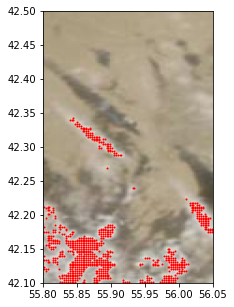

In [158]:
f, ax = plt.subplots(1, 1, figsize=(6, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = wesn[:2]
lat_dom = wesn[2:]
ax.imshow(img,extent=wesn)
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))

#"""
mask = (ref_860_2d)>=0.35
cc3 = ax.scatter(l1b_650_lon_2d[mask].flatten(), l1b_650_lat_2d[mask].flatten(), c='r',
              s=1, marker='o', cmap='OrRd')
#"""

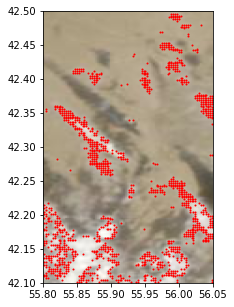

In [159]:
f, ax = plt.subplots(1, 1, figsize=(6, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = wesn[:2]
lat_dom = wesn[2:]
ax.imshow(img,extent=wesn)
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))

#"""
mask = np.logical_and((ref_860_2d)<0.35, (ref_650_2d*ref_860_2d)>=0.065)
cc3 = ax.scatter(l1b_650_lon_2d[mask].flatten(), l1b_650_lat_2d[mask].flatten(), c='r',
              s=1, marker='o', cmap='OrRd')
#"""

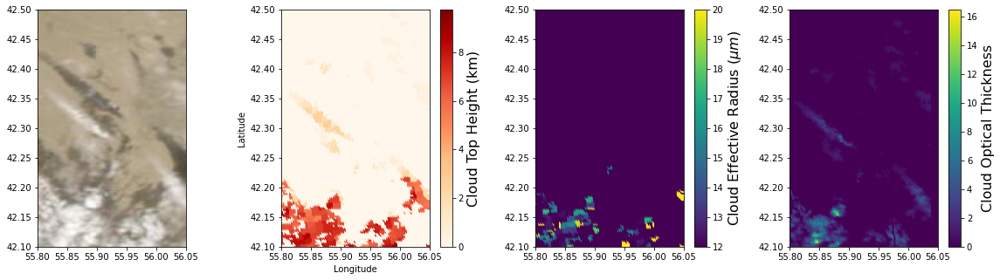

In [174]:
f,(frame0, frame, frame2, frame3)=plt.subplots(1, 4, figsize=(20, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)

lon_dom = wesn[:2]
lat_dom = wesn[2:]
for ax in [frame0, frame, frame2, frame3]:
    ax.imshow(img,extent=wesn)
    ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
#mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
#print(mask.shape, o1.lon.shape)
cc = frame.scatter(lon_2d.flatten(), lat_2d.flatten(), c=cth_2d.flatten(),
              s=20,
              marker='o', cmap='OrRd')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, ax=frame)
cbar.set_label('Cloud Top Height (km)', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude')
frame.set_ylabel('Latitude')

cc2 = frame2.scatter(lon_2d.flatten(), lat_2d.flatten(), c=cer_2d.flatten(),
                    vmin=12, vmax=20)
cbar2 = f.colorbar(cc2, ax=frame2)
cbar2.set_label('Cloud Effective Radius ($\mu m$)', fontsize=16)

cc3 = frame3.scatter(lon_2d.flatten(), lat_2d.flatten(), c=cot_2d.flatten(),
                    )#vmin=0, vmax=20)
cbar3 = f.colorbar(cc3, ax=frame3)
cbar3.set_label('Cloud Optical Thickness', fontsize=16)

plt.show()

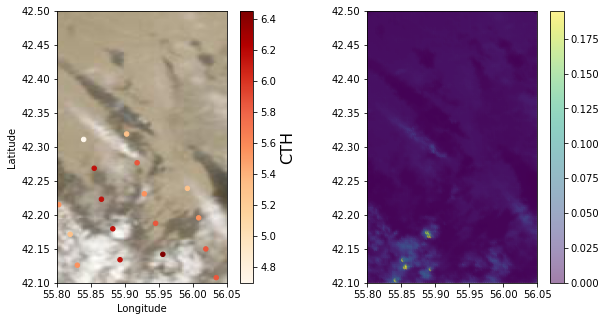

In [88]:
f,(frame, frame2)=plt.subplots(1, 2, figsize=(10.2, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = wesn[:2]
lat_dom = wesn[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
#print(mask.shape, o1.lon.shape)
cc = frame.scatter(lon0[logic_cth], lat0[logic_cth], c=cth0[logic_cth],
              s=20,
              marker='o', cmap='OrRd')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, ax=frame)
cbar.set_label('CTH', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude')
frame.set_ylabel('Latitude')


frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))
cc2 = frame2.scatter(l1b_860_lon_2d, l1b_860_lat_2d, c=rad_860_2d*rad_650_2d, s=15, alpha=0.5)
cbar2 = f.colorbar(cc2, ax=frame2)

plt.show()

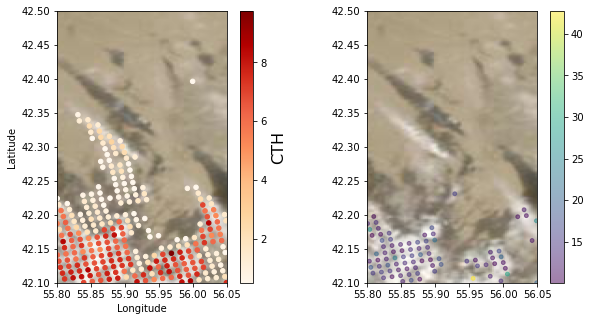

In [184]:
f,(frame, frame2)=plt.subplots(1, 2, figsize=(10.2, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = wesn[:2]
lat_dom = wesn[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
#print(mask.shape, o1.lon.shape)
cc = frame.scatter(lon_1km[logic_cth_1km], lat_1km[logic_cth_1km], c=cth0_1km[logic_cth_1km],
              s=20,
              marker='o', cmap='OrRd')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, ax=frame)
cbar.set_label('CTH', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude')
frame.set_ylabel('Latitude')


frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))
cc2 = frame2.scatter(lon_cer[cer0>10], lat_cer[cer0>10], c=cer0[cer0>10], s=15, alpha=0.5)
cbar2 = f.colorbar(cc2, ax=frame2)

plt.show()

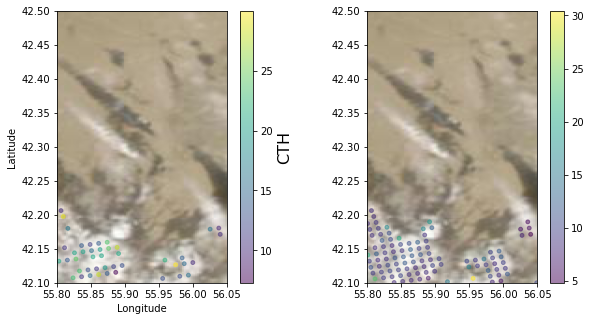

In [183]:
f,(frame, frame2)=plt.subplots(1, 2, figsize=(10.2, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = wesn[:2]
lat_dom = wesn[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
#print(mask.shape, o1.lon.shape)
cc = frame.scatter(lon_cer[cer0_16>0], lat_cer[cer0_16>0], c=cer0_16[cer0_16>0], s=15, alpha=0.5)

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, ax=frame)
cbar.set_label('CTH', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude')
frame.set_ylabel('Latitude')


frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))
cc2 = frame2.scatter(lon_cer[cer0_37>0], lat_cer[cer0_37>0], c=cer0_37[cer0_37>0], s=15, alpha=0.5)
cbar2 = f.colorbar(cc2, ax=frame2)

plt.show()

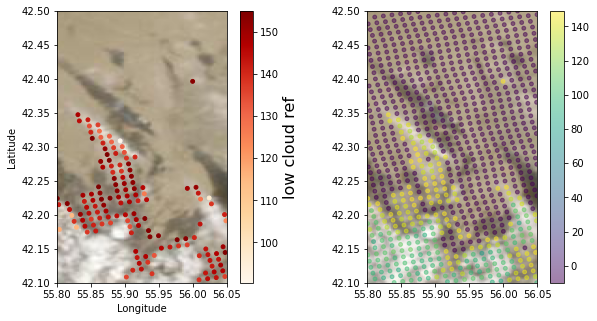

In [137]:
f,(frame, frame2)=plt.subplots(1, 2, figsize=(10.2, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = wesn[:2]
lat_dom = wesn[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
#print(mask.shape, o1.lon.shape)
cc = frame.scatter(lon_cer[lc_temp_1km>0], lat_cer[lc_temp_1km>0], c=lc_temp_1km[lc_temp_1km>0], s=15, marker='o', cmap='OrRd')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, ax=frame)
cbar.set_label('low cloud ref', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude')
frame.set_ylabel('Latitude')


frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))
cc2 = frame2.scatter(lon_cer, lat_cer, c=ct_temp_1km, s=15, alpha=0.5)
cbar2 = f.colorbar(cc2, ax=frame2)

plt.show()

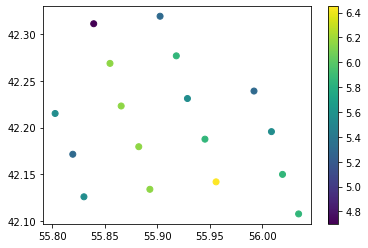

In [134]:
plt.scatter(lon0[logic_cth], lat0[logic_cth], c=cth0[logic_cth],)
plt.colorbar()

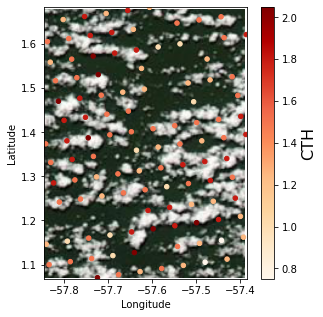

In [163]:
f,frame=plt.subplots(figsize=(5, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
#print(mask.shape, o1.lon.shape)
cc = frame.scatter(lon0[logic_cth], lat0[logic_cth], c=cth0[logic_cth],
              s=20,
              marker='o', cmap='OrRd')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)
cbar.set_label('CTH', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

In [148]:
cth0.shape

(126,)

In [149]:
cer0.shape

(3136,)

In [153]:
modl2.data

{'lon': {'name': 'Longitude',
  'data': array([-57.39412988, -57.40415643, -57.38538029, ..., -57.82565406,
         -57.83533179, -57.84500955]),
  'units': 'degrees'},
 'lat': {'name': 'Latitude',
  'data': array([1.06922537, 1.06781202, 1.08010764, ..., 1.68111053, 1.67973417,
         1.67835792]),
  'units': 'degrees'},
 'ctp': {'name': 'Cloud thermodynamic phase',
  'data': array([1., 2., 2., ..., 2., 2., 2.]),
  'units': 'N/A'},
 'cot': {'name': 'Cloud optical thickness',
  'data': array([0.        , 3.39999992, 2.43999995, ..., 3.85999991, 5.24999988,
         0.        ]),
  'units': 'N/A'},
 'cer': {'name': 'Cloud effective radius',
  'data': array([ 1.        , 17.54999961, 10.26999977, ..., 12.40999972,
         16.76999963,  1.        ]),
  'units': 'micron'},
 'cot_err': {'name': 'Cloud optical thickness uncertainty',
  'data': array([0.        , 0.10914   , 0.11907199, ..., 0.13741599, 0.14962499,
         0.        ]),
  'units': 'N/A'},
 'cer_err': {'name': 'Cloud effe

In [154]:
modl2.data['cloud_top_height']['data'].shape

(126,)

(array([1911.,    0.,    0.,    0.,    2.,   15.,   33.,   50.,   75.,
         102.,  122.,  153.,  160.,  116.,   91.,   69.,   53.,   39.,
          40.,   26.,   20.,   26.,   19.,    9.,    5.]),
 array([ 1.        ,  2.15879997,  3.31759995,  4.47639992,  5.63519989,
         6.79399987,  7.95279984,  9.11159981, 10.27039979, 11.42919976,
        12.58799973, 13.74679971, 14.90559968, 16.06439965, 17.22319962,
        18.3819996 , 19.54079957, 20.69959954, 21.85839952, 23.01719949,
        24.17599946, 25.33479944, 26.49359941, 27.65239938, 28.81119936,
        29.96999933]),
 <BarContainer object of 25 artists>)

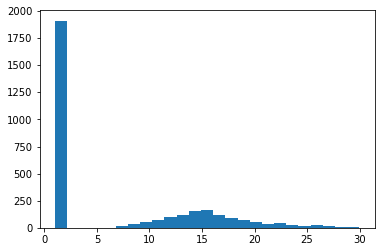

In [135]:
plt.hist(modl2.data['cer']['data'], bins=25)

In [122]:
from er3t.pre.abs import abs_16g, abs_oco_idl
from scipy.io import readsav

date   = datetime.datetime(int(cfg_info['date'][:4]),    # year
                               int(cfg_info['date'][4:6]),   # month
                               int(cfg_info['date'][6:])     # day
                              )
name_tag = '%s_%s' % (cfg_info['cfg_name'], date.strftime('%Y%m%d'))
fname_idl = 'data/atm_abs_%s_11.out' % 'o2a'
f = readsav(fname_idl)
wvls = f.lamx*1000.0
fdir = '.'#os.path.abspath('tmp-data/%s/%s' % (name_tag, band_tag))
levels    = np.array([ 0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5,  5. , 5.5,  6. ,  6.5,  7. ,  7.5,  8. ,  8.5,  9. ,  9.5, 10. , 11. , 12. , 13. , 14. , 20. , 25. , 30. , 35. , 40. ])
fname_atm = '%s/atm.pk' % fdir
atm0      = atm_atmmod(levels=levels, fname=fname_atm, overwrite=False)

#wavelength = wvls[0]
#fname_abs = '%s/abs.pk' % fdir
#abs0      = abs_oco_idl(wavelength=wavelength, fname=fname_abs, fname_idl=fname_idl, atm_obj=atm0, overwrite=False)


In [123]:
f

{'atm_zgrd': array([    0.,   500.,  1000.,  1500.,  2000.,  2500.,  3000.,  3500.,
         4000.,  4500.,  5000.,  5500.,  6000.,  6500.,  7000.,  7500.,
         8000.,  8500.,  9000.,  9500., 10000., 11000., 12000., 13000.,
        14000., 20000., 25000., 30000., 35000., 40000.], dtype=float32),
 'lay': array([ 0.25,  0.75,  1.25,  1.75,  2.25,  2.75,  3.25,  3.75,  4.25,
         4.75,  5.25,  5.75,  6.25,  6.75,  7.25,  7.75,  8.25,  8.75,
         9.25,  9.75, 10.5 , 11.5 , 12.5 , 13.5 , 17.  , 22.5 , 27.5 ,
        32.5 , 37.5 ], dtype=float32),
 'atm_p': array([949.22064  , 897.3639   , 847.506    , 799.48755  , 753.84143  ,
        710.1363   , 668.6007   , 629.2137   , 591.57916  , 556.3659   ,
        522.6924   , 490.61737  , 460.17993  , 431.32104  , 403.75327  ,
        377.94434  , 353.2583   , 329.6842   , 307.7647   , 286.61548  ,
        257.25     , 221.5692   , 189.61374  , 161.508    ,  89.7443   ,
         36.78776  ,  17.023926 ,   7.5105677,   0.       ], dtype

In [85]:
abs0.coef

{'wvl': {'name': 'Wavelength', 'data': 760.75385, 'units': 'nm'},
 'abso_coef': {'name': 'Absorption Coefficient (Nz, Ng)',
  'data': array([[5.6025457e-01, 5.9481561e-01, 6.3302189e-01, ..., 1.7271616e-01,
          1.7966650e-01, 1.8465970e-01],
         [5.5792242e-01, 5.9226960e-01, 6.3023323e-01, ..., 1.7088684e-01,
          1.7735100e-01, 1.8195280e-01],
         [4.7690290e-01, 5.0633878e-01, 5.3888792e-01, ..., 1.5158591e-01,
          1.5961713e-01, 1.6584264e-01],
         ...,
         [3.2764525e-04, 3.4769860e-04, 3.6988661e-04, ..., 2.0159029e-04,
          7.8100956e-04, 3.3226053e-03],
         [6.9606307e-05, 7.3865645e-05, 7.8578298e-05, ..., 5.1700870e-05,
          2.9503470e-04, 1.4615797e-03],
         [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
          0.0000000e+00, 0.0000000e+00]], dtype=float32)},
 'slit_func': {'name': 'Slit Function (Nz, Ng)',
  'data': array([[0.08404526, 0.09067583, 0.09905501, ..., 0.10061692, 0.09223927,
        

In [175]:
abs0.Ng


126

In [24]:
import h5py
f_met = h5py.File('data/oco/oco2_L2MetND_05176a_150622_B10003r_191113232812.h5', 'r')
f_l1b = h5py.File('data/oco/oco2_L1bScND_05176a_150622_B10003r_191113232757.h5', 'r')
f_l2 = h5py.File('data/oco/oco2_L2StdND_05176a_150622_B10206r_200723181441.h5', 'r')

In [25]:
f_met.keys()

<KeysViewHDF5 ['Aerosol', 'Dimensions', 'FootprintGeometry', 'FootprintMeteorology', 'Metadata', 'Meteorology', 'MeteorologyDiagnostics', 'Shapes', 'SoundingGeometry']>

In [26]:
f_met['Aerosol']['aod_total_met']

<HDF5 dataset "aod_total_met": shape (8373, 8), type "<f4">

In [84]:
f_met['SoundingGeometry']['sounding_id'][...]

array([[2018100408470931, 2018100408470932, 2018100408470933, ...,
        2018100408470936, 2018100408470937, 2018100408470938],
       [2018100408470971, 2018100408470972, 2018100408470973, ...,
        2018100408470976, 2018100408470977, 2018100408470978],
       [2018100408471001, 2018100408471002, 2018100408471003, ...,
        2018100408471006, 2018100408471007, 2018100408471008],
       ...,
       [2018100409332931, 2018100409332932, 2018100409332933, ...,
        2018100409332936, 2018100409332937, 2018100409332938],
       [2018100409332971, 2018100409332972, 2018100409332973, ...,
        2018100409332976, 2018100409332977, 2018100409332978],
       [2018100409333001, 2018100409333002, 2018100409333003, ...,
        2018100409333006, 2018100409333007, 2018100409333008]])

In [145]:
f_met['Metadata']['CompositeAerosolTypes'][...]

array([b'DU', b'SS', b'BC', b'OC', b'SO'], dtype='|S3')

In [143]:
f_met['Aerosol']['composite_aod_sort_index_met'][0,0,:]

array([3, 4, 1, 2, 0], dtype=int8)

In [107]:
aod_list = []
DU_frac, SS_frac, BC_frac, OC_frac, SO_frac = ([] for _ in range(5))
com_frac = f_met['Aerosol']['composite_aod_fraction_met']
for snd in o1.snd.flatten():
    #print(snd)
    position = np.where(f_met['SoundingGeometry']['sounding_id'][...]==snd)
    aod_list.append(f_met['Aerosol']['aod_total_met'][position[0][0], position[1][0]])
    
    DU_frac.append(com_frac[position[0][0], position[1][0], 0])
    SS_frac.append(com_frac[position[0][0], position[1][0], 1])
    BC_frac.append(com_frac[position[0][0], position[1][0], 2])
    OC_frac.append(com_frac[position[0][0], position[1][0], 3])
    SO_frac.append(com_frac[position[0][0], position[1][0], 4])

In [28]:
print(np.mean(DU_frac),np.mean(SS_frac),np.mean(BC_frac),np.mean(OC_frac),np.mean(SO_frac))

0.15296385 0.12715328 0.11151324 0.47133535 0.13703427


In [169]:
sza = f_met['SoundingGeometry/sounding_solar_zenith'][...]

In [178]:
print(f_met['SoundingGeometry/sounding_solar_zenith'][position[0][0], position[1][0]])
print((f_met['FootprintGeometry/footprint_solar_zenith'][position[0][0], position[1][0]]).mean())

50.601017
50.601017


In [179]:
print(f_met['SoundingGeometry/sounding_solar_azimuth'][position[0][0], position[1][0]])
print(f_met['FootprintGeometry/footprint_solar_azimuth'][position[0][0], position[1][0]].mean())

204.9903
204.9903


In [69]:
print(f_met['FootprintGeometry/footprint_stokes_coefficients'][position[0][0], position[1][0]])


[[ 0.5        -0.44643247 -0.22516227  0.        ]
 [ 0.5        -0.4586472  -0.19910485  0.        ]
 [ 0.5        -0.46126735 -0.19295709  0.        ]]


In [183]:
print(f_met['SoundingGeometry/sounding_solar_relative_velocity'][position[0][0], position[1][0]])
print(f_met['SoundingGeometry/sounding_relative_velocity'][position[0][0], position[1][0]])


-378.60333
-26.943281


In [101]:
position = np.where(f_met['SoundingGeometry/sounding_id']==o1.snd[0,0])
position

(array([2864]), array([0]))

In [82]:
o1.snd[0,0]

2015062217225001

In [191]:

print(f_l1b['InstrumentHeader/ils_delta_lambda'][0,position[1][0],1000,:])
print(f_l1b['InstrumentHeader/ils_relative_response'][0,position[1][0],1000,:])

[-4.07211075e-04 -3.59860976e-04 -3.12510849e-04 -2.79365748e-04
 -2.46220647e-04 -2.22545568e-04 -1.98870504e-04 -1.79930488e-04
 -1.60990443e-04 -1.47969142e-04 -1.34947855e-04 -1.30212822e-04
 -1.25477833e-04 -1.20742821e-04 -1.16007810e-04 -1.11272799e-04
 -1.06537780e-04 -1.01802769e-04 -9.70677502e-05 -9.23327243e-05
 -8.75977348e-05 -8.52302328e-05 -8.28627162e-05 -8.04952215e-05
 -7.81277122e-05 -7.57602029e-05 -7.33926863e-05 -7.10251843e-05
 -6.86576750e-05 -6.62901803e-05 -6.39226637e-05 -6.15551617e-05
 -5.91876524e-05 -5.68201503e-05 -5.44526447e-05 -5.20851390e-05
 -4.97176261e-05 -4.73501168e-05 -4.49826221e-05 -4.26151164e-05
 -4.02476107e-05 -3.90638525e-05 -3.78801014e-05 -3.66963432e-05
 -3.55125921e-05 -3.43288411e-05 -3.31450901e-05 -3.19613318e-05
 -3.07775808e-05 -2.95938262e-05 -2.84100734e-05 -2.72263205e-05
 -2.60425695e-05 -2.54506922e-05 -2.48588130e-05 -2.42669375e-05
 -2.36750602e-05 -2.24913110e-05 -2.13075582e-05 -2.01238054e-05
 -1.89400507e-05 -1.77562

In [189]:
f_l1b['InstrumentHeader/ils_delta_lambda'].shape

(3, 8, 1016, 200)

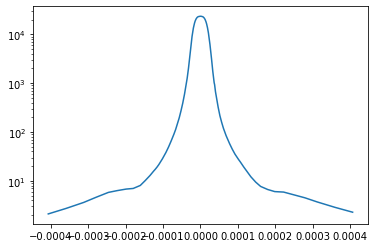

In [29]:
plt.plot(f_l1b['InstrumentHeader/ils_delta_lambda'][0,position[1][0],1000,:],
         f_l1b['InstrumentHeader/ils_relative_response'][0,position[1][0],1000,:])
plt.yscale('log')

In [198]:
f_l1b['InstrumentHeader/dispersion_coef_samp'][0,7,:]

array([ 7.57616914e-01,  1.74890782e-05, -2.74278840e-09, -6.13509101e-14,
        1.21137131e-16, -6.95426874e-20])

In [30]:
def fff(coeffs, col):
    result = 0
    for i in range(len(coeffs)):
        result += coeffs[i]*(col**i)
    return result

In [204]:
fff(f_l1b['InstrumentHeader/dispersion_coef_samp'][0,0,:], 0)

0.7576464843765492

In [205]:
fff(f_l1b['InstrumentHeader/dispersion_coef_samp'][0,7,:], 0)

0.7576169141237433

In [207]:
(fff(f_l1b['InstrumentHeader/dispersion_coef_samp'][0,0,:], 0)-fff(f_l1b['InstrumentHeader/dispersion_coef_samp'][0,7,:], 0))*1000

0.029570252805921626

In [228]:
o1.wvl.shape

(117, 8, 1016)

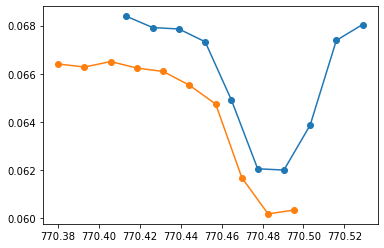

In [31]:
plt.plot(o1.wvl[10,0,840:850], o1.l1b[10,0,840:850], 'o-')
plt.plot(o1.wvl[10,7,840:850], o1.l1b[10,7,840:850], 'o-')

In [247]:
print(o1.wvl[10,0,840:850][4])
print(o1.wvl[10,7,840:850][1])


770.4648948453772
770.3930120951067


IndexError: index 100 is out of bounds for axis 0 with size 32

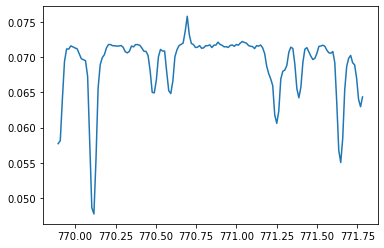

In [32]:
plt.plot(o1.wvl[5,0,800:950], o1.l1b[5,0,800:950])
plt.plot(o1.wvl[100,0,800:950], o1.l1b[100,0,800:950])

In [227]:
for i in range(100+1, 120+1):
    print(fff(f_l1b['InstrumentHeader/dispersion_coef_samp'][0,0,:], i)*1000)

759.3852755069712
759.4022110038985
759.4191409975156
759.4360654876508
759.4529844741354
759.4698979568021
759.4868059354865
759.5037084100262
759.5206053802607
759.5374968460325
759.5543828071857
759.5712632635668
759.5881382150247
759.6050076614101
759.6218716025763
759.6387300383784
759.6555829686739
759.6724303933224
759.6892723121855
759.7061087251275


In [213]:
o1.wvl[0,0,100:120]

array([759.38527551, 759.402211  , 759.419141  , 759.43606549,
       759.45298447, 759.46989796, 759.48680594, 759.50370841,
       759.52060538, 759.53749685, 759.55438281, 759.57126326,
       759.58813822, 759.60500766, 759.6218716 , 759.63873004,
       759.65558297, 759.67243039, 759.68927231, 759.70610873])

In [225]:
o1.wvl[1,0,100:120]

array([759.38527551, 759.402211  , 759.419141  , 759.43606549,
       759.45298447, 759.46989796, 759.48680594, 759.50370841,
       759.52060538, 759.53749685, 759.55438281, 759.57126326,
       759.58813822, 759.60500766, 759.6218716 , 759.63873004,
       759.65558297, 759.67243039, 759.68927231, 759.70610873])

In [224]:
chan = np.arange(100, 120)
wvl_o2_a       = np.zeros((8, 20), dtype=np.float64)
for i in [0]:
    for j in range(6):
        wvl_o2_a[i, :] += (f_l1b['InstrumentHeader/dispersion_coef_samp'][0, i, j]*chan**j)*1000
wvl_o2_a[0]

array([759.36833451, 759.38527551, 759.402211  , 759.419141  ,
       759.43606549, 759.45298447, 759.46989796, 759.48680594,
       759.50370841, 759.52060538, 759.53749685, 759.55438281,
       759.57126326, 759.58813822, 759.60500766, 759.6218716 ,
       759.63873004, 759.65558297, 759.67243039, 759.68927231])

In [102]:
png       = ['../simulation/data/20150622_107_168_20150622/aqua_rgb_2015-06-22_-57.85--57.39-1.07-1.68.png',
             [-57.85, -57.39, 1.07, 1.68]]
img = png[0]
wesn= png[1]

In [28]:
import xarray as xr
litefile = '../dat/oco2_LtCO2_150622_B10206Ar_200730184707s.nc4'
lite = xr.open_dataset(litefile)
lon_w, lon_e = wesn[0], wesn[1]
lat_s, lat_n = np.array(boundary_list)[-1, 0][2], np.array(boundary_list)[0, 0][3]
lon_range = np.logical_and(lite.longitude >= lon_w, lite.longitude <= lon_e)
lat_range = np.logical_and(lite.latitude >= lat_s, lite.latitude <= lat_n)

select = np.where(np.logical_and(lon_range, lat_range))

lite_snd_list = np.array(lite.sounding_id[select], dtype=np.int)


/var/folders/7r/hs2l3pt92m92by1jz_x3d97400b9nz/T/ipykernel_61352/1126471944.py:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  lat_s, lat_n = np.array(boundary_list)[-1, 0][2], np.array(boundary_list)[0, 0][3]
/var/folders/7r/hs2l3pt92m92by1jz_x3d97400b9nz/T/ipykernel_61352/1126471944.py:11: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#depre

In [29]:
qf_array = np.zeros((o1.snd.shape[0], o1.snd.shape[1], 3))
cld_array = np.zeros((o1.snd.shape[0], o1.snd.shape[1], 4))
qf_lon, qf_lat = np.zeros((o1.snd.shape[0], o1.snd.shape[1])), np.zeros((o1.snd.shape[0], o1.snd.shape[1]))
# qf, qf_bitflag, qf_simpleflag\
for i in range(o1.snd.shape[0]):
    for j in range(o1.snd.shape[1]):
        snd = o1.snd[i, j]
        #print('-'*15)
        #print(snd)
        if snd in lite_snd_list:
            index = np.where(lite_snd_list == snd)[0][0]
            xco2_quality_flag = np.float(lite.xco2_quality_flag[select][index])
            xco2_qf_bitflag = np.float(lite.xco2_qf_bitflag[select][index])
            xco2_qf_simple_bitflag = np.float(lite.xco2_qf_simple_bitflag[select][index])
            qf_array[i, j, :] = (xco2_quality_flag, xco2_qf_bitflag, xco2_qf_simple_bitflag)
            qf_lat[i, j] = np.float(lite.latitude[select][index])
            qf_lon[i, j] = np.float(lite.longitude[select][index])
        else:
            qf_array[i, j, :] = (np.nan,)*3
            qf_lat[i, j] = np.nan
            qf_lon[i, j] = np.nan
        """
        if snd in cloud.sounding_id:
            index = np.where(cloud.sounding_id == snd)[0][0]
            cld_dist = np.float(cloud.cld_dist[index])
            h3d = np.float(cloud.h3d[index])
            cs_noise_ratio = np.float(cloud.cs_noise_ratio[index])
            hc = np.float(cloud.hc[index])
            cld_array[i, j, :] = (cld_dist, h3d, cs_noise_ratio, hc)
        else:
            cld_array[i, j, :] = (np.nan,)*4
        """

(176,) (22, 8)


NameError: name 'aod_list' is not defined

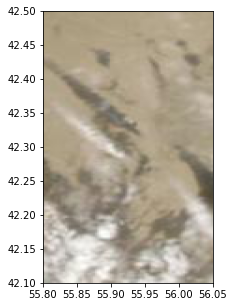

In [30]:
f,frame=plt.subplots(figsize=(5, 5))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)
cc = frame.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              s=20,
              marker='o', c=np.array(aod_list)[mask], cmap='OrRd')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)
cbar.set_label('AOD', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

Text(0, 0.5, 'Counts')

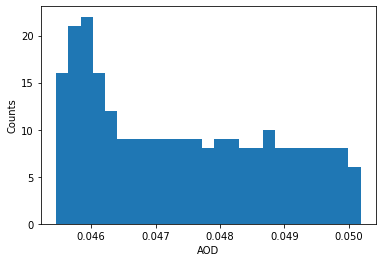

In [109]:
plt.hist(aod_list, bins=25)
plt.xlabel('AOD')
plt.ylabel('Counts')

(936,) (117, 8)


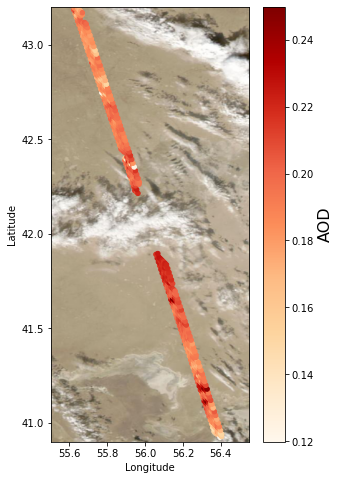

In [151]:
f,frame=plt.subplots(figsize=(5, 8))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)
cc = frame.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              s=20,
              marker='o', c=(o1.c3d[:,:,10].flatten()*np.exp(1-np.array(aod_list)))[mask], cmap='OrRd')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)
cbar.set_label('AOD', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

In [269]:
o1.toa

array([1.28019607, 1.27348137, 1.23966956, 1.185691  , 1.27547956,
       1.27576172, 1.27581286, 1.26461554, 1.25066602, 1.25246906,
       1.14508224])

In [291]:
f_l2['L1bScSpectralParameters/rad_continuum_o2'][6280]*6.626e-34*3e8/(o1.wvl[0,0,:].mean()*1e-9)

52.698806836786936

In [290]:
o1.wvl[0,0,:].mean()

765.5940219484235

In [292]:
f_l2['L1bScSpectralParameters/rad_mean_spectra_o2'][6280]*6.626e-34*3e8/(o1.wvl[0,0,:].mean()*1e-9)

32.39086042311242

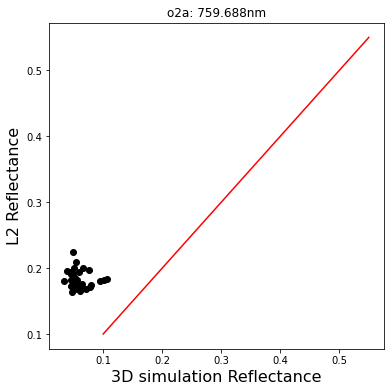

In [114]:
plt.figure(figsize=(6,6))
lam_ind = 0
for i in range(o1.c3d.shape[0]):
    plt.scatter(o1.c3d[i, :,lam_ind].mean()/o1.toa[lam_ind]*np.pi,
                f_l2['BRDFResults/brdf_reflectance_o2'][2273+i],
                color='k')
plt.plot([0.1, 0.55], [0.1, 0.55], color='r')
plt.xlabel('3D simulation Reflectance', fontsize=16)
plt.ylabel('L2 Reflectance', fontsize=16)
plt.title(f'o2a: {o1.lam[lam_ind]:.3f}nm')
plt.show()

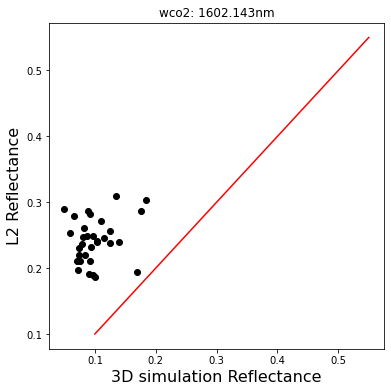

In [115]:
plt.figure(figsize=(6,6))
lam_ind = 0
for i in range(o1.c3d.shape[0]):
    plt.scatter(o2.c3d[i, :,lam_ind].mean()/o2.toa[lam_ind]*np.pi,
                f_l2['BRDFResults/brdf_reflectance_weak_co2'][2273+i],
                color='k')
plt.plot([0.1, 0.55], [0.1, 0.55], color='r')
plt.xlabel('3D simulation Reflectance', fontsize=16)
plt.ylabel('L2 Reflectance', fontsize=16)
plt.title(f'wco2: {o2.lam[lam_ind]:.3f}nm')
plt.show()

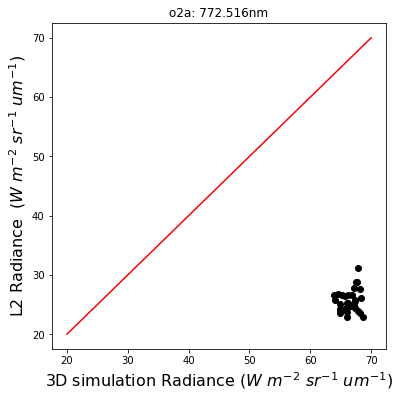

In [61]:
plt.figure(figsize=(6,6))
lam_ind = 10
for i in range(o1.c3d.shape[0]):
    plt.scatter(o1.rad[i, :,lam_ind].mean()*1000,
                f_l2['L1bScSpectralParameters/rad_continuum_o2'][2273+i]*6.626e-34*3e8/760e-9,
                color='k')
plt.plot([20, 70], [20, 70], color='r')
plt.xlabel('3D simulation Radiance ($W$ $m^{-2}$ $sr^{-1}$ $um^{-1}$)', fontsize=16)
plt.ylabel('L2 Radiance  ($W$ $m^{-2}$ $sr^{-1}$ $um^{-1}$)', fontsize=16)
plt.title(f'o2a: {o1.lam[lam_ind]:.3f}nm')
plt.show()

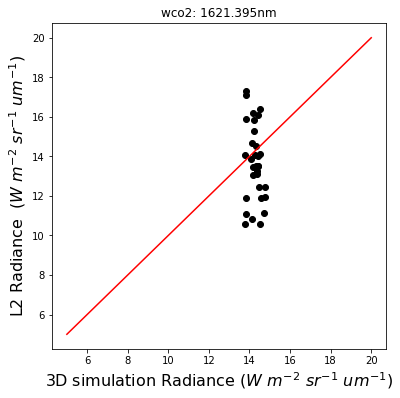

In [60]:
plt.figure(figsize=(6,6))
lam_ind = 10
for i in range(o1.c3d.shape[0]):
    plt.scatter(o2.rad[i, :,lam_ind].mean()*1000,
                f_l2['L1bScSpectralParameters/rad_continuum_weak_co2'][2273+i]*6.626e-34*3e8/760e-9,
                color='k')
plt.plot([5, 20], [5, 20], color='r')
plt.xlabel('3D simulation Radiance ($W$ $m^{-2}$ $sr^{-1}$ $um^{-1}$)', fontsize=16)
plt.ylabel('L2 Radiance  ($W$ $m^{-2}$ $sr^{-1}$ $um^{-1}$)', fontsize=16)
plt.title(f'wco2: {o2.lam[lam_ind]:.3f}nm')
plt.show()

In [47]:
plt.figure(figsize=(6,6))
lam_ind = 5
for i in range(o1.c3d.shape[0]):
    plt.scatter(o3.c3d[i, :,lam_ind].mean()/o3.toa[lam_ind]*np.pi,
                f_l2['BRDFResults/brdf_reflectance_strong_co2'][2273+i],
                color='k')
plt.plot([0.1, 0.55], [0.1, 0.55], color='r')
plt.xlabel('3D simulation Reflectance', fontsize=16)
plt.ylabel('L2 Reflectance', fontsize=16)
plt.title(f'sco2: {o3.lam[lam_ind]:.3f}nm')
plt.show()

NameError: name 'o3' is not defined

<Figure size 432x432 with 0 Axes>

In [303]:
f_l2['BRDFResults/brdf_reflectance_apriori_o2'][6280]#[6280]*6.626e-34*3e8/(o1.wvl[0,0,:].mean()*1e-9)


0.4003303

In [293]:
50e6*6.626e-34*3e8/(o1.wvl[0,0,:].mean()*1e-9)

1.2982076289866291e-11

In [306]:
np.where(f_l2['L1bScSoundingReference/sounding_id_l1b']==o1.snd[-1,-1])


(array([6366]), array([7]))

In [278]:
f_l2['PreprocessingResults/albedo_o2_abp'][6280,0]


0.39921418

In [280]:
f_l2['AerosolResults/aerosol_total_aod'][6280]

0.14778623

23 23 23
23 23 23
23 23 23


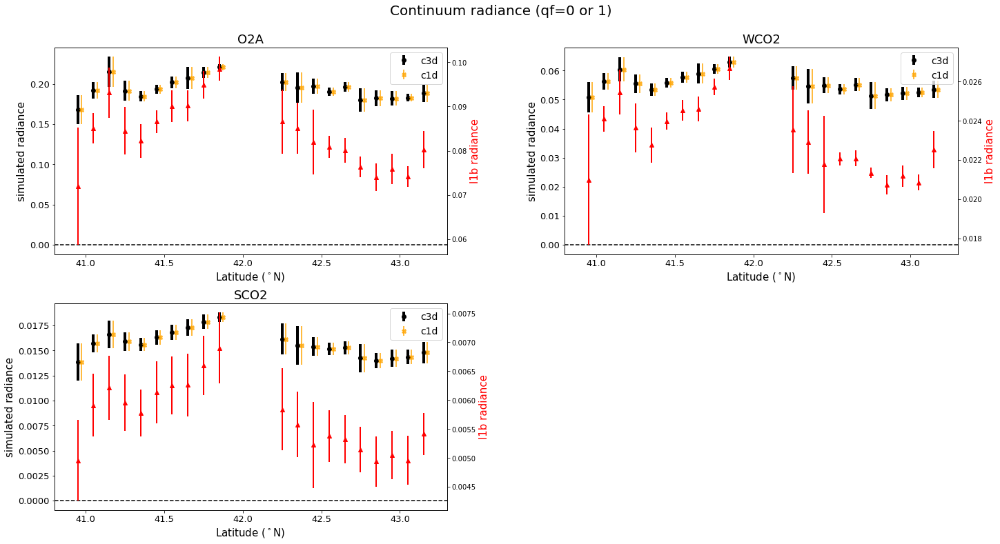

In [166]:
fig, ((ax11, ax21), (ax31, ax41)) = plt.subplots(2, 2, figsize=(20, 11), sharex=False)
fig.tight_layout(pad=5.0)
fig.patch.set_facecolor('white')
plt.subplots_adjust(wspace=0.3)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax21, ax31]
title_size = 18
label_size = 15
tick_size = 13
cloud_label = ['Latitude ($^\circ$)', 'Latitude ($^\circ$)']
xy_list = [('r', 'g'), ('r', 'b'), ('r', 'r/g'), ('r', 'r/b')]
qf0 = qf_array[:, :, 0]==0
qf1 = qf_array[:, :, 0]==1
OCO_class_list = [o1, o2, o3]
#ax11.scatter(cld_array[:, :, 0][qf0], o1.slope_1km[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='1 km points (qf=0)')
#ax21.scatter(cld_array[:, :, 0][qf0], o2.slope_1km[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='s25 points (qf=0)')


for i in range(3):
    ax = ax_list[i]
    ax2 = ax.twinx()
    var_o = OCO_class_list[i]
    
    lon_list = var_o.lon[:, :].flatten()
    select_index = np.ones_like(lon_list)#sort_remove_duplicate(lon_list)
    select_index[...] = True
    select_index = np.array(select_index, dtype=np.bool_)
    lon_select = var_o.lon[:, :].flatten()[select_index]
    lat_select = var_o.lat[:, :].flatten()[select_index]
    qf_select = qf_array[:, :, 0].flatten()[select_index]
    cloud_select = cld_array[:, :, 0].flatten()[select_index]
    y1 = (var_o.c3d[:,:,10].flatten()*np.exp(1-np.array(aod_list)))[select_index]
    y3 = (var_o.c3d[:,:,10].flatten()*np.exp(1-np.array(aod_list)))[select_index]
    if i == 0:
        y2 = var_o.l1b[:, :, 1010].flatten()[select_index]  
    elif i == 1:
        y2 = var_o.l1b[:, :, 1001].flatten()[select_index]
    elif i == 2:
        y2 = var_o.l1b[:, :, 1000].flatten()[select_index]
    df = pd.DataFrame(np.array([lon_select, lat_select, qf_select, cloud_select, y1, y2, y3]).T, 
                      columns=['lon', 'lat', 'qf', 'cloud_dis', 'c3d', 'l1b', 'c1d'])
    #df[np.logical_or(df.slope_1km < -1, df.slope_1km >1)] = np.nan
    
    mask = np.logical_or(df.qf==0, df.qf==1)
    # plot figure
    lat_range = np.linspace(40.9, 43.2, int((43.2-40.9)/0.1+1))
    x = np.mean(np.array([lat_range[:-1], lat_range[1:]]), axis=0)
    y = np.array(df[mask].groupby(pd.cut(df[mask]['lat'], lat_range)).mean()['c3d'])
    y_err = np.array(df[mask].groupby(pd.cut(df[mask]['lat'], lat_range)).std()['c3d'])
    y2 = np.array(df[mask].groupby(pd.cut(df[mask]['lat'], lat_range)).mean()['c1d'])
    y2_err = np.array(df[mask].groupby(pd.cut(df[mask]['lat'], lat_range)).std()['c1d'])
    cld = np.array(df[mask].groupby(pd.cut(df[mask]['lat'], lat_range)).mean()['l1b'])
    cld_err = np.array(df[mask].groupby(pd.cut(df[mask]['lat'], lat_range)).std()['l1b'])
    #x[np.logical_or(np.logical_or(y<-1, y>1), x>10)] = np.nan
    #y[np.logical_or(np.logical_or(y<-1, y>1), x>10)] = np.nan
    mask = ~np.isnan(x) & ~np.isnan(y)
    """
    #ax.plot(x_array, x_array, 'r', label='ideal')
    slope, intercept, r_value, p_value, std_err = stats.linregress(x[mask], y[mask])
    print(r_value**2)
    #ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
    
    res=np.polyfit(x[mask], y[mask],1,w=None,cov=True) # now get covariance as well!
    slope,intercept=res[0]
    slopes=np.sqrt(res[1][0][0])
    intercepts=np.sqrt(res[1][1][1])
    print(slope,intercept)
    mn = np.nanmin(x[mask])
    mx = np.nanmax(x[mask])
    xx=np.linspace(mn,mx,11)
    yy=intercept+slope*xx
    y1=intercept+intercepts+(slope+slopes)*xx
    y2=intercept-intercepts+(slope-slopes)*xx
    #"""
    """
    ax.plot(xx,yy,'r-',linewidth=2)  
    ax.plot(xx,y1,'r:',linewidth=1)  
    ax.plot(xx,y2,'r:',linewidth=1)  
    
    ax.text((xmin+(xmax-xmin)*0.45), (ymin+(ymax-ymin)*0.1),
            f'offset: {intercept:.3f}$\pm${intercepts:.3f}, slope: {slope:.3f}$\pm${slopes:.3f}', fontsize=14)
    #"""
    print(len(x), len(y), len(y2))
    ax2.errorbar(x, cld, yerr=cld_err, fmt='^', color='r', linewidth=2)
    ax.errorbar(x, y, yerr=y_err, fmt='o', color='k', markersize=6, linewidth=4, label='c3d')
    ax.errorbar(x+0.025, y2, yerr=y2_err, fmt='X', color='orange', markersize=6, linewidth=2, label='c1d', alpha=0.75)
    
    ax.set_xlabel('Latitude ($^\circ$N)', fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)
    
    ymin, ymax = 0, 0.15
    xmin, xmax = 40.8, 43.3
    ax.plot([xmin, xmax],[0,0],'k--')
    #ax.set_ylim(ymin, ymax)
    ax.set_xlim(xmin, xmax)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    #ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
    #        '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')
    ax.legend(fontsize=14)#, loc='center left',bbox_to_anchor=(1.05, -0.15))
    ax2.set_ylabel('l1b radiance', fontsize=label_size, color='r')
    ax.set_ylabel('simulated radiance', fontsize=label_size)

ax11.set_title('O2A', fontsize=title_size)
ax21.set_title('WCO2', fontsize=title_size)
ax31.set_title('SCO2', fontsize=title_size)
ax41.set_visible(False)
fig.suptitle(f'Continuum radiance (qf=0 or 1)', y=1.01, fontsize=title_size+2)
plt.show()

In [59]:
modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)

In [53]:
print(len(oco_alb_o2a), len(mod09_alb_band2))

756 756


In [8]:
lon_2d[:, 0]

array([55.50240826, 55.50722477, 55.51204128, 55.5168578 , 55.52167431,
       55.52649083, 55.53130734, 55.53612385, 55.54094037, 55.54575688,
       55.55057339, 55.55538991, 55.56020642, 55.56502294, 55.56983945,
       55.57465596, 55.57947248, 55.58428899, 55.5891055 , 55.59392202,
       55.59873853, 55.60355505, 55.60837156, 55.61318807, 55.61800459,
       55.6228211 , 55.62763761, 55.63245413, 55.63727064, 55.64208716,
       55.64690367, 55.65172018, 55.6565367 , 55.66135321, 55.66616972,
       55.67098624, 55.67580275, 55.68061927, 55.68543578, 55.69025229,
       55.69506881, 55.69988532, 55.70470183, 55.70951835, 55.71433486,
       55.71915138, 55.72396789, 55.7287844 , 55.73360092, 55.73841743,
       55.74323394, 55.74805046, 55.75286697, 55.75768349, 55.7625    ,
       55.76731651, 55.77213303, 55.77694954, 55.78176606, 55.78658257,
       55.79139908, 55.7962156 , 55.80103211, 55.80584862, 55.81066514,
       55.81548165, 55.82029817, 55.82511468, 55.82993119, 55.83

In [9]:
modl1b = modis_l1b(fnames=sat.fnames['mod_02'], extent=sat.extent, resolution=0.25)
print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][0]))
l1b_r_lon_2d, l1b_r_lat_2d, ref_r_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent, NxNy=(110*2, 148*2))
l1b_r_lon_2d, l1b_r_lat_2d, rad_r_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent, NxNy=(110*2, 148*2))
print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][1]))
l1b_nr_lon_2d, l1b_nr_lat_2d, ref_nr_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][1, ...], extent=sat.extent, NxNy=(110*2, 148*2))
l1b_nr_lon_2d, l1b_nr_lat_2d, rad_nr_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][1, ...], extent=sat.extent, NxNy=(110*2, 148*2))

rad_r_2d.shape

wavelength: 650.0nm
wavelength: 860.0nm


(220, 296)

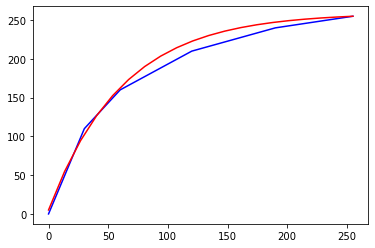

In [15]:
def func3(x, a, b):
    return (255/1+a*np.exp(-x/b))*(254/250)



plt.plot(x, y, 'b')
plt.plot(xx, func3(xx, -250, 61.78), 'r')

plt.show()

In [16]:
func3(xx, -255, 61.78)[0]

0.0

In [50]:
modl1b.data['wvl']['data']

array([650., 860.])

In [231]:
modl1b = modis_l1b(fnames=[sat.fnames['mod_02'][0]], extent=sat.extent, resolution=0.25)
print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][0]))
l1b_650_lon_2d, l1b_650_lat_2d, ref_650_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent, NxNy=(110*2, 148*2))
l1b_650_lon_2d, l1b_650_lat_2d, rad_650_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent, NxNy=(110*2, 148*2))
print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][1]))
l1b_860_lon_2d, l1b_860_lat_2d, ref_860_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][1, ...], extent=sat.extent, NxNy=(110*2, 148*2))
l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][1, ...], extent=sat.extent, NxNy=(110*2, 148*2))

rad_860_2d.shape

wavelength: 650.0nm
wavelength: 860.0nm


(220, 296)

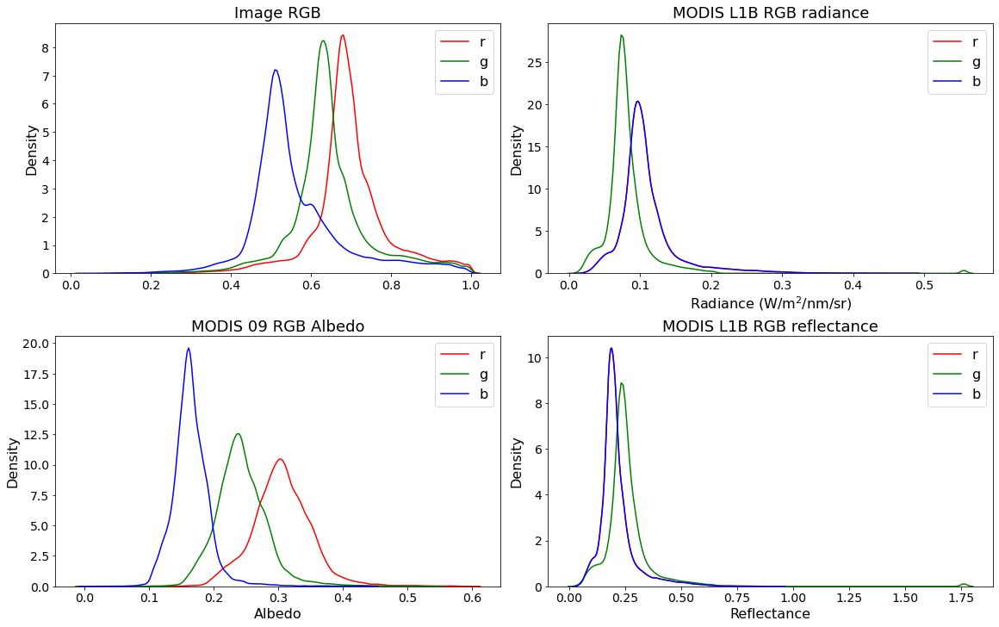

In [49]:
fig, ((ax11, ax12), (ax22, ax21)) = plt.subplots(2, 2, figsize=(16, 10), sharex=False, constrained_layout=True)
title_size= 18
label_size= 16
sns.kdeplot(img[:, :, 0].flatten(), ax=ax11, color='r', label='r')
sns.kdeplot(img[:, :, 1].flatten(), ax=ax11, color='g', label='g')
sns.kdeplot(img[:, :, 2].flatten(), ax=ax11, color='b', label='b')
ax11.set_title('Image RGB', fontsize=title_size)

sns.kdeplot(rad_r_2d.flatten(), ax=ax12, color='r', label='r')
sns.kdeplot(rad_g_2d.flatten(), ax=ax12, color='g', label='g')
sns.kdeplot(rad_b_2d.flatten(), ax=ax12, color='b', label='b')
ax12.set_title('MODIS L1B RGB radiance', fontsize=title_size)
ax12.set_xlabel('Radiance ($\mathrm{W/m^2/nm/sr}$)', fontsize=label_size)

sns.kdeplot(ref_r_2d.flatten(), ax=ax21, color='r', label='r')
sns.kdeplot(ref_g_2d.flatten(), ax=ax21, color='g', label='g')
sns.kdeplot(ref_b_2d.flatten(), ax=ax21, color='b', label='b')
ax21.set_title('MODIS L1B RGB reflectance', fontsize=title_size)
ax21.set_xlabel('Reflectance', fontsize=label_size)

sns.kdeplot(mod_sfc_alb_2d_band1.flatten(), ax=ax22, color='r', label='r')
sns.kdeplot(mod_sfc_alb_2d_band4.flatten(), ax=ax22, color='g', label='g')
sns.kdeplot(mod_sfc_alb_2d_band3.flatten(), ax=ax22, color='b', label='b')
ax22.set_title('MODIS 09 RGB Albedo', fontsize=title_size)
ax22.set_xlabel('Albedo', fontsize=label_size)

for ax in [ax11, ax12, ax22, ax21]:
    ax.tick_params(axis='x', labelsize=14)
    ax.tick_params(axis='y', labelsize=14)
    ax.set_ylabel('Density', fontsize=label_size)
    ax.legend(fontsize=16)
plt.show()

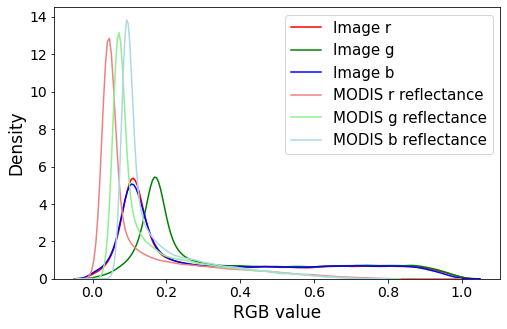

In [43]:
fig, ax11 = plt.subplots(1, 1, figsize=(8, 5), sharex=False)
sns.kdeplot(img[:, :, 0].flatten(), ax=ax11, color='r', label='Image r')
sns.kdeplot(img[:, :, 1].flatten(), ax=ax11, color='g', label='Image g')
sns.kdeplot(img[:, :, 2].flatten(), ax=ax11, color='b', label='Image b')


sns.kdeplot(ref_r_2d.flatten(), ax=ax11, color='lightcoral', label='MODIS r reflectance')
sns.kdeplot(ref_g_2d.flatten(), ax=ax11, color='lightgreen', label='MODIS g reflectance')
sns.kdeplot(ref_b_2d.flatten(), ax=ax11, color='lightblue', label='MODIS b reflectance')

ax11.tick_params(axis='x', labelsize=14)
ax11.tick_params(axis='y', labelsize=14)
ax11.set_ylabel('Density', fontsize=17)
ax11.set_xlabel('RGB value', fontsize=17)
ax11.legend(fontsize=15)
plt.show()

In [73]:
l1b_g_lon_2d[:, 0].shape

(110,)

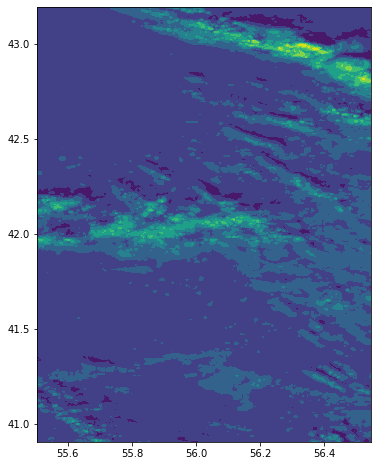

In [248]:
plt.figure(figsize=(6, 8))
plt.contourf(l1b_r_lon_2d, l1b_r_lat_2d, rad_r_2d)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


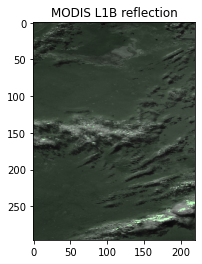

In [249]:
modl1b_ref_img = np.zeros((ref_r_2d.shape[1], ref_r_2d.shape[0], 3))
modl1b_ref_img[:, :, 0] = ref_r_2d.T
modl1b_ref_img[:, :, 1] = ref_g_2d.T
modl1b_ref_img[:, :, 2] = ref_b_2d.T
plt.imshow(modl1b_ref_img)
plt.title('MODIS L1B reflection')
plt.show()
plt.close()

In [250]:
def func4(x):
    return (255/1-250*np.exp(-((x/0.9)*255)/61.78))*(254/250)/255

modl1b_ref_img = np.zeros((ref_r_2d.shape[1], ref_r_2d.shape[0], 3))
modl1b_ref_img[:, :, 0] = func_r(ref_r_2d.T)[::-1, :]
modl1b_ref_img[:, :, 1] = func_g(ref_g_2d.T)[::-1, :]
modl1b_ref_img[:, :, 2] = func_b(ref_b_2d.T)[::-1, :]


plt.imshow(modl1b_ref_img)
plt.title('MODIS L1B conversion')
plt.show()
plt.close()
plt.imshow(img_reshape)
plt.title('Worldview regridded')
plt.show()
plt.close()

NameError: name 'func_r' is not defined

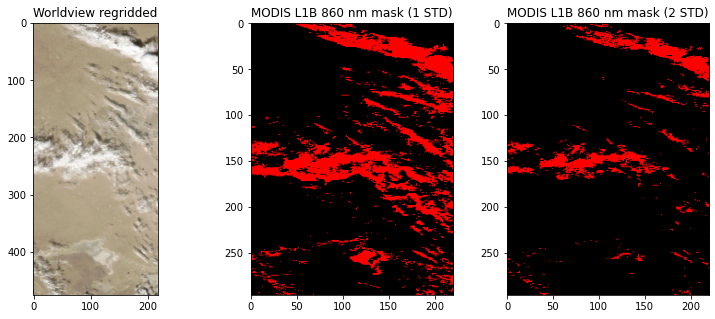

In [251]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(13, 5))

ax1.imshow(img_reshape)
ax1.set_title('Worldview regridded')

modl1b_ref_mask_img = np.zeros((ref_r_2d.shape[1], ref_r_2d.shape[0], 3))
nr_mask = ref_nr_2d.T[::-1, :] > 0.224+0.0705*1
modl1b_ref_mask_img[:, :, 0][nr_mask] = 1

ax2.imshow(modl1b_ref_mask_img)
ax2.set_title('MODIS L1B 860 nm mask (1 STD)')

modl1b_ref_mask_img = np.zeros((ref_r_2d.shape[1], ref_r_2d.shape[0], 3))
nr_mask = ref_nr_2d.T[::-1, :] > 0.224+0.0705*2
modl1b_ref_mask_img[:, :, 0][nr_mask] = 1
ax3.imshow(modl1b_ref_mask_img)
ax3.set_title('MODIS L1B 860 nm mask (2 STD)')

plt.show()
plt.close()

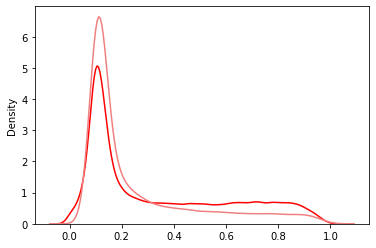

In [17]:
def func_r(x):
    return (255/1-250*np.exp(-((x/0.9)**1.25*255)/61.78))*(254/250)/255

def func_g(x):
    return (255/1-250*np.exp(-((x/0.9)**1.27*255)/61.78))*(254/250)/255

def func_b(x):
    return (255/1-250*np.exp(-(np.sin((x)*np.pi/2)**1.27/(1+np.exp(-10*(x-0.5)))**0.25*255)/91.78))*(270/250)/255

sns.kdeplot(img[:, :, 2].flatten(), color='r', label='Image r')
sns.kdeplot(func_b(ref_b_2d.T).flatten(), color='lightcoral', label='MODIS r')
plt.show()

In [24]:
func_b(xxxx).min()

0.021176470588235297

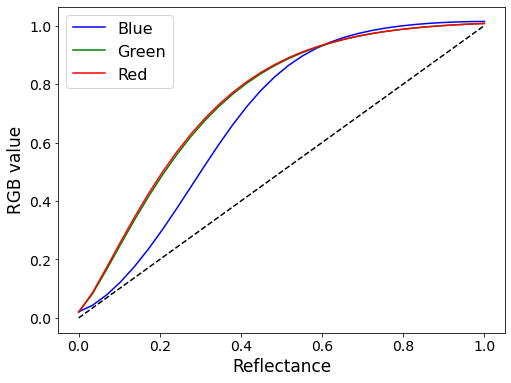

In [21]:
f, ax=plt.subplots(figsize=(8, 6))
xxxx = np.linspace(0, 1, 30)
ax.plot(xxxx, func_b(xxxx).flatten(), 'b', label='Blue')
ax.plot(xxxx, func_g(xxxx).flatten(), 'g', label='Green')
ax.plot(xxxx, func_r(xxxx).flatten(), 'r', label='Red')
ax.plot([0,1], [0,1], '--k')

#ax.set_xlim(1e-3, 1.2e1)
#frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
#frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#frame.scatter(o1.lon, o1.lat, s=20)
ax.legend(fontsize=16)
ax.tick_params(axis='x', labelsize=14)
ax.tick_params(axis='y', labelsize=14)
#ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: '{:g}'.format(x)))
#ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: '{:g}'.format(y)))
ax.set_ylabel('RGB value', fontsize=17)
ax.set_xlabel('Reflectance', fontsize=17)
#ax.set_title('dN/dr - r diagram', fontsize=20)
plt.show()

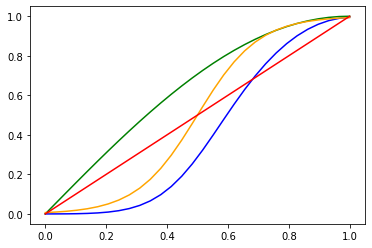

In [371]:

plt.show()

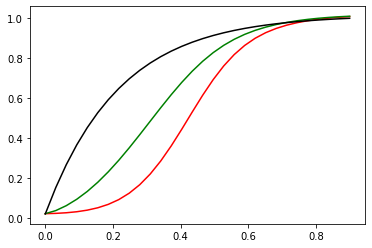

In [378]:
def func_b1(x):
    return (255/1-250*np.exp(-(np.sin((x)*np.pi/2)**1.27/(1+np.exp(-10*(x-0.5)))**0.3*255)/91.78))*(270/250)/255



xxx = np.linspace(0, 0.9, 30)
plt.plot(xxx, func_b(xxx), 'r')
plt.plot(xxx, func_b1(xxx), 'g')
plt.plot(xxx, func4(xxx), 'k')
plt.show()

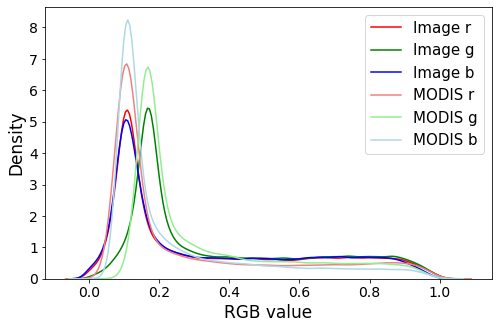

In [40]:
fig, ax11 = plt.subplots(1, 1, figsize=(8, 5), sharex=False)
sns.kdeplot(img[:, :, 0].flatten(), ax=ax11, color='r', label='Image r')
sns.kdeplot(img[:, :, 1].flatten(), ax=ax11, color='g', label='Image g')
sns.kdeplot(img[:, :, 2].flatten(), ax=ax11, color='b', label='Image b')


sns.kdeplot(func_r(ref_r_2d.T).flatten(), ax=ax11, color='lightcoral', label='MODIS r')
sns.kdeplot(func_g(ref_g_2d.T).flatten(), ax=ax11, color='lightgreen', label='MODIS g')
sns.kdeplot(func_b(ref_b_2d.T).flatten(), ax=ax11, color='lightblue', label='MODIS b')
ax11.tick_params(axis='x', labelsize=14)
ax11.tick_params(axis='y', labelsize=14)
ax11.set_ylabel('Density', fontsize=17)
ax11.set_xlabel('RGB value', fontsize=17)
ax11.legend(fontsize=15)
plt.show()

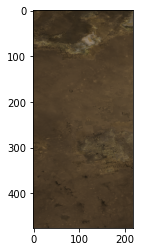

In [252]:
mod09_img = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
mod09_img[:, :, 0] = mod_sfc_alb_2d_band1.T
mod09_img[:, :, 1] = mod_sfc_alb_2d_band4.T
mod09_img[:, :, 2] = mod_sfc_alb_2d_band3.T
plt.imshow(mod09_img)

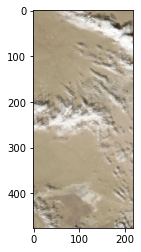

In [253]:
plt.imshow(img_reshape)

In [254]:
img = mpimg.imread(sat.fnames['mod_rgb'][0])
img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)

In [100]:
lon_2d[:, 0].shape

(110,)

In [89]:
mod_sfc_alb_2d_band1.shape

(110, 148)

In [ ]:
img[]

In [101]:
lat_interval = abs(lat_2d[0, 1]-lat_2d[0, 0])/2
lon_interval = abs(lon_2d[1, 0]-lon_2d[0, 0])/2
img_reshape = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
for i in range(len(lon_2d[:, 0])):
    for j in range(len(lat_2d[0, :])):
        index_lon2 = np.argmin(np.abs(img_lon-lon_2d[i, 0]-lon_interval))
        index_lon1 = np.argmin(np.abs(img_lon-lon_2d[i, 0]+lon_interval))
        index_lat2 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]-lat_interval))
        index_lat1 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]+lat_interval))
        img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:index_lon2+1, :3], axis=(0, 1))

In [106]:
img_reshape[:,:,0].T.shape

(110, 148)

In [105]:
mod_sfc_alb_2d_band1.shape

(110, 148)

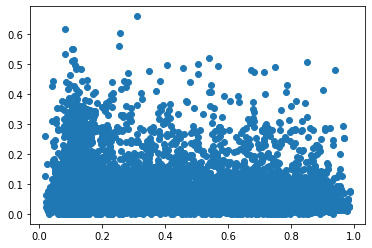

In [107]:
plt.scatter(img_reshape[:, :, 0].T.flatten(), mod_sfc_alb_2d_band1.flatten())
plt.show()

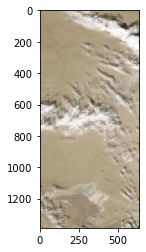

In [255]:
plt.imshow(img)

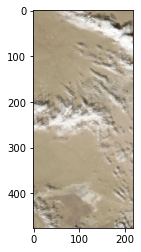

In [256]:
plt.imshow(img_reshape)

In [ ]:
index_lon = np.argmin(np.abs(OCO_class.lon2d[:, 0]-lon0))
                index_lat = np.argmin(np.abs(OCO_class.lat2d[0, :]-lat0))

In [ ]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)

    """
    fig = plt.figure(figsize=(5, 11))

    ax1 = fig.add_axes([0.05, 0.3, 0.9, 0.65])
    ax2 = fig.add_axes([0.05, 0.185, 0.9, 0.1])
    ax3 = fig.add_axes([0.05, 0.025, 0.9, 0.1])
    label_size = 14

    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    ax1.imshow(img,extent=sat.extent)
    lon_dom = sat.extent[:2]
    lat_dom = sat.extent[2:]
    ax1.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax1.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax1.set_xlabel('Longitude', fontsize=label_size)
    ax1.set_ylabel('Latitude', fontsize=label_size)

    sns.histplot(rgb_array[['r', 'g', 'b']], kde=True, fill=False, ax=ax2)
    ax2.set_xlabel('Scale', fontsize=label_size)
    ax2.set_ylabel('Counts', fontsize=label_size)
    ax2.set_xlim(0, 1)

    sns.histplot(mod_sfc_alb_2d_band1.flatten(), kde=True, fill=False, ax=ax3, label='band 1:620-670nm')
    sns.histplot(mod_sfc_alb_2d_band2.flatten(), kde=True, fill=False, ax=ax3, label='band 2:841-876nm')
    ax3.set_xlabel('Mod09', fontsize=label_size)
    ax3.set_ylabel('Counts', fontsize=label_size)
    ax3.legend()
    ax3.set_xlim(0, 1)
    plt.show()
    """

20150622_163_225
O2A band duration: 6.86887489993953e-07  h


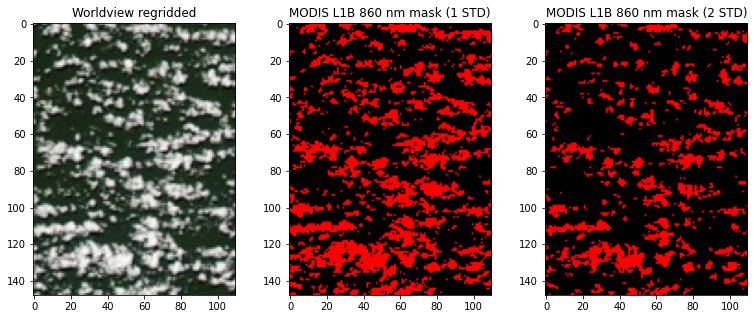

20150622_107_168
O2A band duration: 4.087597092924019e-07  h


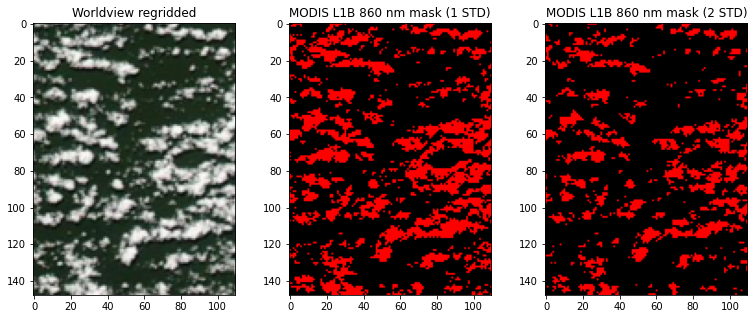

20150622_50_112
O2A band duration: 4.0559195137272277e-07  h


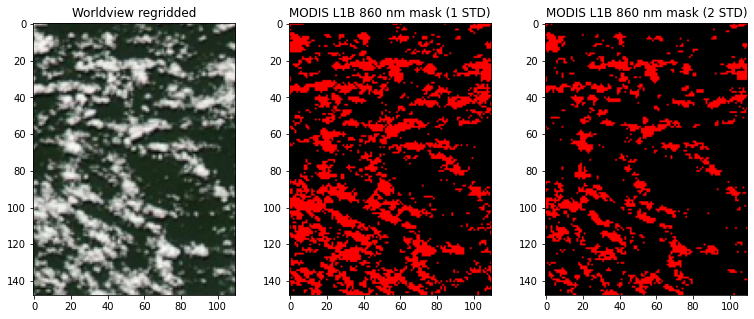

20150622_-7_55
O2A band duration: 5.225789047674173e-07  h


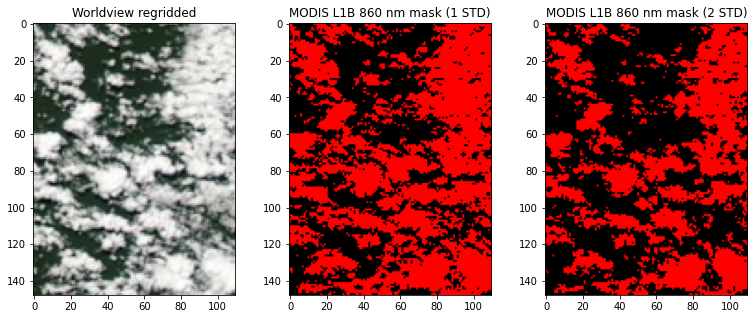

20150622_-63_-2
O2A band duration: 5.047133244160149e-07  h


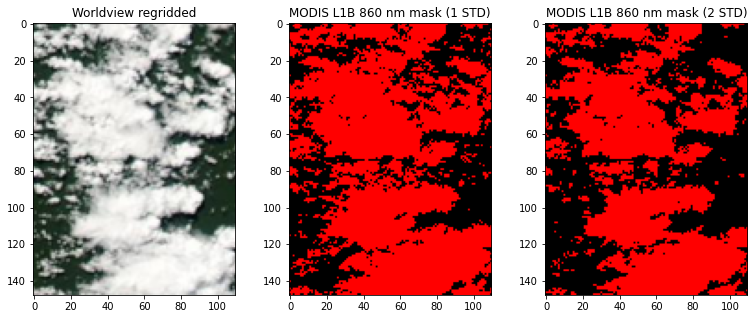

20150622_-120_-58
O2A band duration: 4.689594627254539e-07  h


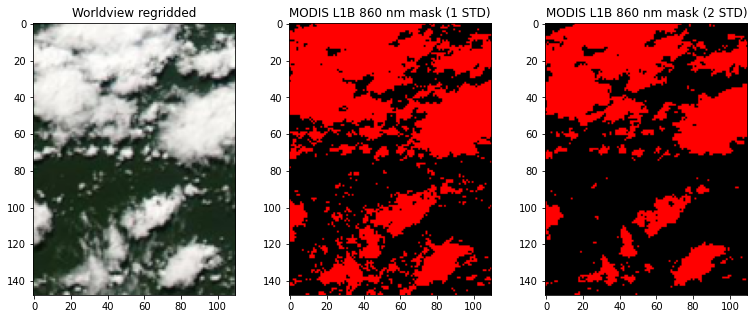

20150622_-177_-115
O2A band duration: 3.954758479570349e-07  h


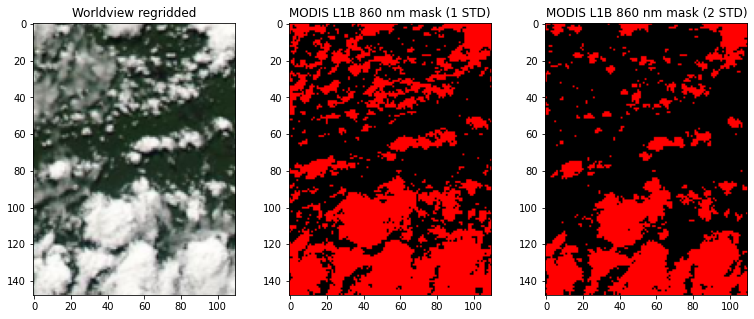

20150622_-233_-172
O2A band duration: 2.6330028453634847e-07  h


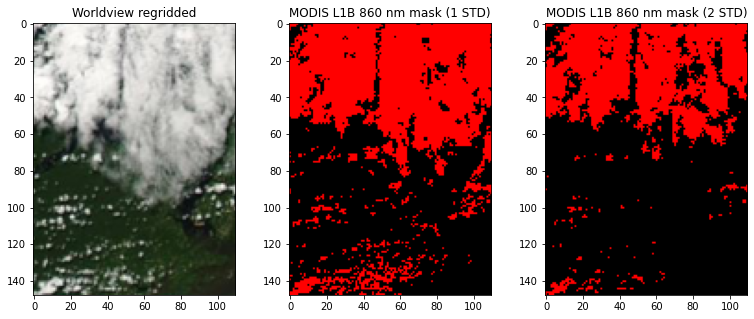

20150622_-290_-228
O2A band duration: 4.054350170513822e-07  h


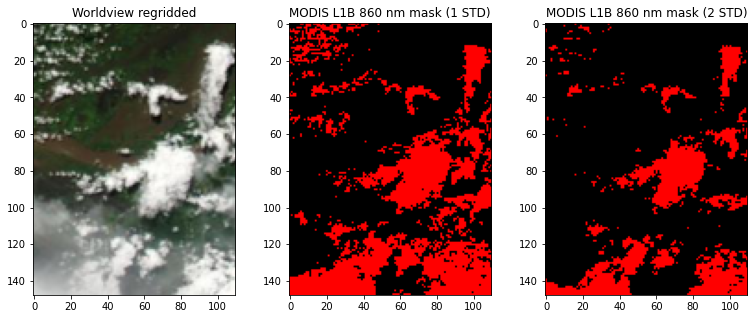

20150622_-347_-285
O2A band duration: 4.178713748438491e-07  h


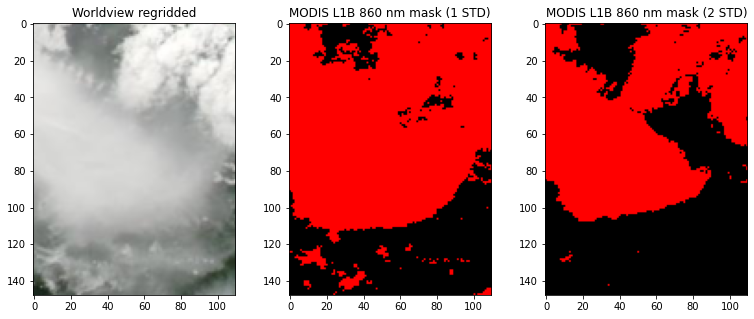

20150622_-403_-342
O2A band duration: 3.825177878348364e-07  h


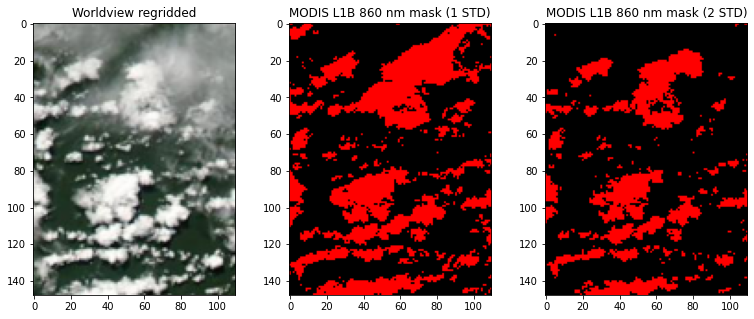

20150622_-460_-398
O2A band duration: 4.1137585261215766e-07  h


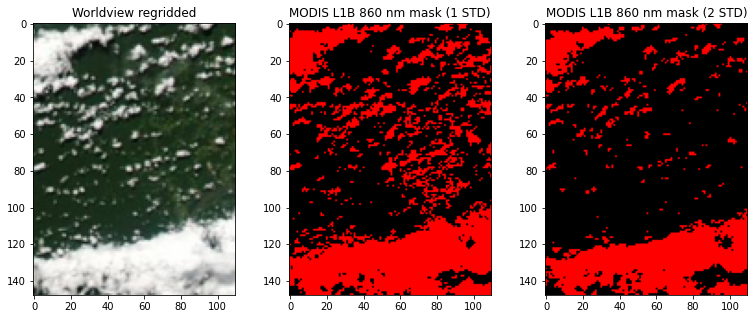

20150622_-517_-455
O2A band duration: 3.576936109715866e-07  h


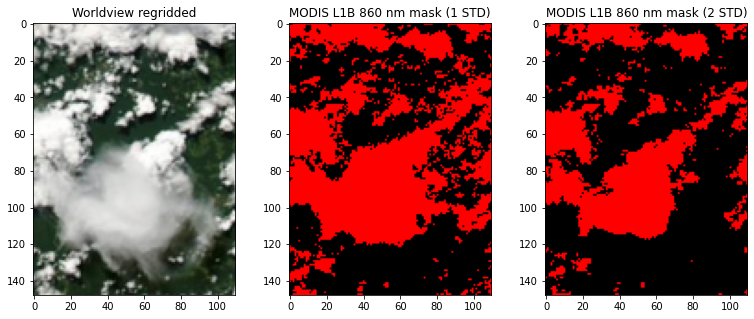

20150622_-573_-512
O2A band duration: 4.309686159508096e-07  h


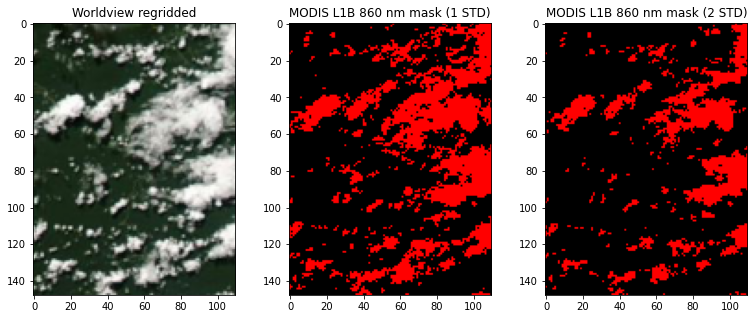

20150622_-630_-568
O2A band duration: 3.794886288233101e-07  h


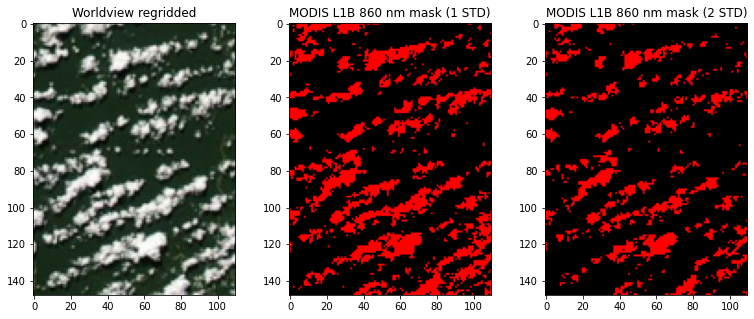

20150622_-687_-625
O2A band duration: 5.079038803362184e-07  h


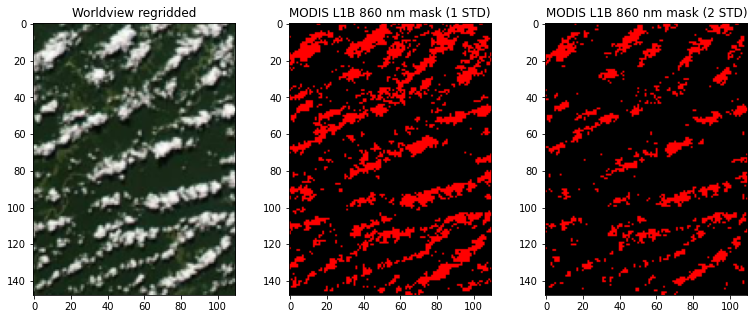

20150622_-743_-682
O2A band duration: 5.474166634182136e-07  h


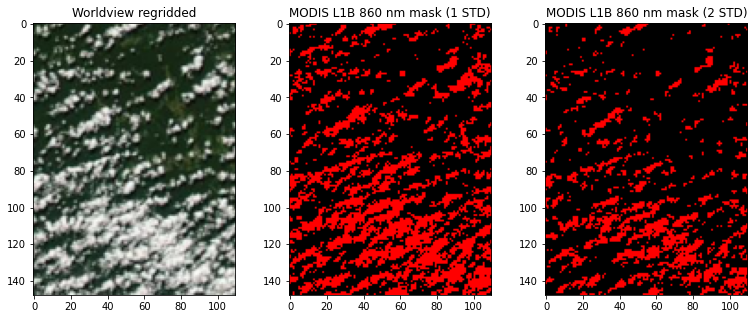

20150622_-800_-738
O2A band duration: 3.8708637778957684e-07  h


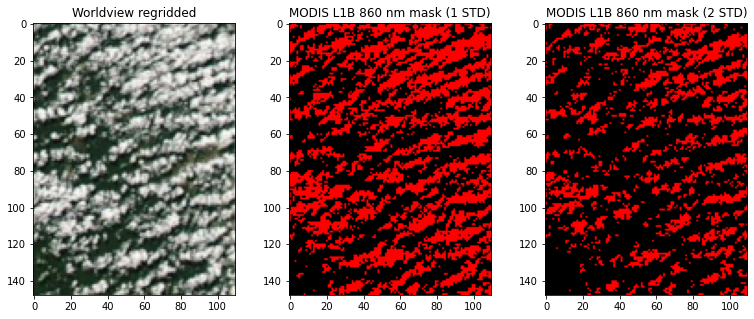

20150622_-857_-795
O2A band duration: 4.5429556242500744e-07  h


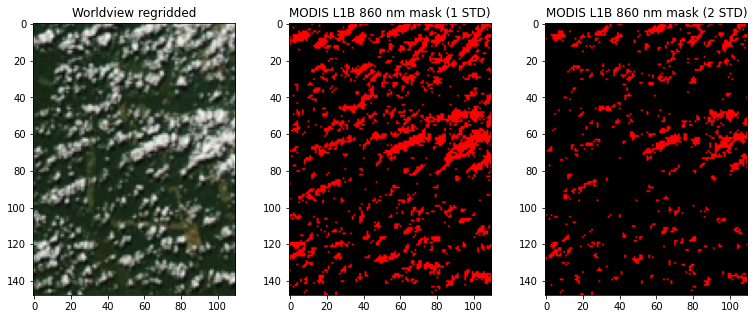

20150622_-913_-852
O2A band duration: 8.294097238427235e-07  h


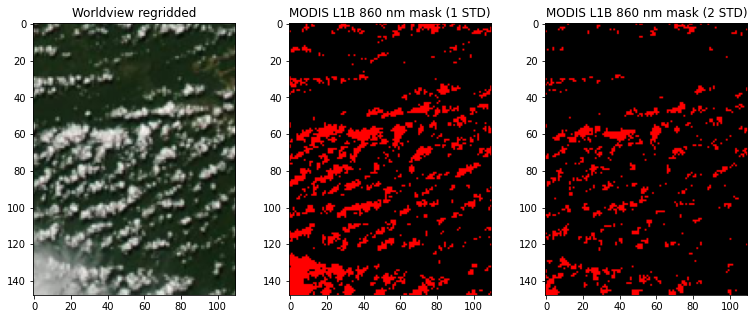

20150622_-970_-908
O2A band duration: 6.564133218489587e-07  h


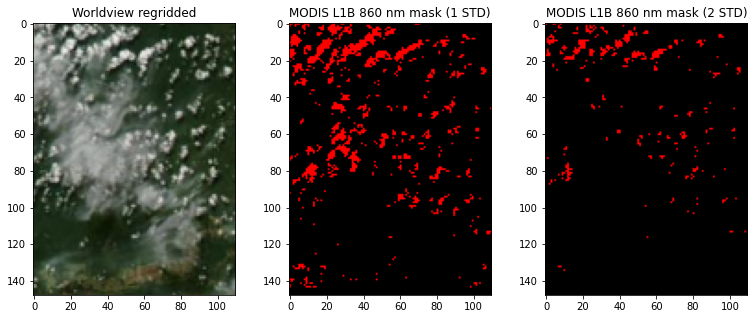

20150622_-1027_-965
O2A band duration: 4.1982750796402496e-07  h


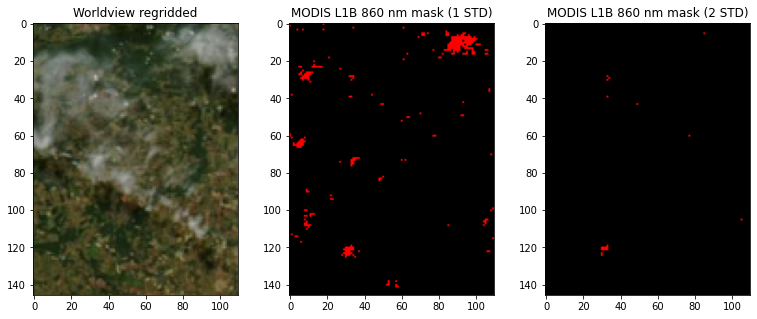

20150622_-1083_-1022
O2A band duration: 4.551672221471866e-07  h


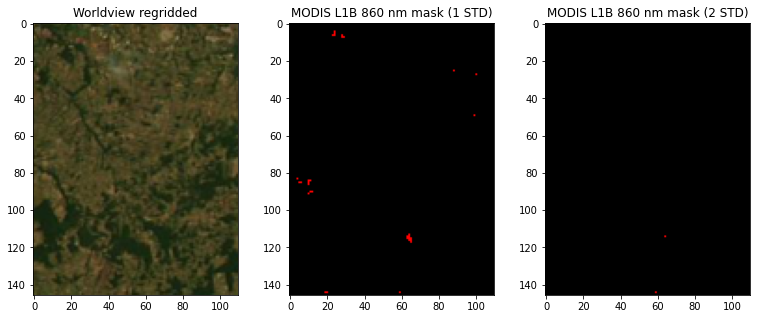

20150622_-1140_-1078
O2A band duration: 3.346949880425301e-07  h


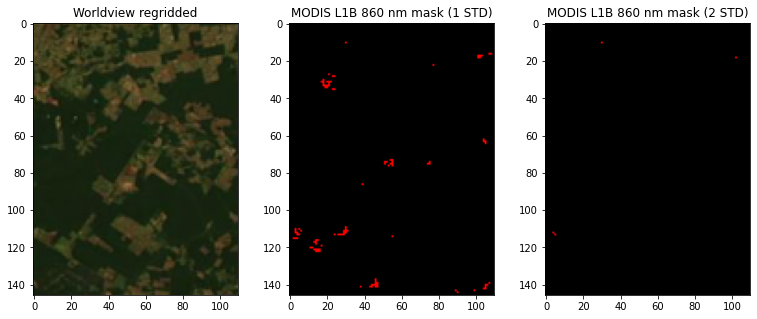

20150622_-1197_-1135
O2A band duration: 4.3808278860524296e-07  h


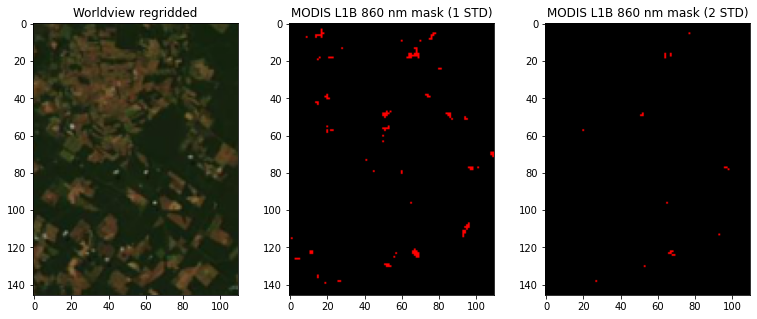

20150622_-1253_-1192
O2A band duration: 5.400691750562854e-07  h


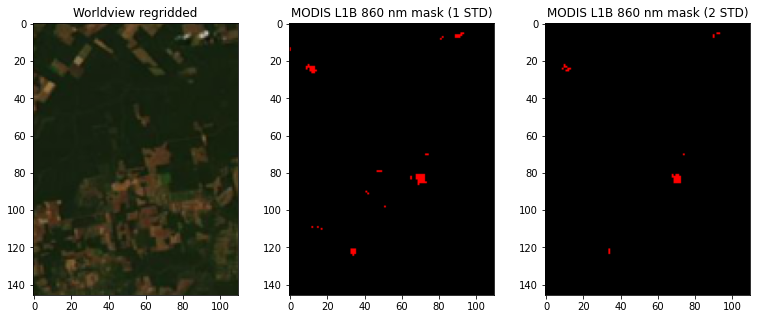

20150622_-1310_-1248
O2A band duration: 4.3332415063762e-07  h


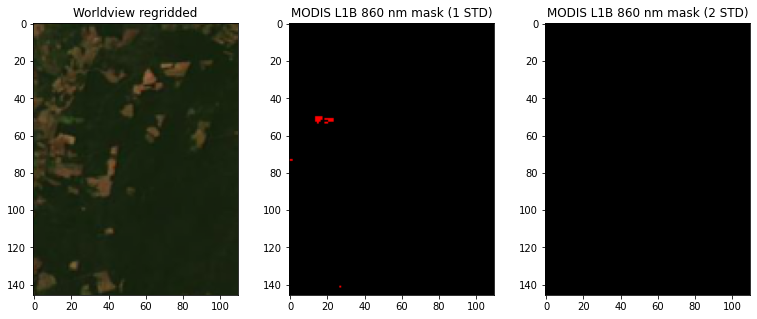

20150622_-1367_-1305
O2A band duration: 6.226586346100602e-07  h


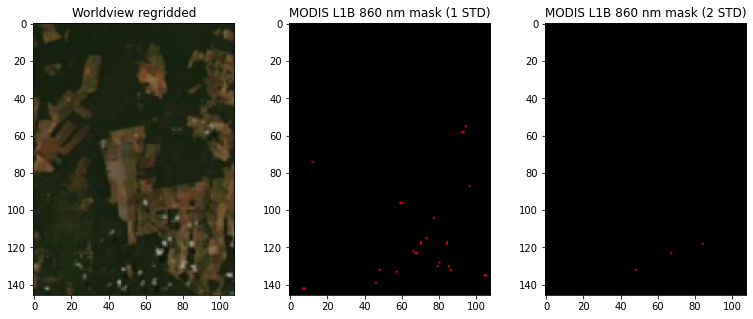

20150622_-1423_-1362
O2A band duration: 4.1257334588509464e-07  h


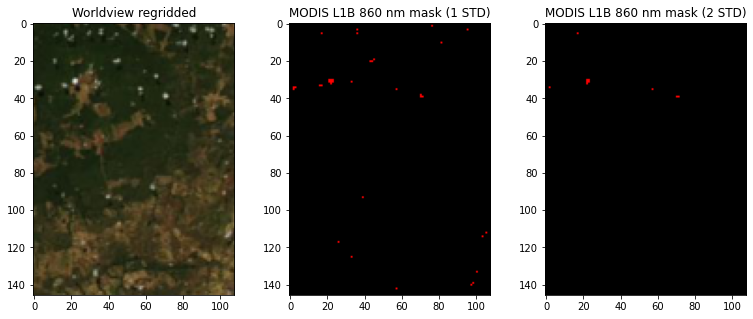

In [93]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
img_r, img_g, img_b = [], [], []
mod09_band1, mod09_band2, mod09_band3 = [], [], []
mod09_band4, mod09_band6, mod09_band7 = [], [], []
modl1b_ref_r, modl1b_rad_r = [], []
modl1b_ref_nr, modl1b_rad_nr = [], []
modl1b_ref_g, modl1b_rad_g = [], []
modl1b_ref_b, modl1b_rad_b = [], []
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][2, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][3, :], extent=sat.extent)
    #lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
    #                                                      mod.data['ref']['data'][5, :], extent=sat.extent)
    #lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
    #                                                      mod.data['ref']['data'][6, :], extent=sat.extent)
    modl1b = modis_l1b(fnames=sat.fnames['mod_02'], extent=sat.extent, resolution=0.25)
    #print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][0]))
    NxNy = mod_sfc_alb_2d_band1.shape
    l1b_r_lon_2d, l1b_r_lat_2d, ref_r_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent, NxNy=NxNy)
    l1b_r_lon_2d, l1b_r_lat_2d, rad_r_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent, NxNy=NxNy)
    #print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][1]))
    l1b_nr_lon_2d, l1b_nr_lat_2d, ref_nr_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][1, ...], extent=sat.extent, NxNy=NxNy)
    l1b_nr_lon_2d, l1b_nr_lat_2d, rad_nr_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][1, ...], extent=sat.extent, NxNy=NxNy)
    modl1b = modis_l1b(fnames=[sat.fnames['mod_02'][0].replace('QKM', 'HKM')], extent=sat.extent, resolution=0.5)
    #print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][0]))
    l1b_b_lon_2d, l1b_b_lat_2d, ref_b_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent, NxNy=NxNy)
    l1b_b_lon_2d, l1b_b_lat_2d, rad_b_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent, NxNy=NxNy)
    #print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][1]))
    l1b_g_lon_2d, l1b_g_lat_2d, ref_g_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][1, ...], extent=sat.extent, NxNy=NxNy)
    l1b_g_lon_2d, l1b_g_lat_2d, rad_g_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][1, ...], extent=sat.extent, NxNy=NxNy)


    
    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
    img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
    img_lon2d, img_lat2d = np.meshgrid(img_lon, img_lat)
        
    lat_interval = abs(lat_2d[0, 1]-lat_2d[0, 0])/2
    lon_interval = abs(lon_2d[1, 0]-lon_2d[0, 0])/2
    img_reshape = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
    for i in range(len(lon_2d[:, 0])):
        for j in range(len(lat_2d[0, :])):
            index_lon2 = np.argmin(np.abs(img_lon-lon_2d[i, 0]-lon_interval))
            index_lon1 = np.argmin(np.abs(img_lon-lon_2d[i, 0]+lon_interval))
            index_lat2 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]-lat_interval))
            index_lat1 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]+lat_interval))
            img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:index_lon2+1, :3], axis=(0, 1))
    img_r.extend(img_reshape[:, :, 0].T.flatten())
    img_g.extend(img_reshape[:, :, 1].T.flatten())
    img_b.extend(img_reshape[:, :, 2].T.flatten())
    
    mod09_band1.extend(mod_sfc_alb_2d_band1.flatten())
    mod09_band2.extend(mod_sfc_alb_2d_band2.flatten())
    mod09_band3.extend(mod_sfc_alb_2d_band3.flatten())
    mod09_band4.extend(mod_sfc_alb_2d_band4.flatten())
    #mod09_band6.extend(mod_sfc_alb_2d_band6.flatten())
    #mod09_band7.extend(mod_sfc_alb_2d_band7.flatten())
    
    modl1b_ref_r.extend(ref_r_2d.flatten())
    modl1b_rad_r.extend(rad_r_2d.flatten())
    modl1b_ref_nr.extend(ref_nr_2d.flatten())
    modl1b_rad_nr.extend(rad_nr_2d.flatten())
    modl1b_ref_g.extend(ref_g_2d.flatten())
    modl1b_rad_g.extend(rad_g_2d.flatten())
    modl1b_ref_b.extend(ref_b_2d.flatten())
    modl1b_rad_b.extend(rad_b_2d.flatten())
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(13, 5))
    ax1.imshow(img_reshape)
    ax1.set_title('Worldview regridded')
    modl1b_ref_mask_img = np.zeros((ref_r_2d.shape[1], ref_r_2d.shape[0], 3))
    nr_mask = ref_nr_2d.T[::-1, :] > 0.224+0.0705*1
    modl1b_ref_mask_img[:, :, 0][nr_mask] = 1
    ax2.imshow(modl1b_ref_mask_img)
    ax2.set_title('MODIS L1B 860 nm mask (1 STD)')
    modl1b_ref_mask_img = np.zeros((ref_r_2d.shape[1], ref_r_2d.shape[0], 3))
    nr_mask = ref_nr_2d.T[::-1, :] > 0.224+0.0705*2
    modl1b_ref_mask_img[:, :, 0][nr_mask] = 1
    ax3.imshow(modl1b_ref_mask_img)
    ax3.set_title('MODIS L1B 860 nm mask (2 STD)')
    plt.show()
    plt.close()

20150622_163_225
O2A band duration: 4.825716799435516e-07  h


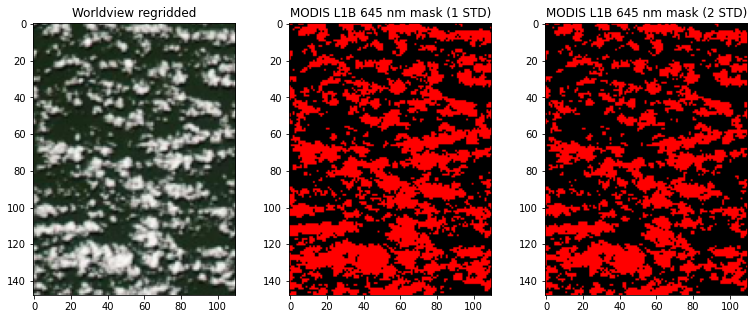

20150622_107_168
O2A band duration: 4.3053445147557393e-07  h


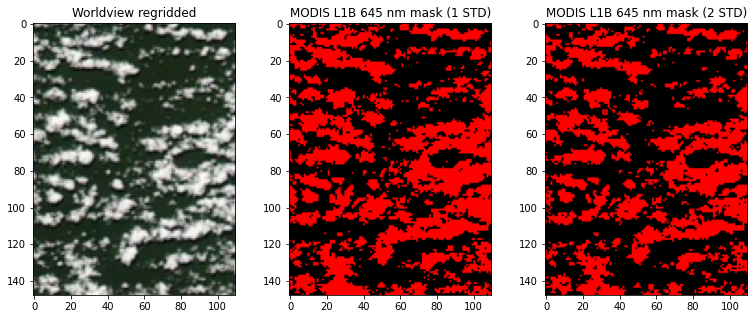

20150622_50_112
O2A band duration: 3.6862416891381144e-07  h


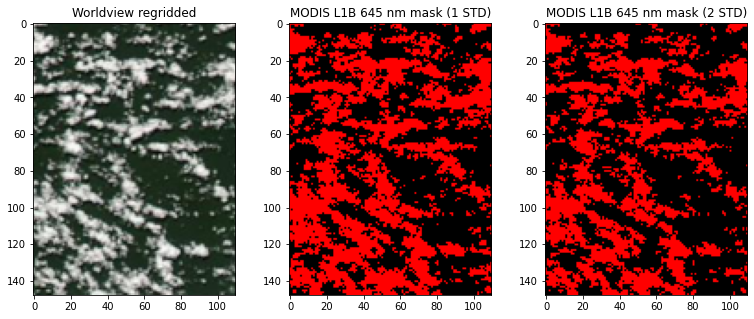

20150622_-7_55
O2A band duration: 4.7369472061594327e-07  h


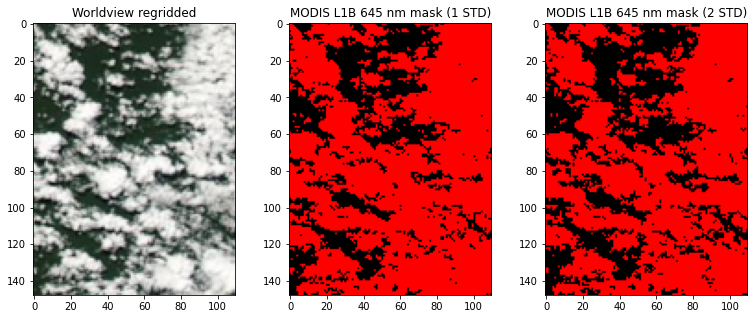

20150622_-63_-2
O2A band duration: 4.562141516038941e-07  h


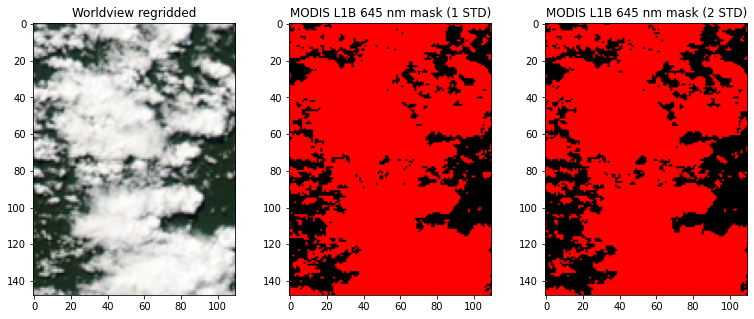

20150622_-120_-58
O2A band duration: 4.180885864318245e-07  h


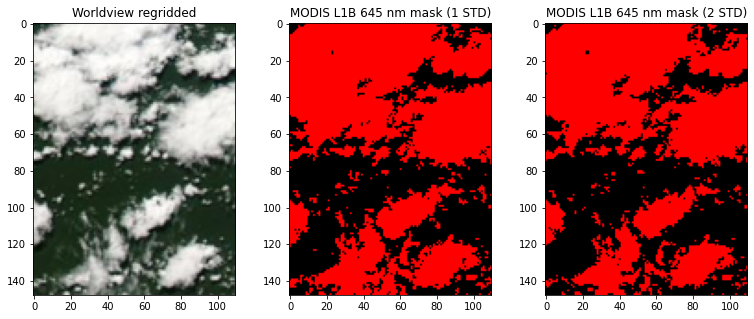

20150622_-177_-115
O2A band duration: 3.393572276561624e-07  h


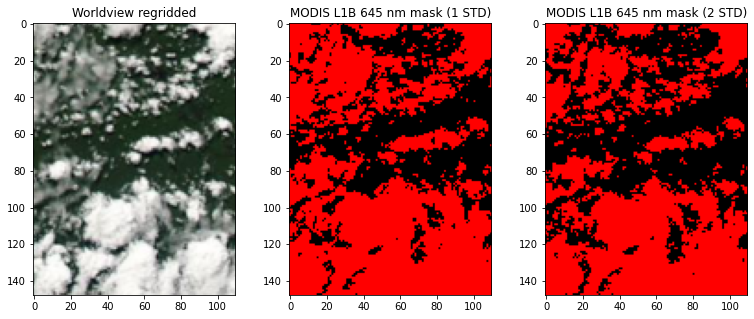

20150622_-233_-172
O2A band duration: 3.3512194123533037e-07  h


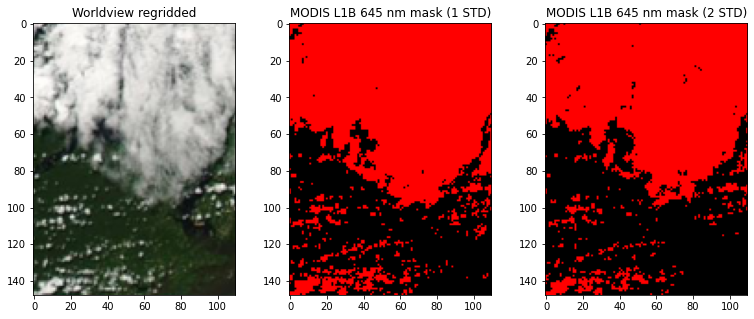

20150622_-290_-228
O2A band duration: 3.736213936160008e-07  h


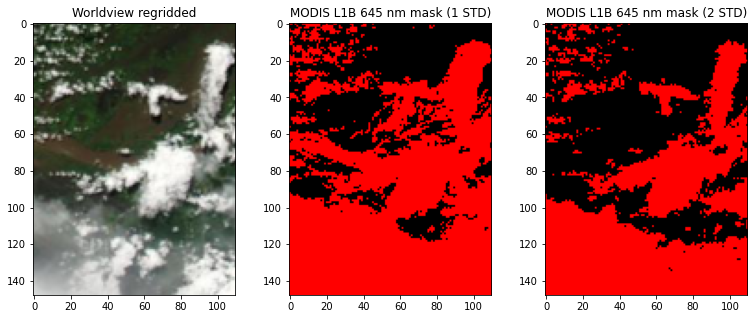

20150622_-347_-285
O2A band duration: 4.173186284282969e-07  h


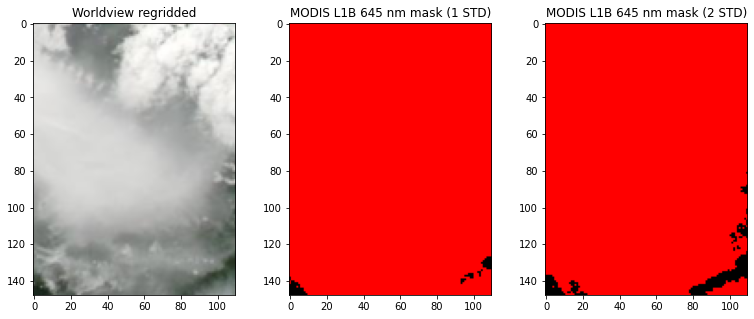

20150622_-403_-342
O2A band duration: 4.4173276465800076e-07  h


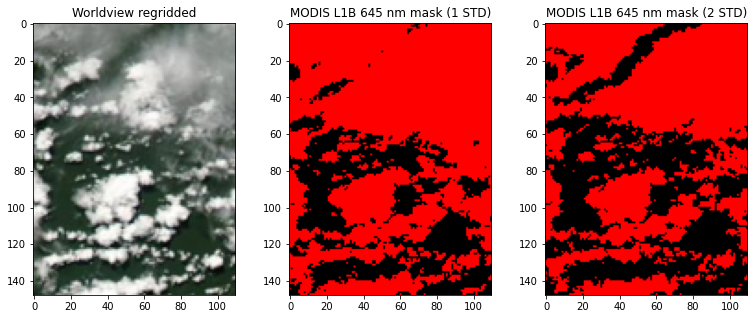

20150622_-460_-398
O2A band duration: 3.7820447081079084e-07  h


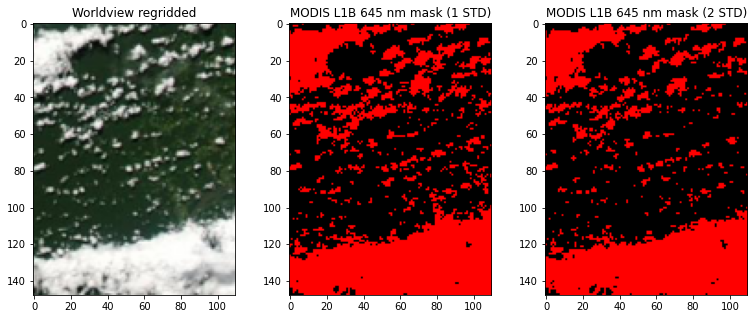

20150622_-517_-455
O2A band duration: 4.856019384331174e-07  h


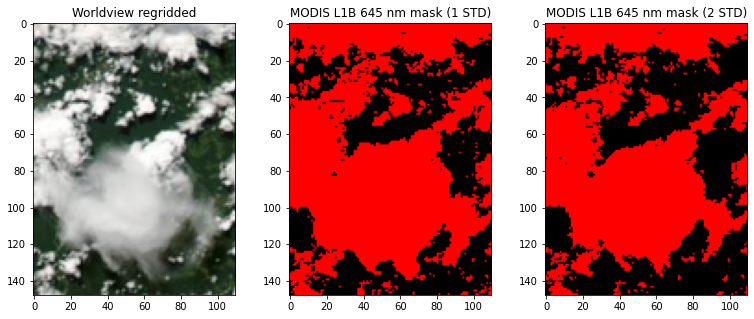

20150622_-573_-512
O2A band duration: 4.457444366481569e-07  h


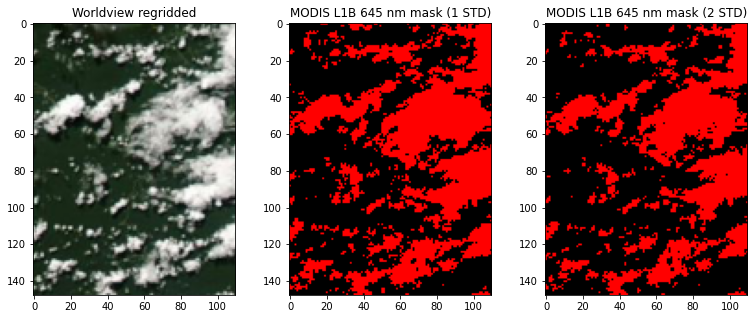

20150622_-630_-568
O2A band duration: 4.40326111856848e-07  h


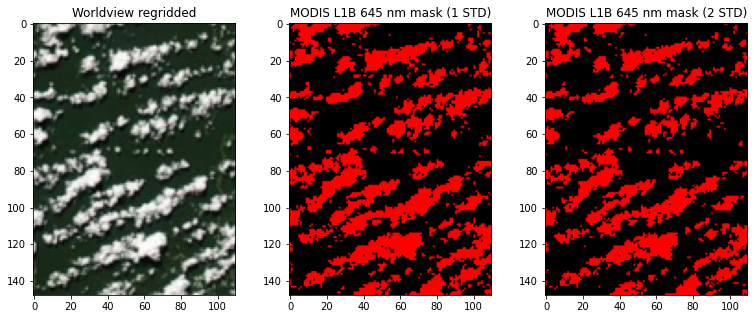

20150622_-687_-625
O2A band duration: 4.2629751583768264e-07  h


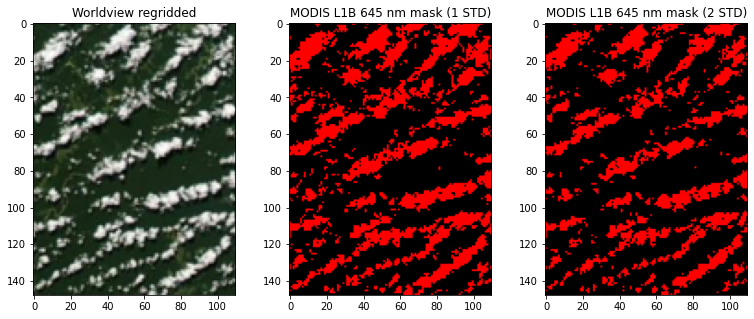

20150622_-743_-682
O2A band duration: 4.351516771647665e-07  h


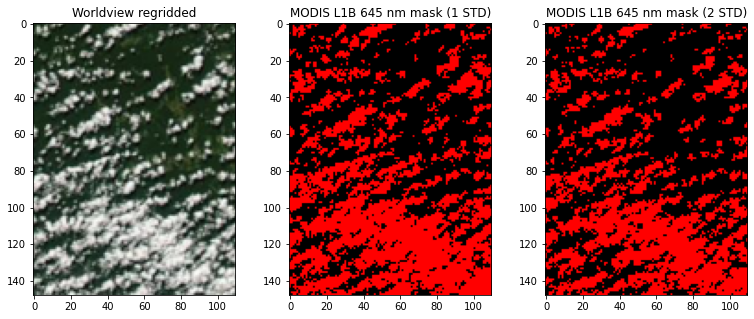

20150622_-800_-738
O2A band duration: 5.082669344523715e-07  h


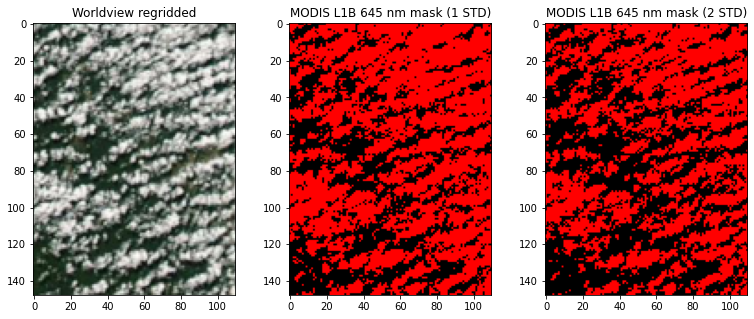

20150622_-857_-795
O2A band duration: 3.9961140525216857e-07  h


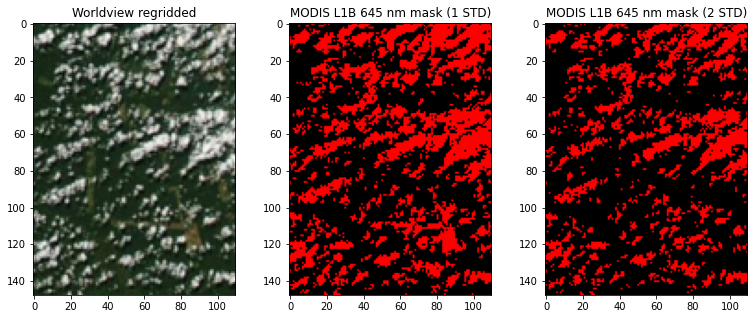

20150622_-913_-852
O2A band duration: 5.136627846190498e-07  h


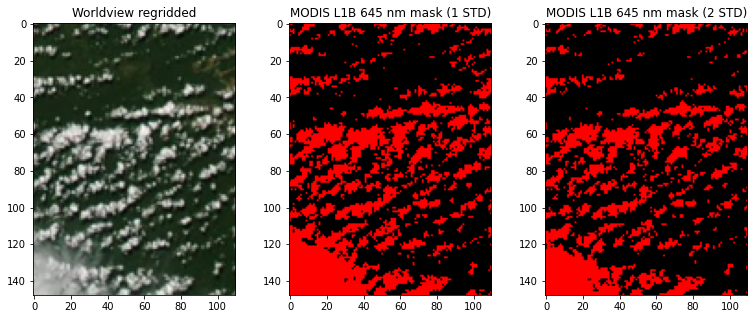

20150622_-970_-908
O2A band duration: 5.334152956493198e-07  h


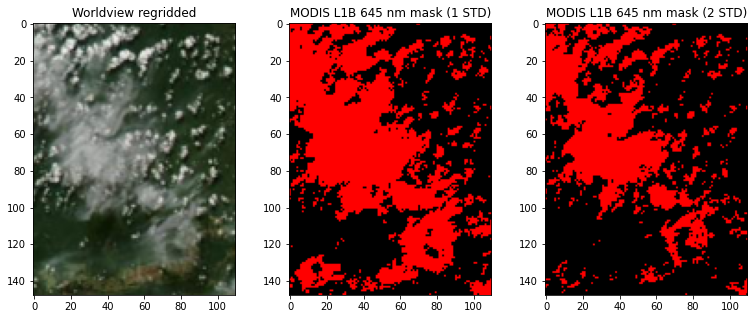

20150622_-1027_-965
O2A band duration: 5.213552827222479e-07  h


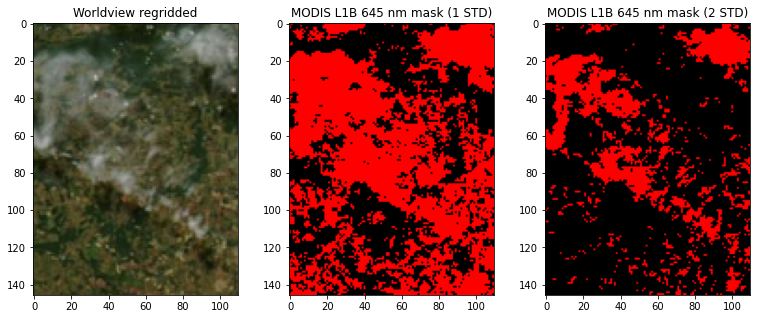

20150622_-1083_-1022
O2A band duration: 4.837705637328327e-07  h


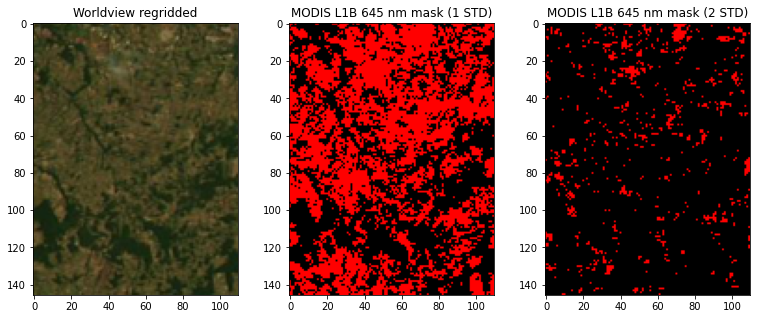

20150622_-1140_-1078
O2A band duration: 3.8048973591584297e-07  h


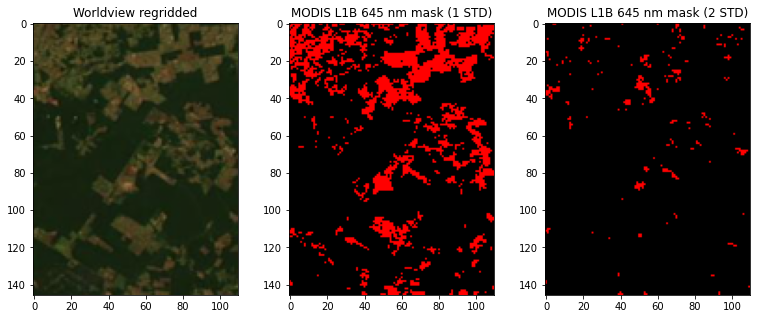

20150622_-1197_-1135
O2A band duration: 4.4771887284393114e-07  h


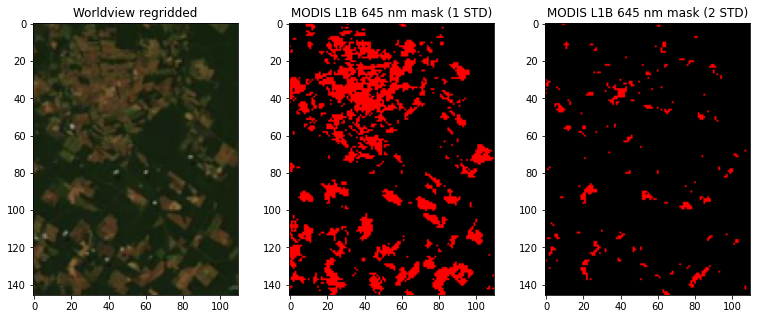

20150622_-1253_-1192
O2A band duration: 4.527508281171322e-07  h


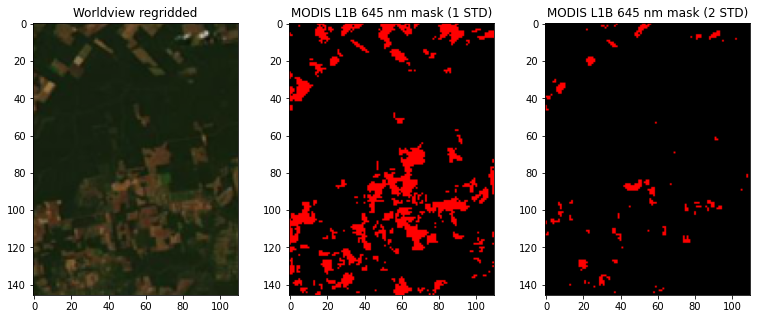

20150622_-1310_-1248
O2A band duration: 4.974269540980458e-07  h


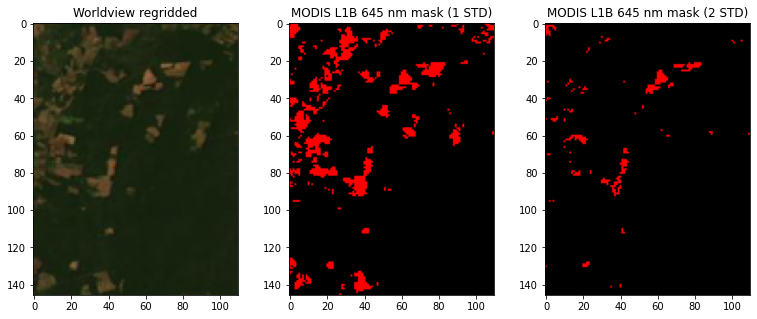

20150622_-1367_-1305
O2A band duration: 4.2795581975951793e-07  h


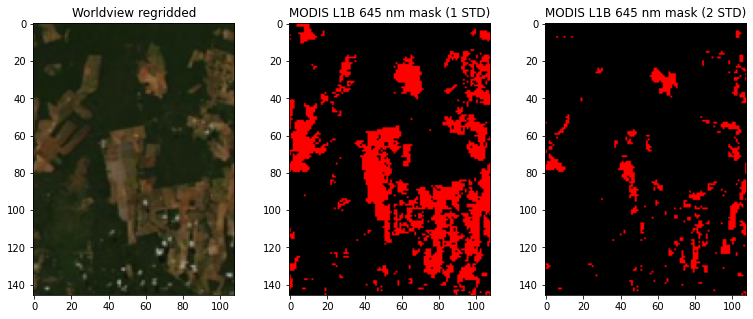

20150622_-1423_-1362
O2A band duration: 3.726438929637273e-07  h


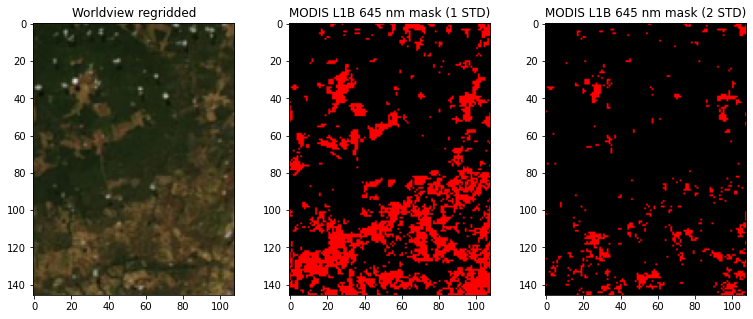

In [95]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
img_r, img_g, img_b = [], [], []
mod09_band1, mod09_band2, mod09_band3 = [], [], []
mod09_band4, mod09_band6, mod09_band7 = [], [], []
modl1b_ref_r, modl1b_rad_r = [], []
modl1b_ref_nr, modl1b_rad_nr = [], []
modl1b_ref_g, modl1b_rad_g = [], []
modl1b_ref_b, modl1b_rad_b = [], []
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][2, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][3, :], extent=sat.extent)
    #lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
    #                                                      mod.data['ref']['data'][5, :], extent=sat.extent)
    #lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
    #                                                      mod.data['ref']['data'][6, :], extent=sat.extent)
    modl1b = modis_l1b(fnames=sat.fnames['mod_02'], extent=sat.extent, resolution=0.25)
    #print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][0]))
    NxNy = mod_sfc_alb_2d_band1.shape
    l1b_r_lon_2d, l1b_r_lat_2d, ref_r_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent, NxNy=NxNy)
    l1b_r_lon_2d, l1b_r_lat_2d, rad_r_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent, NxNy=NxNy)
    #print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][1]))
    l1b_nr_lon_2d, l1b_nr_lat_2d, ref_nr_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][1, ...], extent=sat.extent, NxNy=NxNy)
    l1b_nr_lon_2d, l1b_nr_lat_2d, rad_nr_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][1, ...], extent=sat.extent, NxNy=NxNy)
    modl1b = modis_l1b(fnames=[sat.fnames['mod_02'][0].replace('QKM', 'HKM')], extent=sat.extent, resolution=0.5)
    #print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][0]))
    l1b_b_lon_2d, l1b_b_lat_2d, ref_b_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent, NxNy=NxNy)
    l1b_b_lon_2d, l1b_b_lat_2d, rad_b_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent, NxNy=NxNy)
    #print('wavelength: {}nm'.format(modl1b.data['wvl']['data'][1]))
    l1b_g_lon_2d, l1b_g_lat_2d, ref_g_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][1, ...], extent=sat.extent, NxNy=NxNy)
    l1b_g_lon_2d, l1b_g_lat_2d, rad_g_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][1, ...], extent=sat.extent, NxNy=NxNy)


    
    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
    img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
    img_lon2d, img_lat2d = np.meshgrid(img_lon, img_lat)
        
    lat_interval = abs(lat_2d[0, 1]-lat_2d[0, 0])/2
    lon_interval = abs(lon_2d[1, 0]-lon_2d[0, 0])/2
    img_reshape = np.zeros((mod_sfc_alb_2d_band1.shape[1], mod_sfc_alb_2d_band1.shape[0], 3))
    for i in range(len(lon_2d[:, 0])):
        for j in range(len(lat_2d[0, :])):
            index_lon2 = np.argmin(np.abs(img_lon-lon_2d[i, 0]-lon_interval))
            index_lon1 = np.argmin(np.abs(img_lon-lon_2d[i, 0]+lon_interval))
            index_lat2 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]-lat_interval))
            index_lat1 = np.argmin(np.abs(img_lat-lat_2d[0 ,j]+lat_interval))
            img_reshape[j, i, :] = np.nanmean(img[index_lat1:index_lat2+1, index_lon1:index_lon2+1, :3], axis=(0, 1))
    img_r.extend(img_reshape[:, :, 0].T.flatten())
    img_g.extend(img_reshape[:, :, 1].T.flatten())
    img_b.extend(img_reshape[:, :, 2].T.flatten())
    
    mod09_band1.extend(mod_sfc_alb_2d_band1.flatten())
    mod09_band2.extend(mod_sfc_alb_2d_band2.flatten())
    mod09_band3.extend(mod_sfc_alb_2d_band3.flatten())
    mod09_band4.extend(mod_sfc_alb_2d_band4.flatten())
    #mod09_band6.extend(mod_sfc_alb_2d_band6.flatten())
    #mod09_band7.extend(mod_sfc_alb_2d_band7.flatten())
    
    modl1b_ref_r.extend(ref_r_2d.flatten())
    modl1b_rad_r.extend(rad_r_2d.flatten())
    modl1b_ref_nr.extend(ref_nr_2d.flatten())
    modl1b_rad_nr.extend(rad_nr_2d.flatten())
    modl1b_ref_g.extend(ref_g_2d.flatten())
    modl1b_rad_g.extend(rad_g_2d.flatten())
    modl1b_ref_b.extend(ref_b_2d.flatten())
    modl1b_rad_b.extend(rad_b_2d.flatten())
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(13, 5))
    ax1.imshow(img_reshape)
    ax1.set_title('Worldview regridded')
    modl1b_ref_mask_img = np.zeros((ref_r_2d.shape[1], ref_r_2d.shape[0], 3))
    r_mask = ref_r_2d.T[::-1, :] > 0.039+0.023*1
    modl1b_ref_mask_img[:, :, 0][r_mask] = 1
    ax2.imshow(modl1b_ref_mask_img)
    ax2.set_title('MODIS L1B 645 nm mask (1 STD)')
    modl1b_ref_mask_img = np.zeros((ref_r_2d.shape[1], ref_r_2d.shape[0], 3))
    r_mask = ref_r_2d.T[::-1, :] > 0.039+0.023*2
    modl1b_ref_mask_img[:, :, 0][r_mask] = 1
    ax3.imshow(modl1b_ref_mask_img)
    ax3.set_title('MODIS L1B 645 nm mask (2 STD)')
    plt.show()
    plt.close()

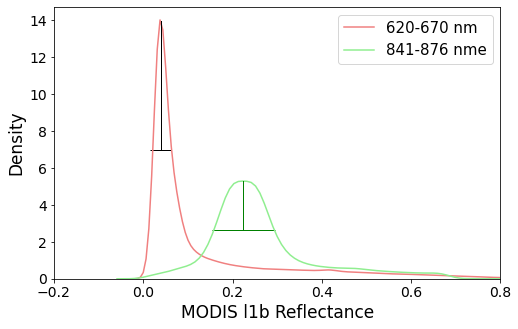

In [83]:
fig, ax11 = plt.subplots(1, 1, figsize=(8, 5), sharex=False)
"""sns.kdeplot(img[:, :, 0].flatten(), ax=ax11, color='r', label='Image r')
sns.kdeplot(img[:, :, 1].flatten(), ax=ax11, color='g', label='Image g')
sns.kdeplot(img[:, :, 2].flatten(), ax=ax11, color='b', label='Image b')"""


r_list = sns.kdeplot(modl1b_ref_r, ax=ax11, color='lightcoral', label='620-670 nm')
nr_list = sns.kdeplot(modl1b_ref_nr, ax=ax11, color='lightgreen', label='841-876 nme')
#sns.kdeplot(ref_b_2d.flatten(), ax=ax11, color='lightblue', label='MODIS b reflectance')
ax11.errorbar([0.224, 0.224], [5.32, 5.32/2], xerr=[0, 0.0705], color='g', linewidth=1)
ax11.errorbar([0.039, 0.039], [13.97, 13.97/2], xerr=[0, 0.023], color='k', linewidth=1)
ax11.tick_params(axis='x', labelsize=14)
ax11.tick_params(axis='y', labelsize=14)
ax11.set_ylabel('Density', fontsize=17)
ax11.set_xlabel('MODIS l1b Reflectance', fontsize=17)
ax11.set_xlim(-0.2, 0.8)
ax11.legend(fontsize=15)
plt.show()

NameError: name 'modl1b_ref_r' is not defined

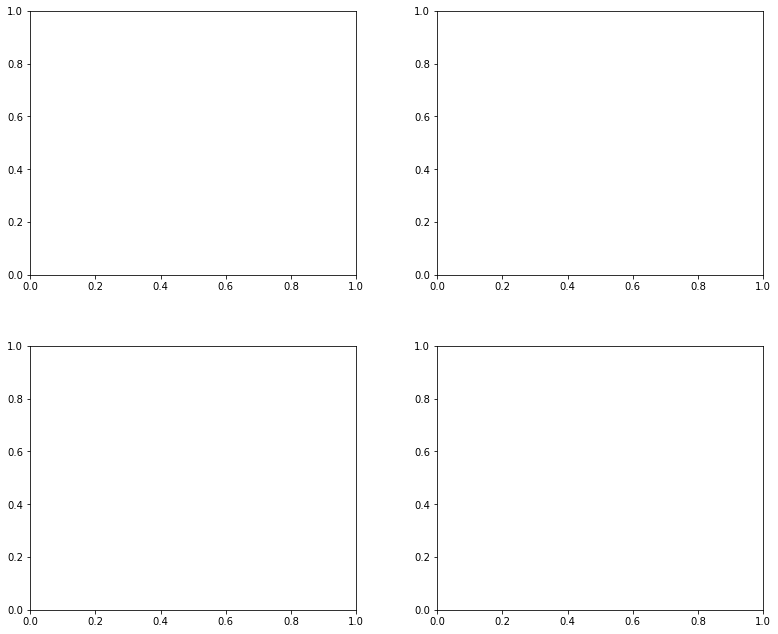

In [57]:
fig, ((ax11, ax12), (ax21, ax22)) = plt.subplots(2, 2, figsize=(12, 10), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax12, ax21, ax22]
label_size = 18
tick_size = 14
xy_list = [(modl1b_ref_r, mod09_band1), (modl1b_ref_nr, mod09_band2), (modl1b_ref_g, mod09_band4),
           (modl1b_ref_b, mod09_band3)]
xy_list_label = [('MODIS l1b reflectance', 'MODIS 09 surface albedo') for _ in range(4)]
title_list = ['620-670 nm', '841-876 nm', '545-565 nm', '459-479 nm']
for i in range(4):
    ax = ax_list[i]

    x = np.array(xy_list[i][0])
    y = np.array(xy_list[i][1])
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=25, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    
    # plot figure
    ax.scatter(plot_x, plot_y, c=z, s=15, cmap=light_jet)
    x_array = np.array([np.min(x), np.max(x)])
    
    """
    ax.plot(x_array, x_array, 'r', label='ideal')
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
    """
    ax.set_xlabel(xy_list_label[i][0], fontsize=label_size)
    ax.set_ylabel(xy_list_label[i][1], fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)
    xmin, xmax = 0, 0.8
    ymin, ymax = 0, 0.8
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
            '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')
    ax.set_title(title_list[i], fontsize=label_size+2)
    if i == 0:
        ax.errorbar(0.039, 0.025, xerr=0.023*2, color='k', marker='o', markersize=3, capsize=3)
    if i == 1:
        ax.errorbar(0.224, 0.27, xerr=0.0705*2, color='k', marker='o', markersize=3, capsize=3)
    #ax.plot([0,1], [0,1], 'r')
plt.show()

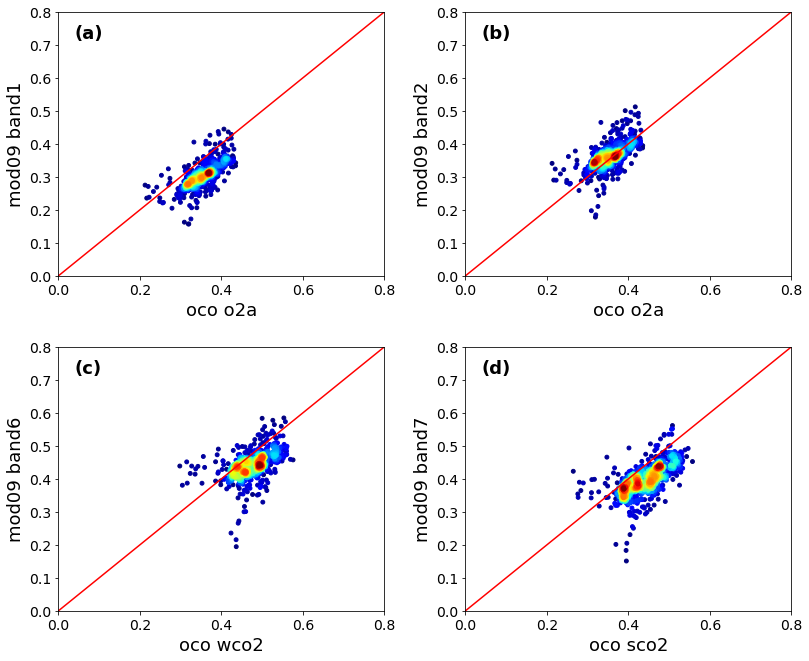

In [56]:
fig, ((ax11, ax12), (ax21, ax22)) = plt.subplots(2, 2, figsize=(12, 10), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax12, ax21, ax22]
label_size = 18
tick_size = 14
xy_list = [(oco_alb_o2a, mod09_alb_band1), (oco_alb_o2a, mod09_alb_band2),
           (oco_alb_wco2, mod09_alb_band6), (oco_alb_sco2, mod09_alb_band7)]
xy_list_label = [('oco o2a', 'mod09 band1'), ('oco o2a', 'mod09 band2'),
           ('oco wco2', 'mod09 band6'), ('oco sco2', 'mod09 band7')]
for i in range(4):
    ax = ax_list[i]

    x = np.array(xy_list[i][0])
    y = np.array(xy_list[i][1])
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=25, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    
    # plot figure
    ax.scatter(plot_x, plot_y, c=z, s=15, cmap=light_jet)
    x_array = np.array([np.min(x), np.max(x)])
    
    """
    ax.plot(x_array, x_array, 'r', label='ideal')
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
    """
    ax.set_xlabel(xy_list_label[i][0], fontsize=label_size)
    ax.set_ylabel(xy_list_label[i][1], fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)
    xmin, xmax = 0, 0.8
    ymin, ymax = 0, 0.8
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
            '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')
    ax.plot([0,1], [0,1], 'r')
plt.show()

In [6]:
sat

In [7]:

# band 1: 620  - 670  nm, index 0
# band 2: 841  - 876  nm, index 1
# band 3: 459  - 479  nm, index 2
# band 4: 545  - 565  nm, index 3
# band 5: 1230 - 1250 nm, index 4
# band 6: 1628 - 1652 nm, index 5
# band 7: 2105 - 2155 nm, index 6

#R = 0.66 μm
#G = 0.55 μm
#B = 0.47 μm


In [248]:
def pre_cld_oco_rgb(sat, mode='rgb', cth=None, scale_factor=1.0, solver='3D'):

    # retrieve 1. cloud top height; 2. sensor zenith; 3. sensor azimuth for MODIS L1B (250nm) data from MODIS L2 (5km resolution)
    # ===================================================================================
    modl2      = modis_l2(fnames=sat.fnames['mod_l2'], extent=sat.extent, vnames=['Sensor_Zenith', 'Sensor_Azimuth', 'Cloud_Top_Height'])
    logic_cth  = (modl2.data['cloud_top_height']['data']>0.0)
    lon0       = modl2.data['lon_5km']['data']
    lat0       = modl2.data['lat_5km']['data']
    cth0       = modl2.data['cloud_top_height']['data']/1000.0 # units: km

    mod03      = modis_03(fnames=sat.fnames['mod_03'], extent=sat.extent, vnames=['Height'])
    logic_sfh  = (mod03.data['height']['data']>0.0)
    lon1       = mod03.data['lon']['data']
    lat1       = mod03.data['lat']['data']
    sfh1       = mod03.data['height']['data']/1000.0 # units: km
    sza1       = mod03.data['sza']['data']
    saa1       = mod03.data['saa']['data']
    vza1       = mod03.data['vza']['data']
    vaa1       = mod03.data['vaa']['data']

    modl1b = modis_l1b(fnames=sat.fnames['mod_02'], extent=sat.extent)
    lon_2d, lat_2d, ref_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['ref']['data'][0, ...], extent=sat.extent)
    lon_2d, lat_2d, rad_2d = grid_modis_by_extent(modl1b.data['lon']['data'], modl1b.data['lat']['data'], modl1b.data['rad']['data'][0, ...], extent=sat.extent)

    a0         = np.median(ref_2d)
    mu0        = np.cos(np.deg2rad(sza1.mean()))

    xx_2stream = np.linspace(0.0, 200.0, 10000)
    yy_2stream = cal_r_twostream(xx_2stream, a=a0, mu=mu0)

    # =============================================================================
    if mode == 'rgb':
        mod_rgb = mpl_img.imread(sat.fnames['mod_rgb'][0])

        lon_rgb0 = np.linspace(sat.extent[0], sat.extent[1], mod_rgb.shape[1]+1)
        lat_rgb0 = np.linspace(sat.extent[2], sat.extent[3], mod_rgb.shape[0]+1)
        lon_rgb = (lon_rgb0[1:]+lon_rgb0[:-1])/2.0
        lat_rgb = (lat_rgb0[1:]+lat_rgb0[:-1])/2.0

        mod_r = mod_rgb[:, :, 0]
        mod_g = mod_rgb[:, :, 1]
        mod_b = mod_rgb[:, :, 2]

        logic_rgb_nan0 = (mod_r<=(np.median(mod_r)*1.06)) |\
                        (mod_g<=(np.median(mod_g)*1.06)) |\
                        (mod_b<=(np.median(mod_b)*1.06))
        logic_rgb_nan = np.flipud(logic_rgb_nan0).T

        x0_rgb = lon_rgb[0]
        y0_rgb = lat_rgb[0]
        dx_rgb = lon_rgb[1] - x0_rgb
        dy_rgb = lat_rgb[1] - y0_rgb

        indices_x = np.int_(np.round((lon_2d-x0_rgb)/dx_rgb, decimals=0))
        indices_y = np.int_(np.round((lat_2d-y0_rgb)/dy_rgb, decimals=0))

        logic_ref_nan = logic_rgb_nan[indices_x, indices_y]

        indices    = np.where(logic_ref_nan!=1)
        indices_x  = indices[0]
        indices_y  = indices[1]
        lon        = lon_2d[indices_x, indices_y]
        lat        = lat_2d[indices_x, indices_y]
         

    elif mode == 'ori':
        threshold  = a0 * 2.0 # needs to be improved
        indices    = np.where(ref_2d>threshold)
        indices_x  = indices[0]
        indices_y  = indices[1]
        lon        = lon_2d[indices_x, indices_y]
        lat        = lat_2d[indices_x, indices_y]
    return lon, lat

In [260]:
same_list = []
only_rgb = []
only_ori = []
for i in range(len(rgb)):
    if rgb[i] in ori:
        same_list.append(rgb[i])
    else:
        only_rgb.append(rgb[i])
for i in range(len(ori)):
    if ori[i] not in same_list:
        only_ori.append(rgb[i])

In [261]:
print(len(same_list), len(only_rgb), len(only_ori))

16918 7012 143


In [50]:
img = mpimg.imread(sat.fnames['mod_rgb'][0])
rgb_array = pd.DataFrame(img[:, :, :3].reshape(img.shape[0]*img.shape[1], 3),
                        columns=['r', 'g', 'b'])
rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
rgb_array['g/r'] = np.array(rgb_array[['g']])/np.array(rgb_array[['r']])
rgb_array['b/r'] = np.array(rgb_array[['b']])/np.array(rgb_array[['r']])
rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
rgb_array['b/g'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])

/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in true_divide
  
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in true_divide
  
/Users/stev

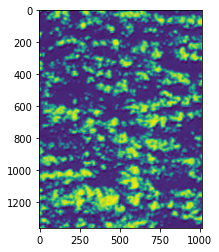

In [10]:
plt.imshow(img[:, :, 0])
plt.show()

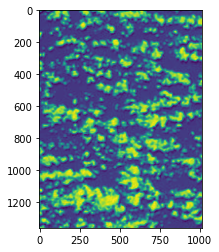

In [11]:
plt.imshow(img[:, :, 1])
plt.show()

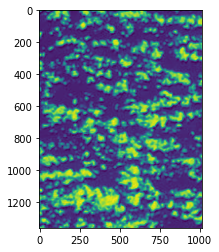

In [12]:
plt.imshow(img[:, :, 2])
plt.show()

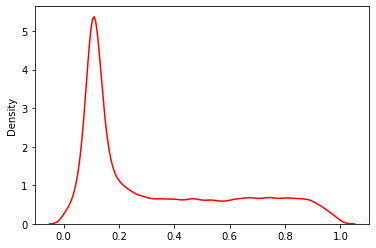

In [73]:
sns.kdeplot(img[:, :, 0].flatten(), color='r',
             label='r')#, color='lightcoral', label='qf=0')
plt.show()

In [76]:
img.shape

(1359, 1013, 4)

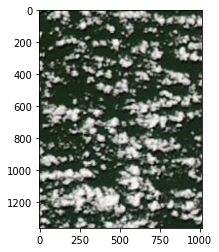

In [78]:
plt.imshow(img)

In [81]:
img_lon = np.linspace(sat.extent[0], sat.extent[1], img.shape[1])
img_lat = np.linspace(sat.extent[2], sat.extent[3], img.shape[0])
print(sat.extent[:2])
img_lon

[-57.9668, -57.5068]


array([-57.9668    , -57.96634545, -57.96589091, ..., -57.50770909,
       -57.50725455, -57.5068    ])

/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:43: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:53: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:53: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:76: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:76: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:77: RuntimeWarni

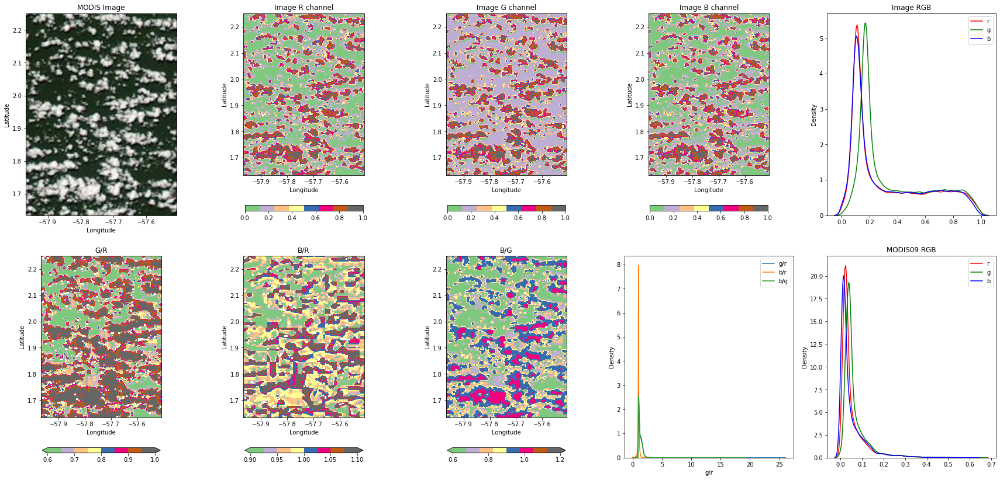

In [171]:
f, ((ax11, ax12, ax13, ax14, ax15),
    (ax21, ax22, ax23, ax24, ax25)) =plt.subplots(2, 5, figsize=(30, 14))

wesn= sat.extent#png[1]
img = mpimg.imread(sat.fnames['mod_rgb'][0])
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]


ax11.imshow(img,extent=wesn)
ax11.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax11.set_ylim(np.min(lat_dom), np.max(lat_dom))
ax11.set_xlabel('Longitude')
ax11.set_ylabel('Latitude')
ax11.set_title('MODIS Image')

cmap = 'Accent'
cbar_karg = {'location':'bottom', 'fraction':0.05, 'shrink':0.7}
im12 = ax12.imshow(img[:, :, 0], extent=wesn, cmap=cmap)
ax12.set_xlabel('Longitude')
ax12.set_ylabel('Latitude')
ax12.set_title('Image R channel')
f.colorbar(im12, ax=ax12, **cbar_karg)

im13 = ax13.imshow(img[:, :, 1], extent=wesn, cmap=cmap)
ax13.set_xlabel('Longitude')
ax13.set_ylabel('Latitude')
ax13.set_title('Image G channel')
f.colorbar(im13, ax=ax13, **cbar_karg)

im14 = ax14.imshow(img[:, :, 2], extent=wesn, cmap=cmap)
ax14.set_xlabel('Longitude')
ax14.set_ylabel('Latitude')
ax14.set_title('Image B channel')
f.colorbar(im14, ax=ax14, **cbar_karg)

sns.kdeplot(img[:, :, 0].flatten(), ax=ax15, color='r', label='r')
sns.kdeplot(img[:, :, 1].flatten(), ax=ax15, color='g', label='g')
sns.kdeplot(img[:, :, 2].flatten(), ax=ax15, color='b', label='b')
ax15.legend()
ax15.set_title('Image RGB')

array21 = img[:, :, 2]/img[:, :, 1]
array21[img[:, :, 0]==0] = np.nan
threshold21 = 1
array21[array21>threshold21] = threshold21
im21 = ax21.imshow(array21, extent=wesn, cmap=cmap, vmin=0.6)
ax21.set_xlabel('Longitude')
ax21.set_ylabel('Latitude')
ax21.set_title('G/R')
f.colorbar(im21, ax=ax21, extend='both', **cbar_karg)

array22 = img[:, :, 2]/img[:, :, 0]
array22[img[:, :, 0]==0] = np.nan
threshold22 = 1.1
array22[array22>threshold22] = threshold22
im22 = ax22.imshow(array22, extent=wesn, cmap=cmap, vmin=0.9)
ax22.set_xlabel('Longitude')
ax22.set_ylabel('Latitude')
ax22.set_title('B/R')
f.colorbar(im22, ax=ax22, extend='both', **cbar_karg)

array23 = img[:, :, 2]/img[:, :, 1]
array23[img[:, :, 1]==0] = np.nan
threshold23 = 1.2
array23[array23>threshold23] = threshold23
im23 = ax23.imshow(array23, extent=wesn, cmap=cmap, vmin=0.6)
ax23.set_xlabel('Longitude')
ax23.set_ylabel('Latitude')
ax23.set_title('B/G')
f.colorbar(im23, ax=ax23, extend='both', **cbar_karg)


rgb_array = pd.DataFrame(img[:, :, :3].reshape(img.shape[0]*img.shape[1], 3),
                        columns=['r', 'g', 'b'])
rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
rgb_array['g/r'] = np.array(rgb_array[['g']])/np.array(rgb_array[['r']])
rgb_array['b/r'] = np.array(rgb_array[['b']])/np.array(rgb_array[['r']])
rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
rgb_array['b/g'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])

sns.kdeplot(rgb_array['g/r'], ax=ax24, label='g/r')
sns.kdeplot(rgb_array['b/r'], ax=ax24, label='b/r')
sns.kdeplot(rgb_array['b/g'], ax=ax24, label='b/g')
ax24.legend()
#ax24.set_xlim(0.4, 2.4)

sns.kdeplot(mod_sfc_alb_2d_band1.flatten(), ax=ax25, color='r', label='r')
sns.kdeplot(mod_sfc_alb_2d_band4.flatten(), ax=ax25, color='g', label='g')
sns.kdeplot(mod_sfc_alb_2d_band3.flatten(), ax=ax25, color='b', label='b')
ax25.legend()
ax25.set_title('MODIS09 RGB')

plt.show()

20150622_163_225
O2A band duration: 1.1506580570615673e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

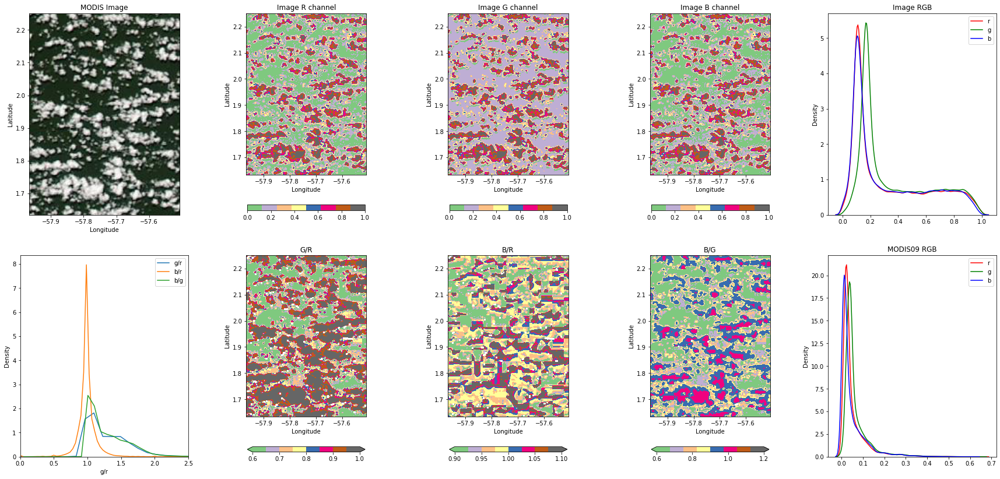

20150622_107_168
O2A band duration: 1.271831388294231e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

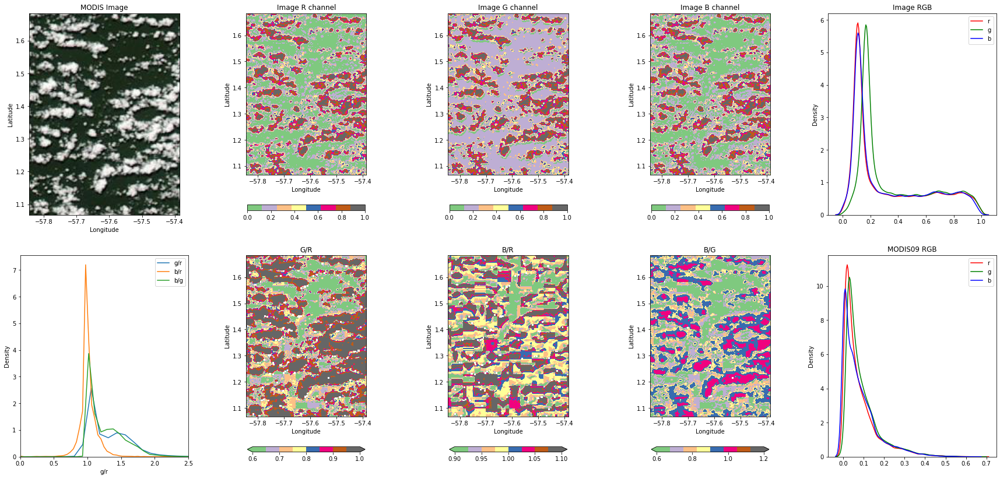

20150622_50_112
O2A band duration: 1.2533986106670151e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeW

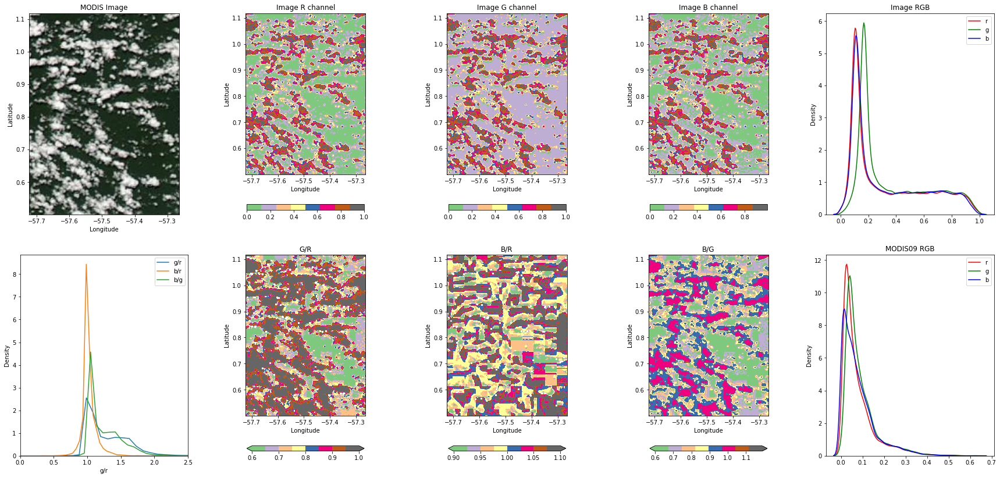

20150622_-7_55
O2A band duration: 1.3095811118546407e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeW

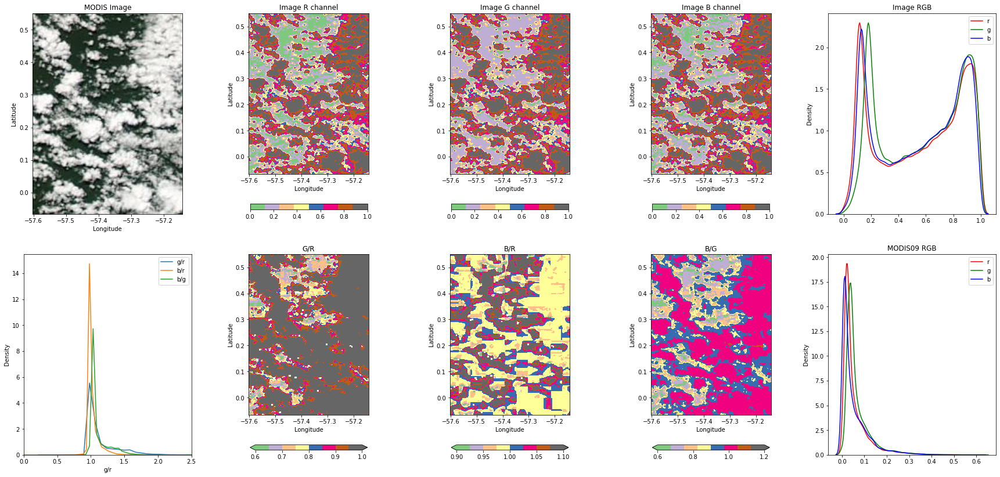

20150622_-63_-2
O2A band duration: 1.2219416668004771e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

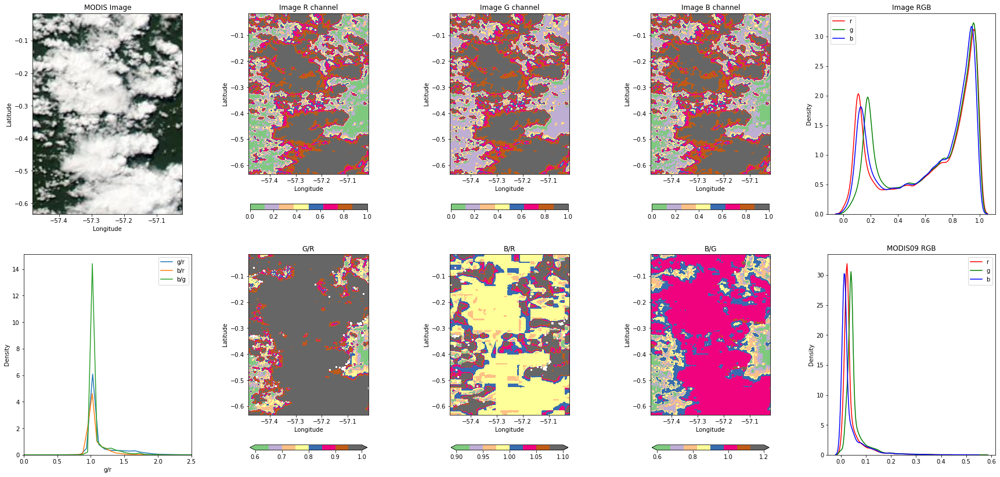

20150622_-120_-58
O2A band duration: 1.235107776867355e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

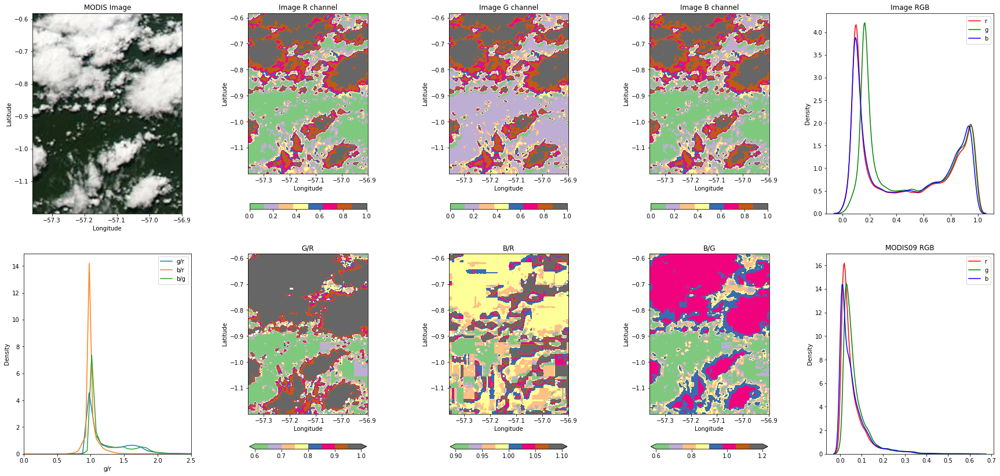

20150622_-177_-115
O2A band duration: 1.2485922222064498e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

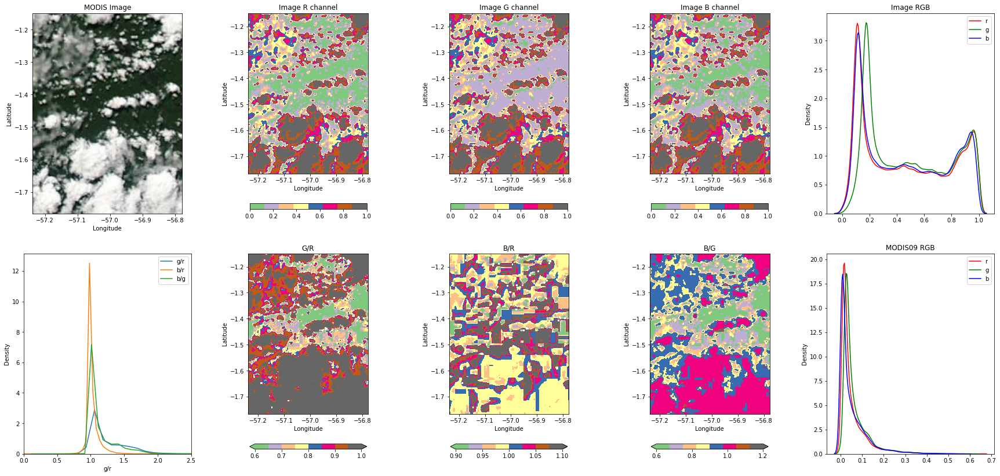

20150622_-233_-172
O2A band duration: 1.119296110927179e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

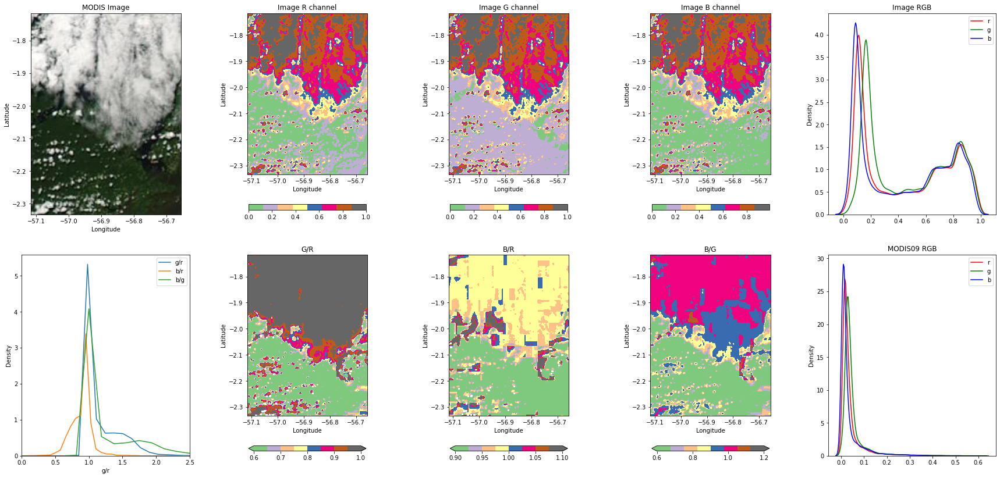

20150622_-290_-228
O2A band duration: 1.4079769445945406e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeW

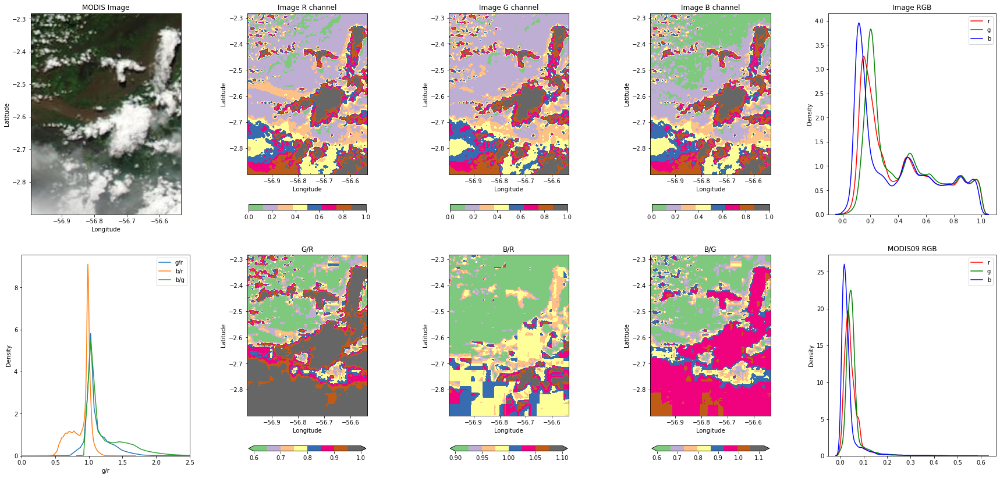

20150622_-347_-285
O2A band duration: 1.5528308318203522e-06  h


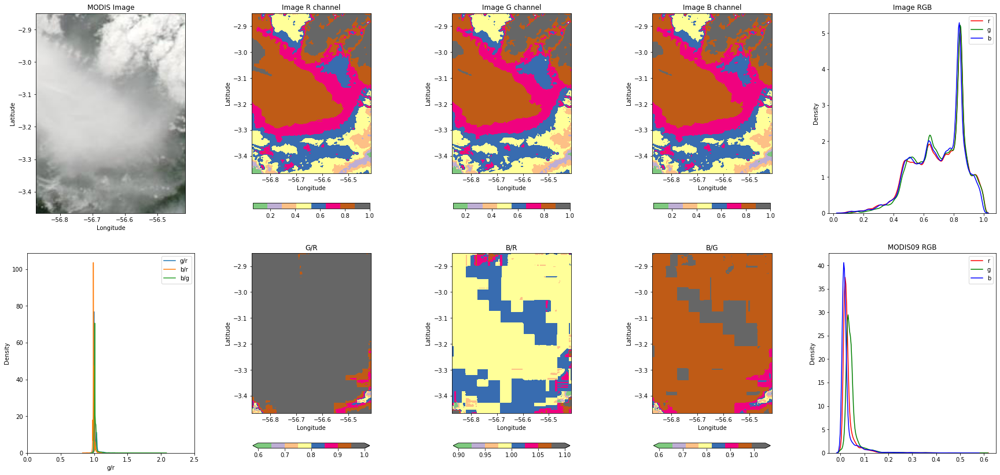

20150622_-403_-342
O2A band duration: 1.3075747220783442e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

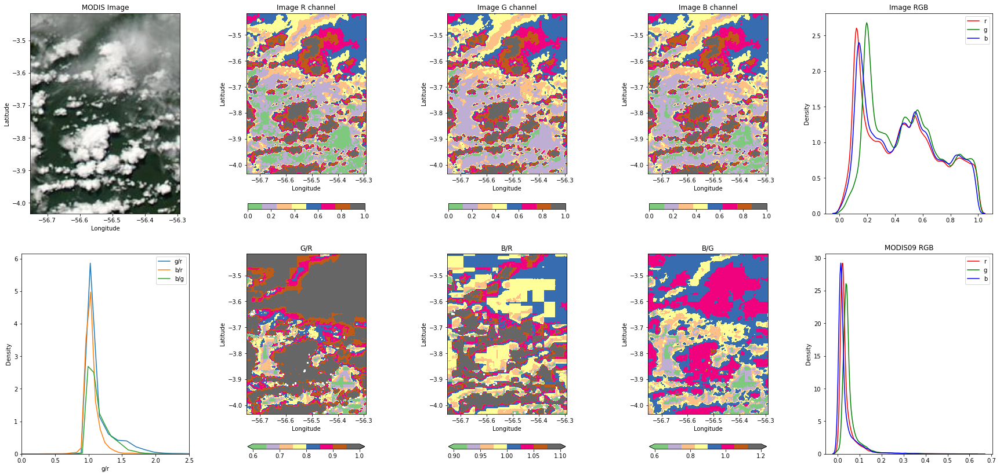

20150622_-460_-398
O2A band duration: 1.1834911108760732e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

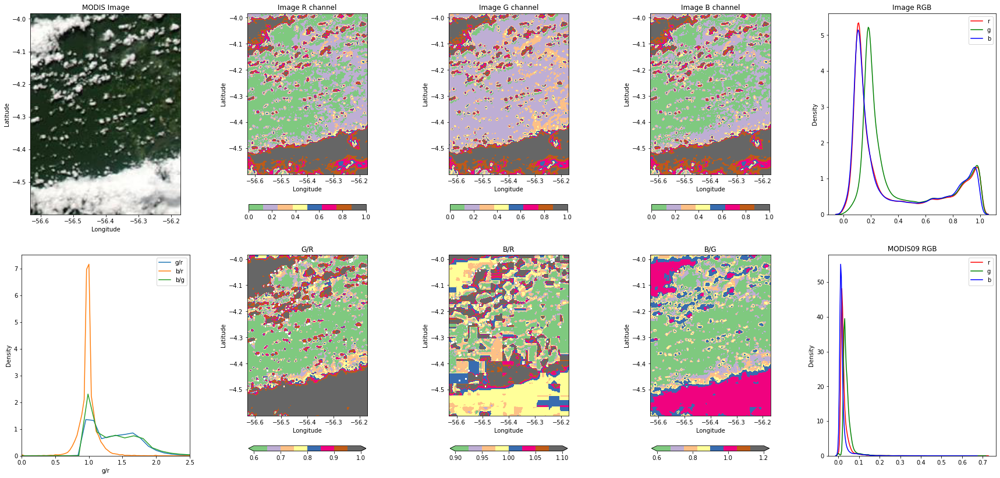

20150622_-517_-455
O2A band duration: 1.3109138894328174e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

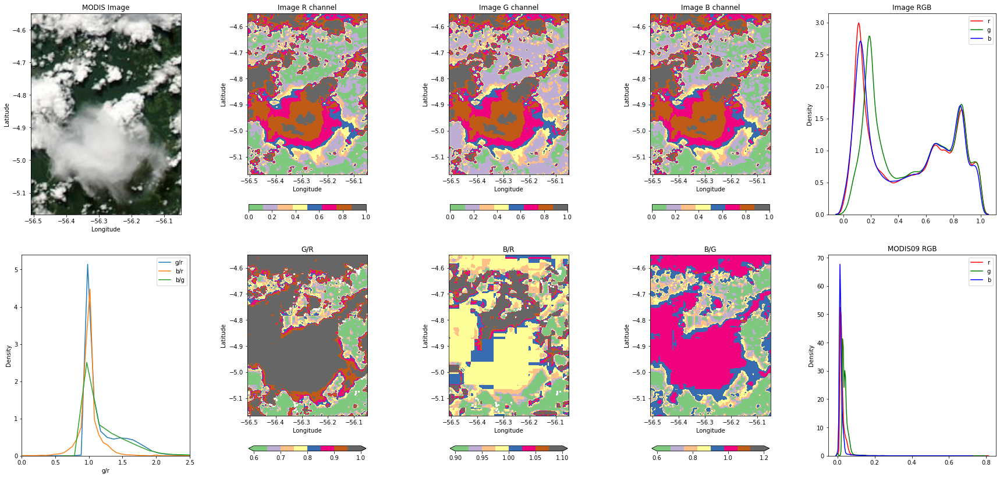

20150622_-573_-512
O2A band duration: 1.4198222217803253e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

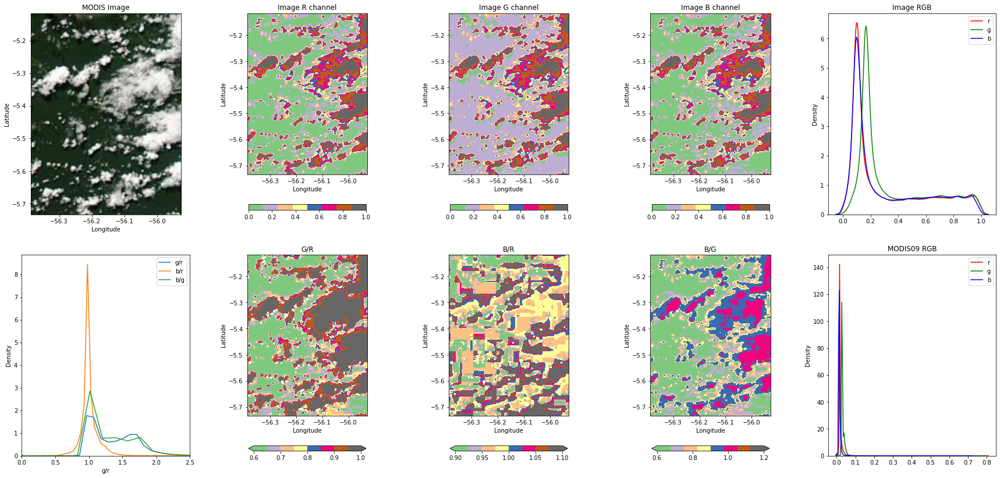

20150622_-630_-568
O2A band duration: 1.261882221620504e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

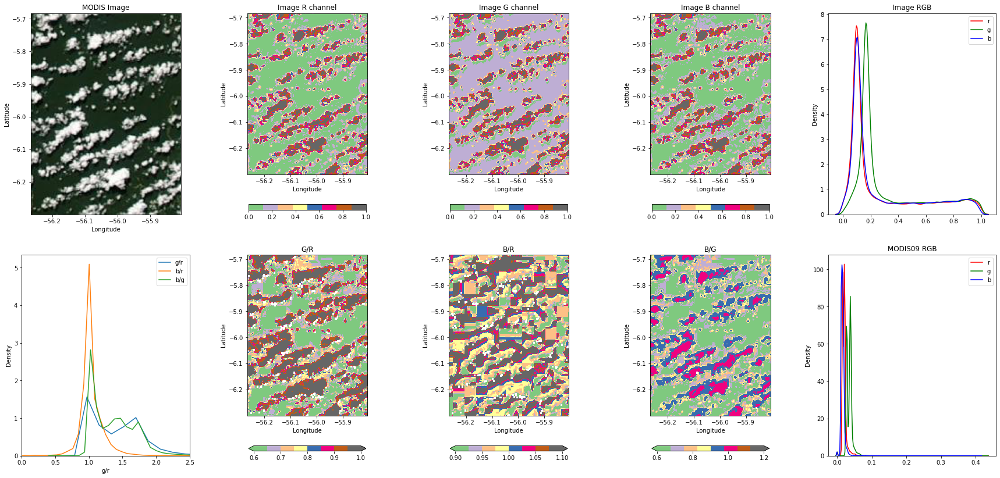

20150622_-687_-625
O2A band duration: 1.5589361121076055e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

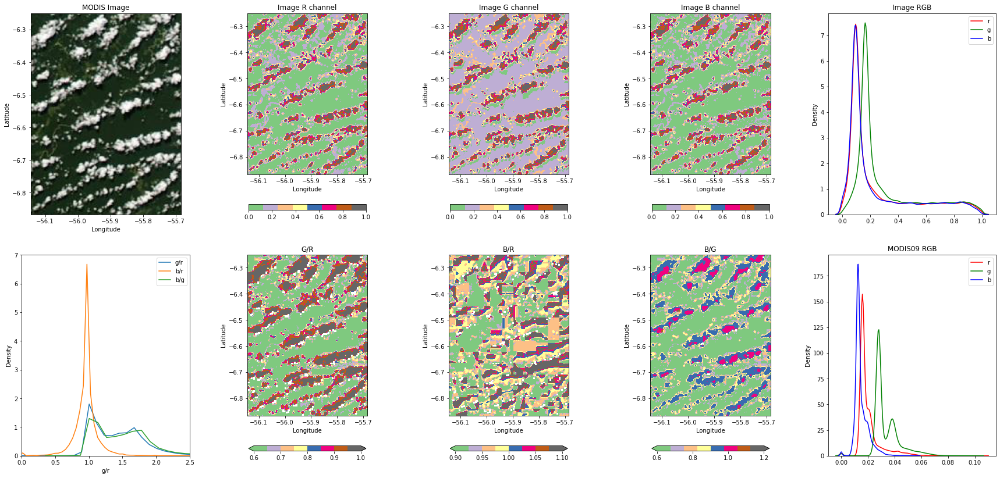

20150622_-743_-682
O2A band duration: 1.8799208333398888e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWar

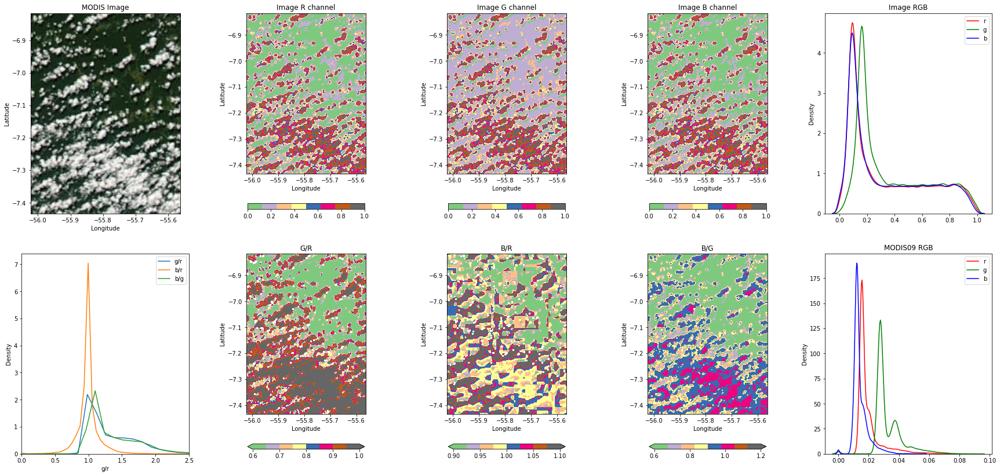

20150622_-800_-738
O2A band duration: 1.7894083329237118e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeW

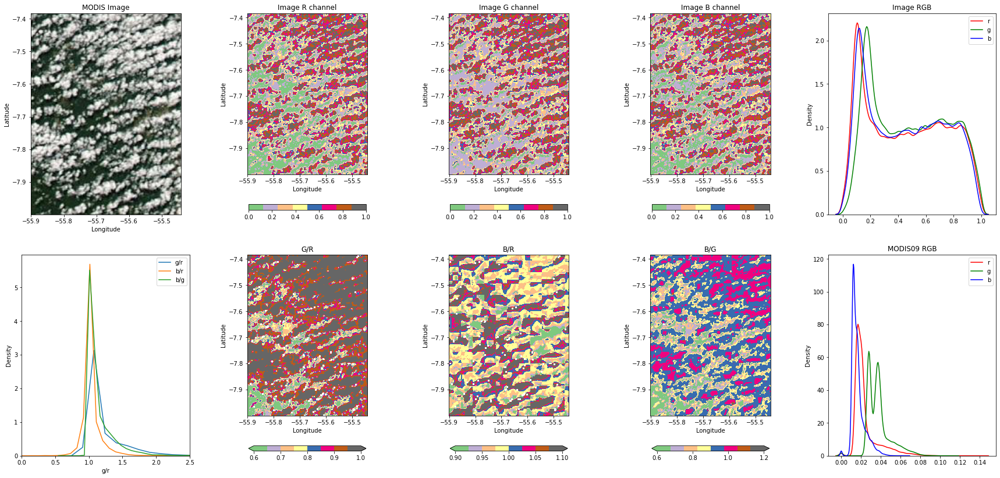

20150622_-857_-795
O2A band duration: 1.4114494438722936e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeW

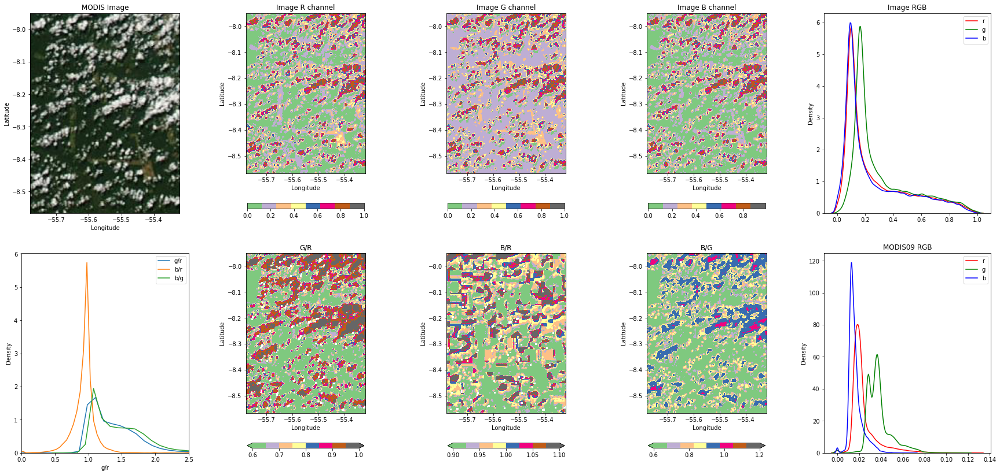

20150622_-913_-852
O2A band duration: 1.7074416670463202e-06  h


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

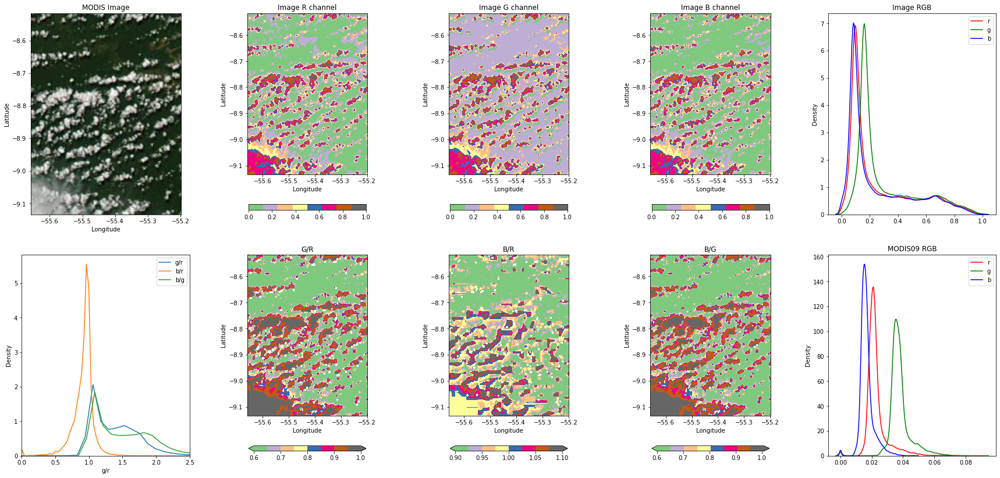

20150622_-970_-908
O2A band duration: 1.2526849988919114e-06  h


KeyboardInterrupt: 

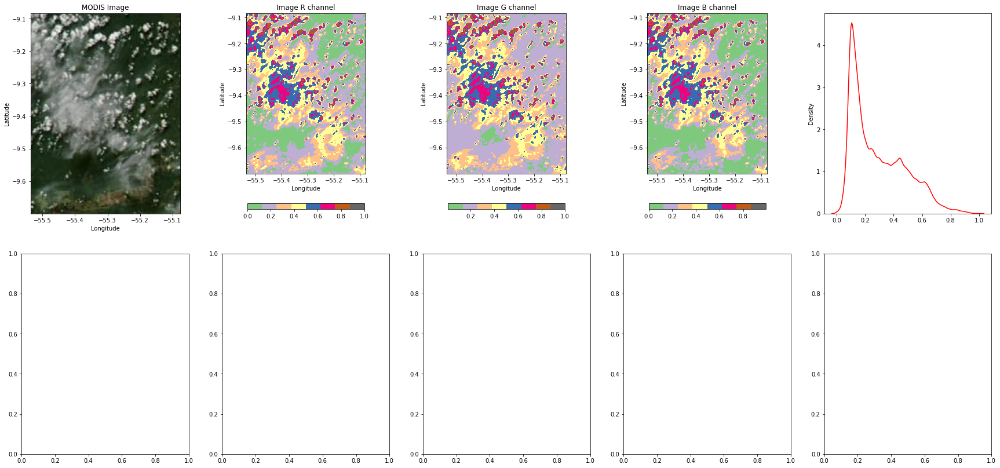

In [173]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
img_r, img_g, img_b = [], [], []
mod09_band1, mod09_band2, mod09_band3 = [], [], []
mod09_band4, mod09_band6, mod09_band7 = [], [], []
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][2, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][3, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][5, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][6, :], extent=sat.extent)

    
    f, ((ax11, ax12, ax13, ax14, ax15),
        (ax24, ax21, ax22, ax23, ax25)) =plt.subplots(2, 5, figsize=(30, 14))

    wesn= sat.extent#png[1]
    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    lon_dom = sat.extent[:2]
    lat_dom = sat.extent[2:]


    ax11.imshow(img,extent=wesn)
    ax11.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax11.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax11.set_xlabel('Longitude')
    ax11.set_ylabel('Latitude')
    ax11.set_title('MODIS Image')

    cmap = 'Accent'
    cbar_karg = {'location':'bottom', 'fraction':0.05, 'shrink':0.7}
    im12 = ax12.imshow(img[:, :, 0], extent=wesn, cmap=cmap)
    ax12.set_xlabel('Longitude')
    ax12.set_ylabel('Latitude')
    ax12.set_title('Image R channel')
    f.colorbar(im12, ax=ax12, **cbar_karg)

    im13 = ax13.imshow(img[:, :, 1], extent=wesn, cmap=cmap)
    ax13.set_xlabel('Longitude')
    ax13.set_ylabel('Latitude')
    ax13.set_title('Image G channel')
    f.colorbar(im13, ax=ax13, **cbar_karg)

    im14 = ax14.imshow(img[:, :, 2], extent=wesn, cmap=cmap)
    ax14.set_xlabel('Longitude')
    ax14.set_ylabel('Latitude')
    ax14.set_title('Image B channel')
    f.colorbar(im14, ax=ax14, **cbar_karg)

    sns.kdeplot(img[:, :, 0].flatten(), ax=ax15, color='r', label='r')
    sns.kdeplot(img[:, :, 1].flatten(), ax=ax15, color='g', label='g')
    sns.kdeplot(img[:, :, 2].flatten(), ax=ax15, color='b', label='b')
    ax15.legend()
    ax15.set_title('Image RGB')

    array21 = img[:, :, 1]/img[:, :, 0]
    array21[img[:, :, 0]==0] = np.nan
    threshold21 = 1
    array21[array21>threshold21] = threshold21
    im21 = ax21.imshow(array21, extent=wesn, cmap=cmap, vmin=0.6)
    ax21.set_xlabel('Longitude')
    ax21.set_ylabel('Latitude')
    ax21.set_title('G/R')
    f.colorbar(im21, ax=ax21, extend='both', **cbar_karg)

    array22 = img[:, :, 2]/img[:, :, 0]
    array22[img[:, :, 0]==0] = np.nan
    threshold22 = 1.1
    array22[array22>threshold22] = threshold22
    im22 = ax22.imshow(array22, extent=wesn, cmap=cmap, vmin=0.9)
    ax22.set_xlabel('Longitude')
    ax22.set_ylabel('Latitude')
    ax22.set_title('B/R')
    f.colorbar(im22, ax=ax22, extend='both', **cbar_karg)

    array23 = img[:, :, 2]/img[:, :, 1]
    array23[img[:, :, 1]==0] = np.nan
    threshold23 = 1.2
    array23[array23>threshold23] = threshold23
    im23 = ax23.imshow(array23, extent=wesn, cmap=cmap, vmin=0.6)
    ax23.set_xlabel('Longitude')
    ax23.set_ylabel('Latitude')
    ax23.set_title('B/G')
    f.colorbar(im23, ax=ax23, extend='both', **cbar_karg)

    rgb_array = pd.DataFrame(img[:, :, :3].reshape(img.shape[0]*img.shape[1], 3),
                            columns=['r', 'g', 'b'])
    rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
    rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
    rgb_array['g/r'] = np.array(rgb_array[['g']])/np.array(rgb_array[['r']])
    rgb_array['b/r'] = np.array(rgb_array[['b']])/np.array(rgb_array[['r']])
    rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
    rgb_array['b/g'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
    sns.kdeplot(rgb_array['g/r'], ax=ax24, label='g/r')
    sns.kdeplot(rgb_array['b/r'], ax=ax24, label='b/r')
    sns.kdeplot(rgb_array['b/g'], ax=ax24, label='b/g')
    ax24.legend()
    ax24.set_xlim(0, 2.5)

    sns.kdeplot(mod_sfc_alb_2d_band1.flatten(), ax=ax25, color='r', label='r')
    sns.kdeplot(mod_sfc_alb_2d_band4.flatten(), ax=ax25, color='g', label='g')
    sns.kdeplot(mod_sfc_alb_2d_band3.flatten(), ax=ax25, color='b', label='b')
    ax25.legend()
    ax25.set_title('MODIS09 RGB')

    plt.show()
    

20150622_163_225
O2A band duration: 1.6450772252735785e-06  h
[-57.9668, -57.5068, 1.6343, 2.251]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

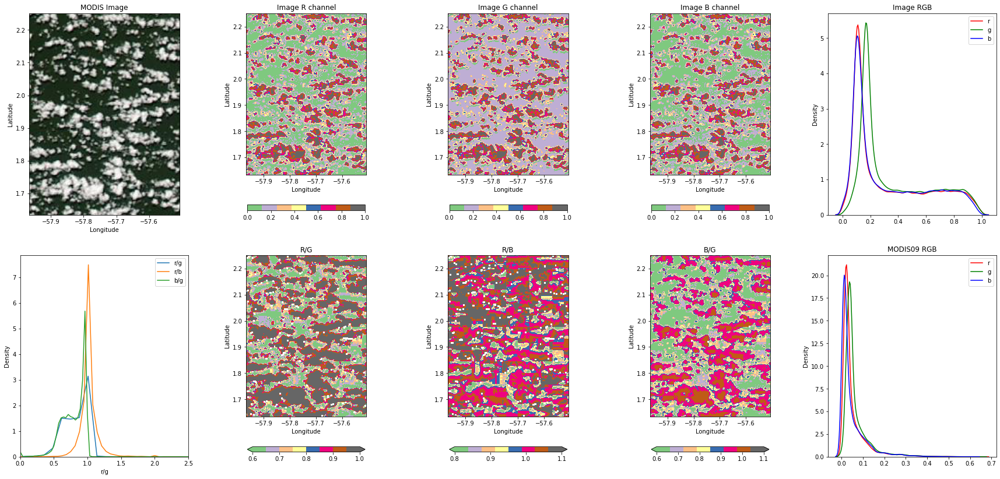

20150622_107_168
O2A band duration: 1.695726661839419e-06  h
[-57.8453, -57.3853, 1.0676, 1.6843]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

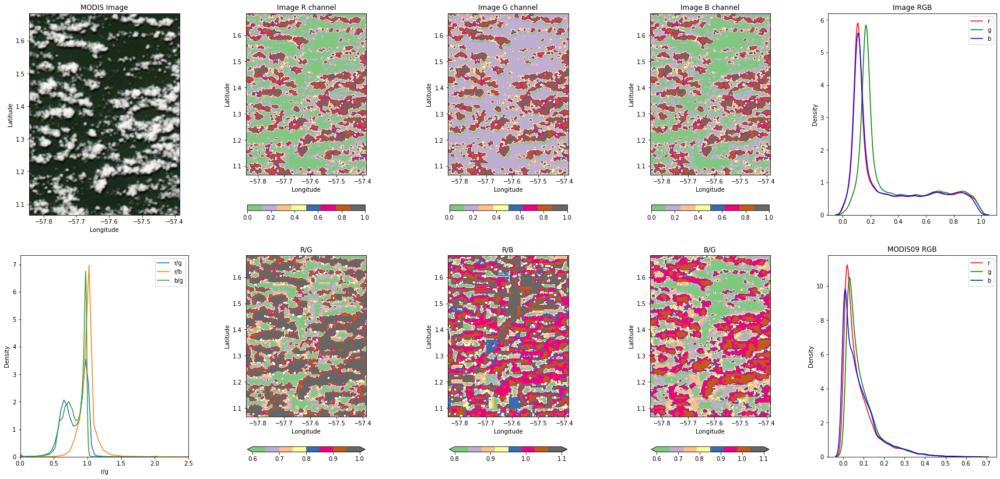

20150622_50_112
O2A band duration: 1.3014366656231383e-06  h
[-57.7238, -57.2638, 0.5009, 1.1176]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

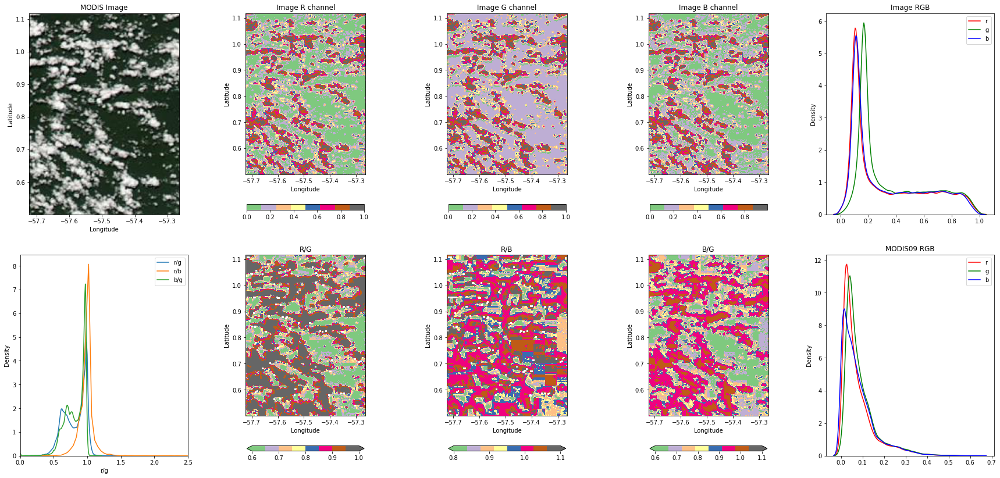

20150622_-7_55
O2A band duration: 1.1941386118350137e-06  h
[-57.6023, -57.1423, -0.0658, 0.5509]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

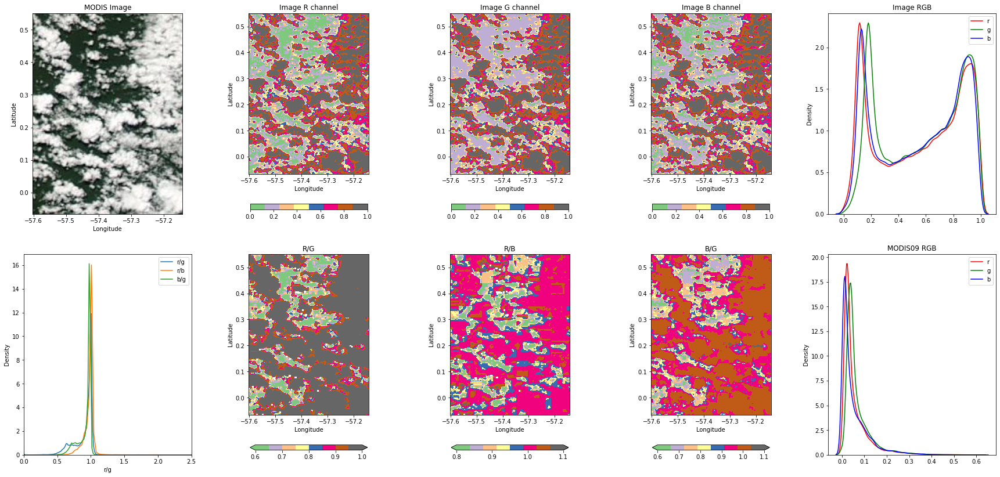

20150622_-63_-2
O2A band duration: 9.340735834686913e-06  h
[-57.4808, -57.0208, -0.6326, -0.0158]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

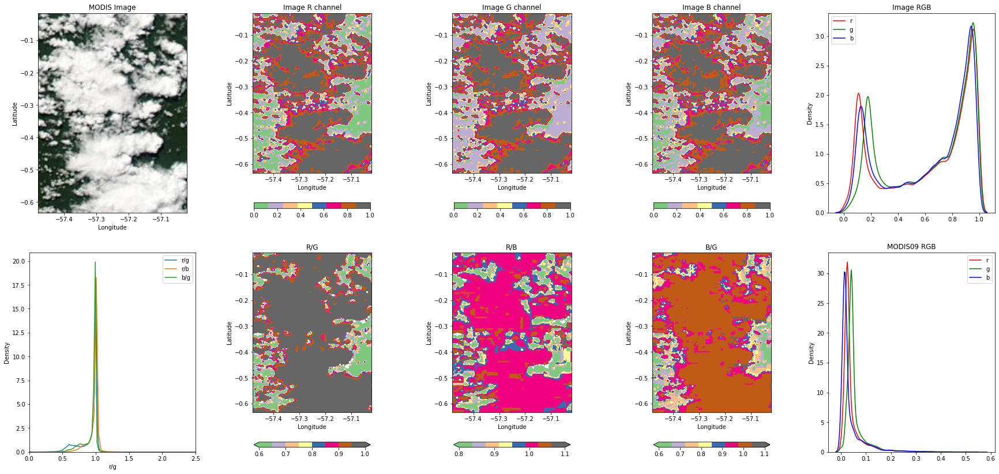

20150622_-120_-58
O2A band duration: 1.6420949961886639e-06  h
[-57.3594, -56.8994, -1.1993, -0.5826]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

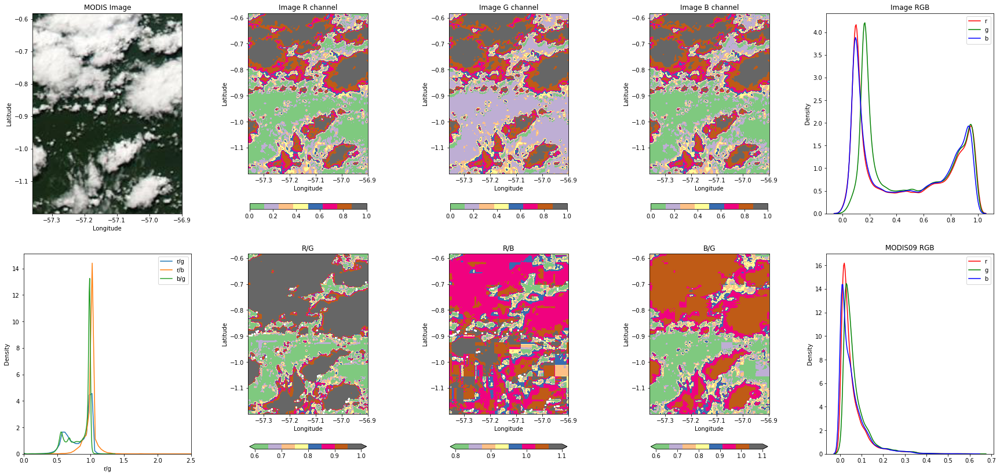

20150622_-177_-115
O2A band duration: 1.513322495156899e-06  h
[-57.2379, -56.7779, -1.766, -1.1493]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

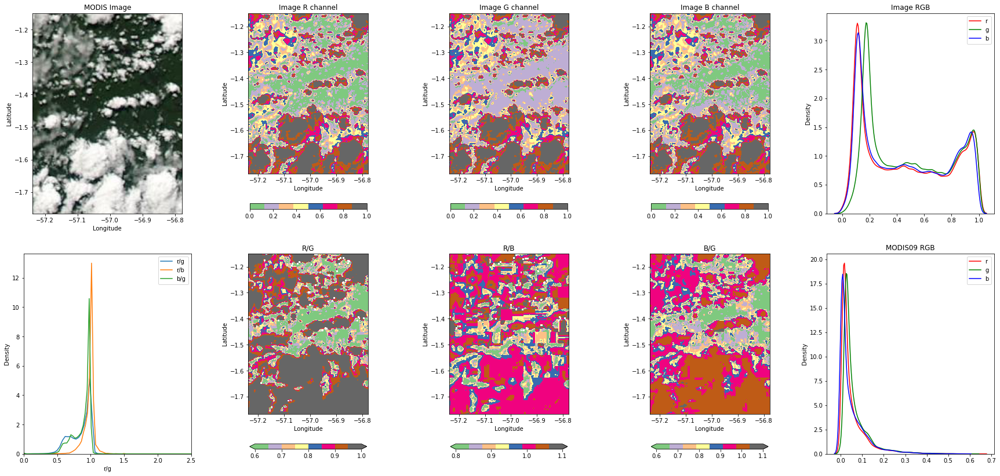

20150622_-233_-172
O2A band duration: 1.1839927740058757e-06  h
[-57.1164, -56.6564, -2.3327, -1.716]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeW

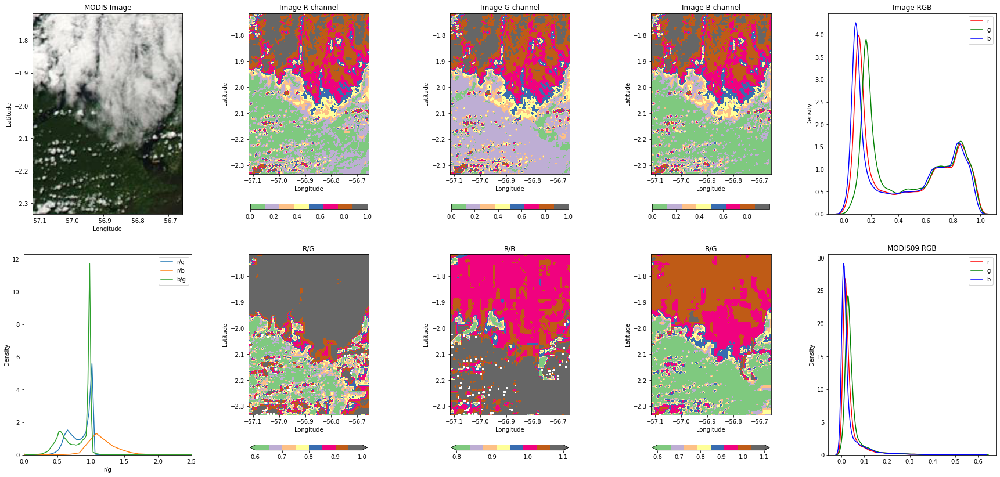

20150622_-290_-228
O2A band duration: 1.3297674983429412e-06  h
[-56.9949, -56.5349, -2.8994, -2.2827]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

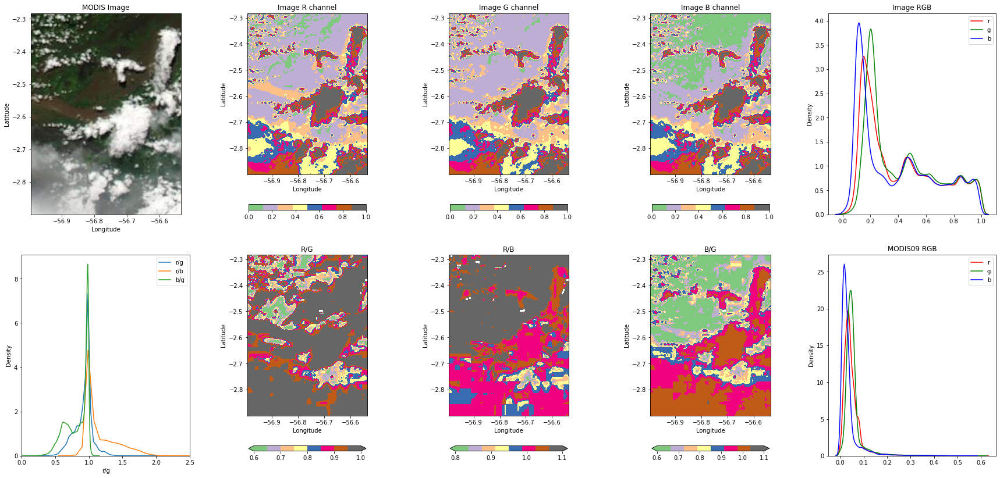

20150622_-347_-285
O2A band duration: 1.682446115106965e-06  h
[-56.8734, -56.4134, -3.4661, -2.8494]


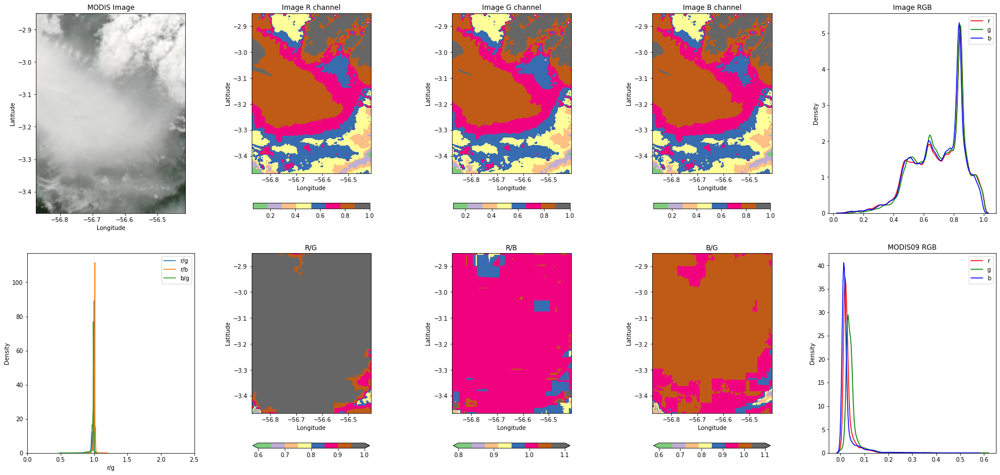

20150622_-403_-342
O2A band duration: 1.2364908373759438e-06  h
[-56.7519, -56.2919, -4.0328, -3.4161]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

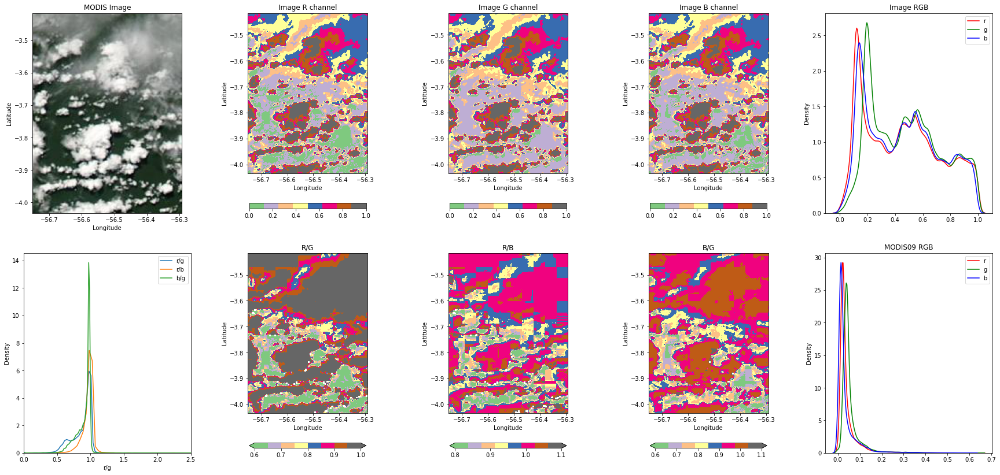

20150622_-460_-398
O2A band duration: 1.3057538874111034e-06  h
[-56.6304, -56.1704, -4.5995, -3.9828]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

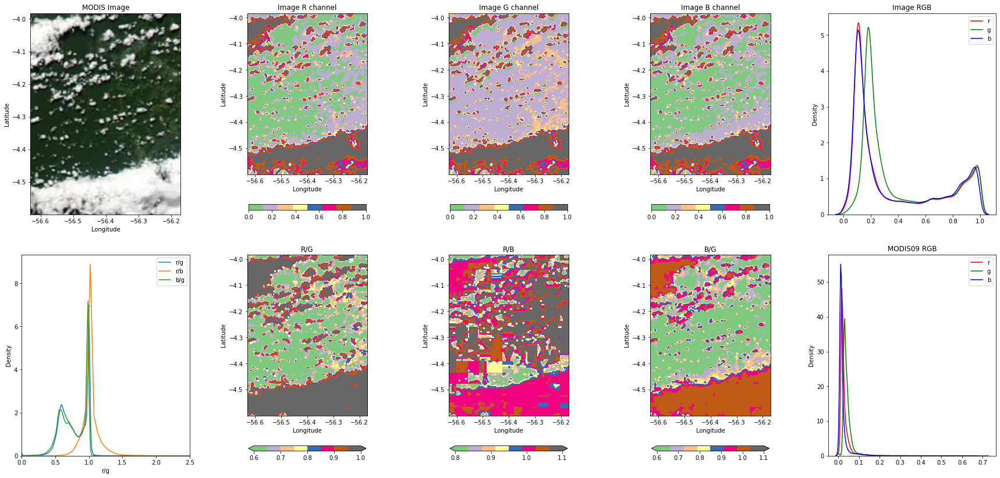

20150622_-517_-455
O2A band duration: 1.4368069484286632e-06  h
[-56.509, -56.049, -5.1662, -4.5495]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

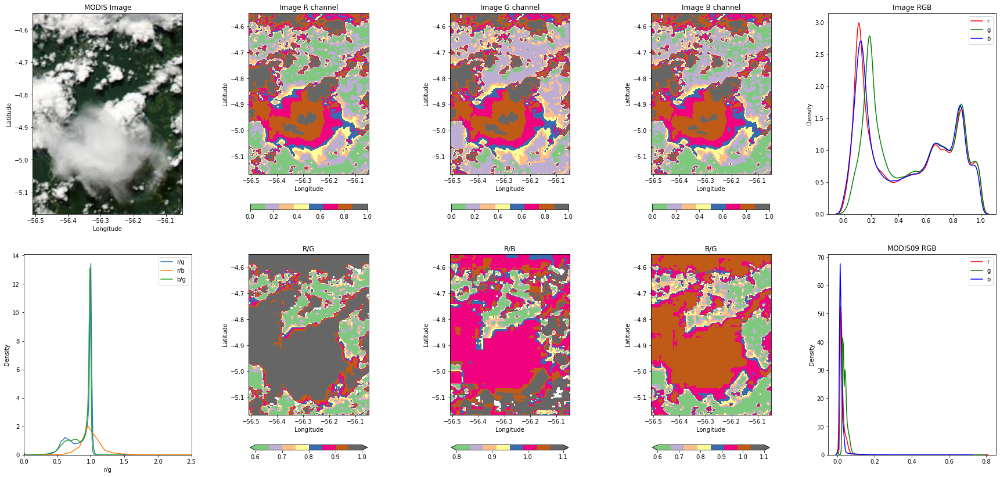

20150622_-573_-512
O2A band duration: 1.1665647212390065e-06  h
[-56.3875, -55.9275, -5.7329, -5.1162]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeW

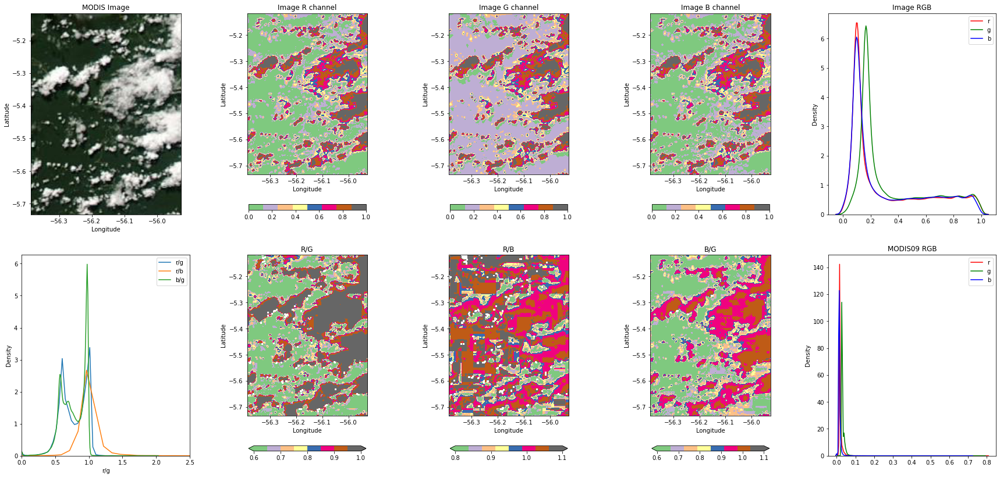

20150622_-630_-568
O2A band duration: 1.3350797235034406e-06  h
[-56.266, -55.806, -6.2997, -5.6829]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

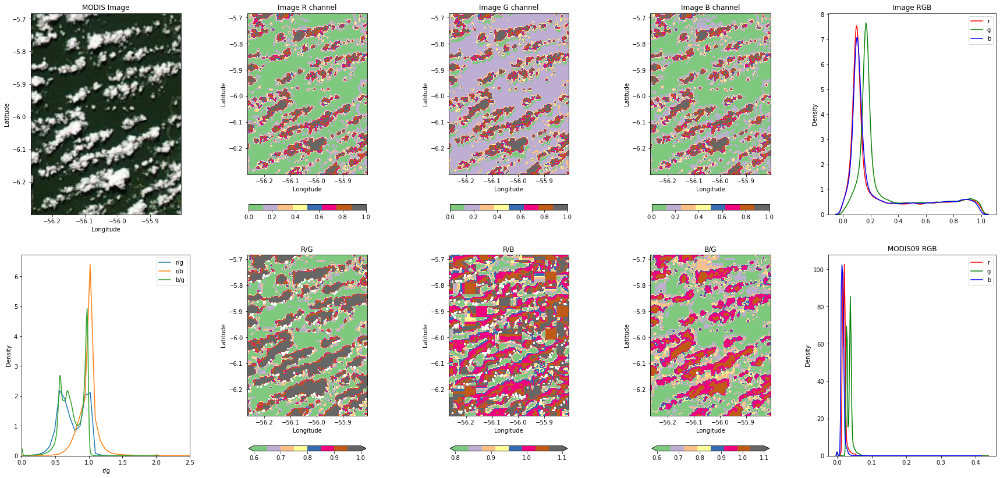

20150622_-687_-625
O2A band duration: 1.3836252765031532e-06  h
[-56.1445, -55.6845, -6.8664, -6.2497]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

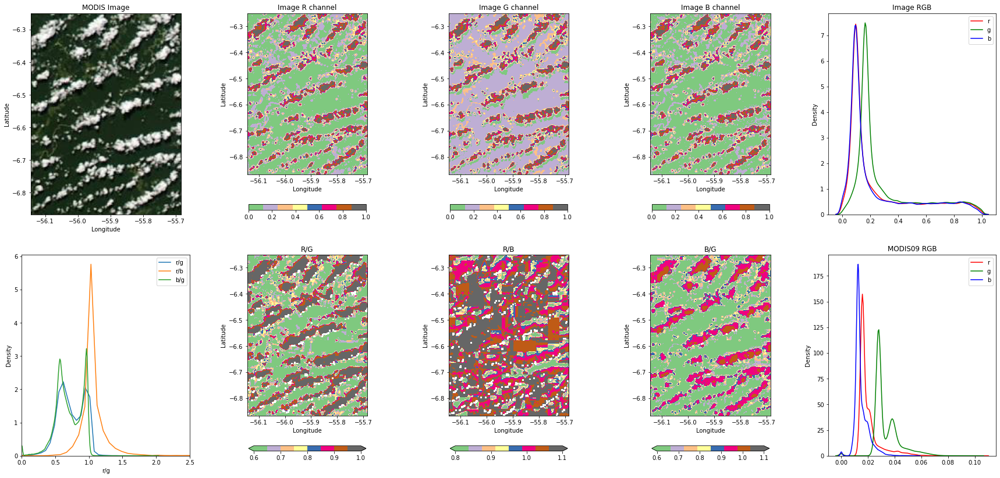

20150622_-743_-682
O2A band duration: 1.280452496656734e-06  h
[-56.023, -55.563, -7.4331, -6.8164]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWar

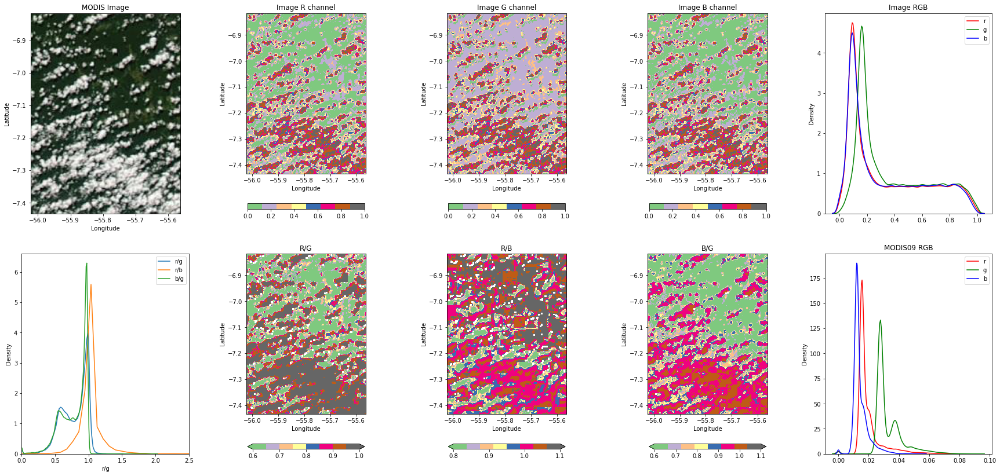

20150622_-800_-738
O2A band duration: 1.2881869446977765e-06  h
[-55.9015, -55.4415, -7.9998, -7.3831]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

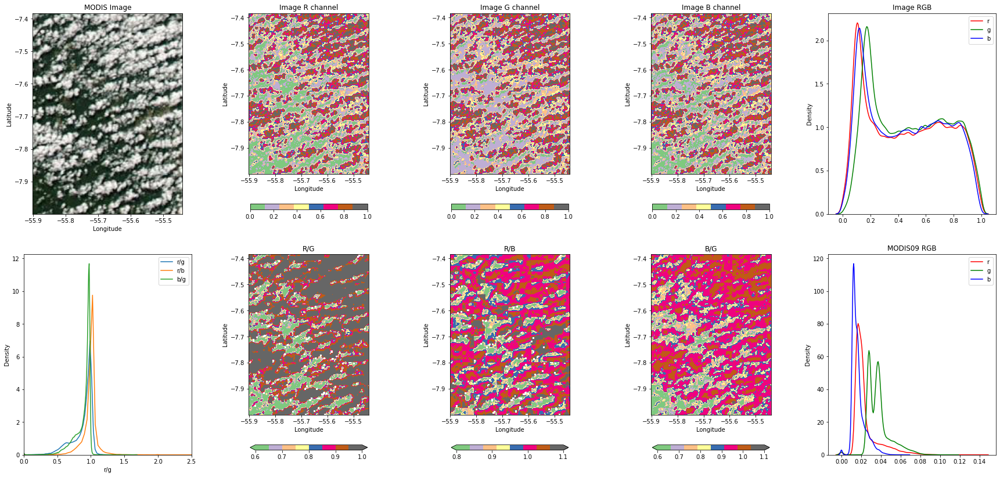

20150622_-857_-795
O2A band duration: 1.449256669729948e-06  h
[-55.78, -55.32, -8.5665, -7.9498]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: Runtime

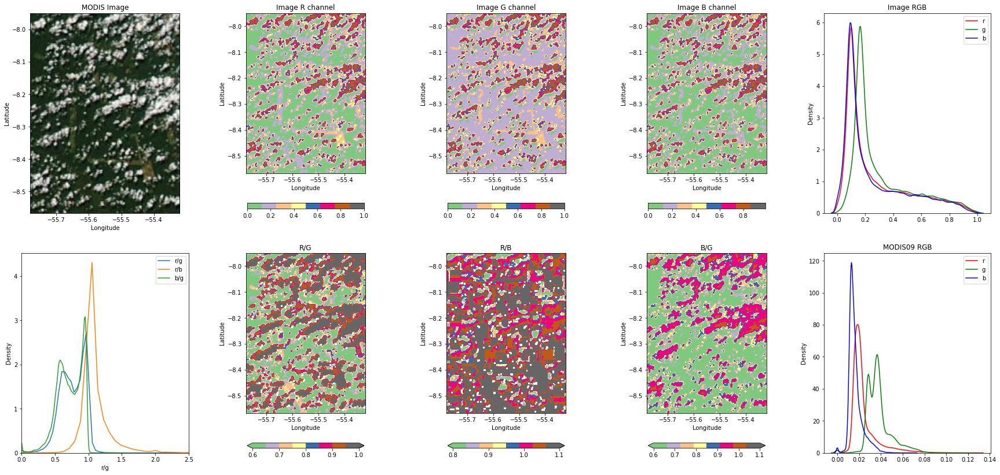

20150622_-913_-852
O2A band duration: 1.5082994408051795e-06  h
[-55.6586, -55.1986, -9.1332, -8.5165]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWa

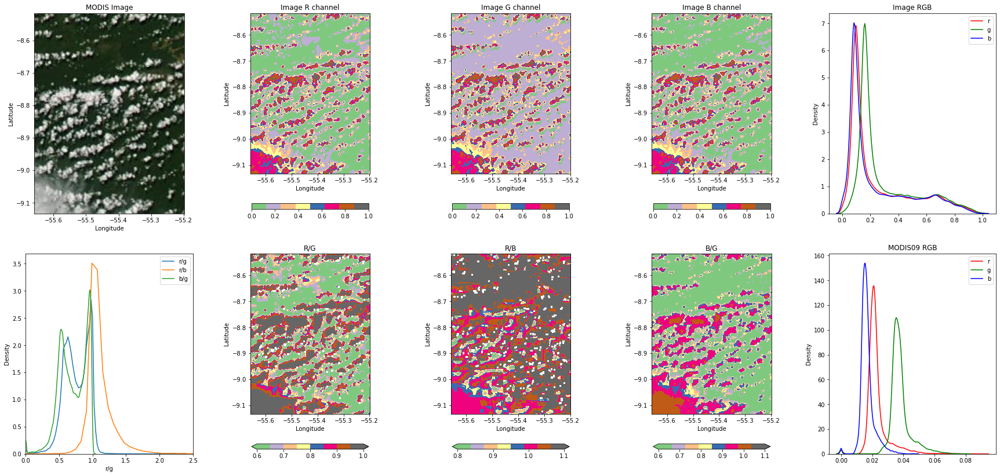

20150622_-970_-908
O2A band duration: 1.5256922213464148e-06  h
[-55.5371, -55.0771, -9.6999, -9.0832]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: Runtim

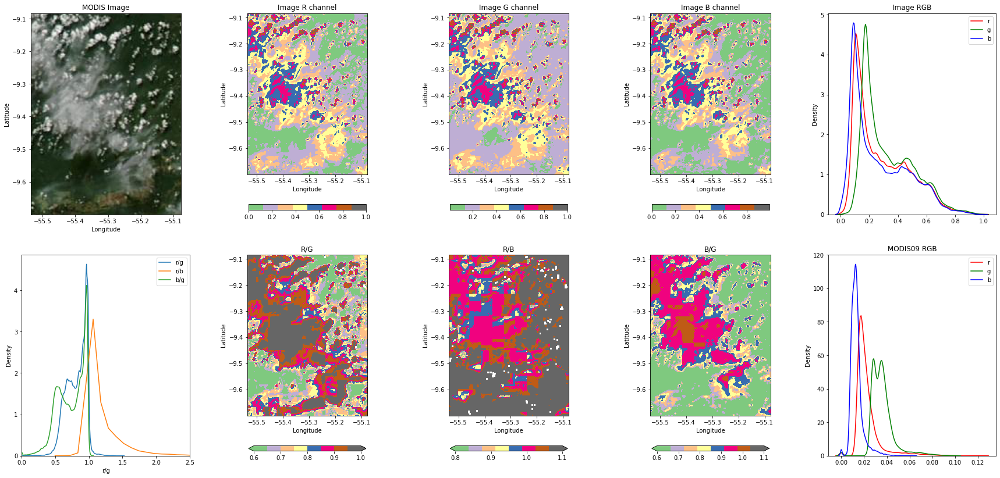

20150622_-1027_-965
O2A band duration: 1.7875786094615856e-06  h
[-55.4156, -54.9556, -10.2666, -9.6499]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


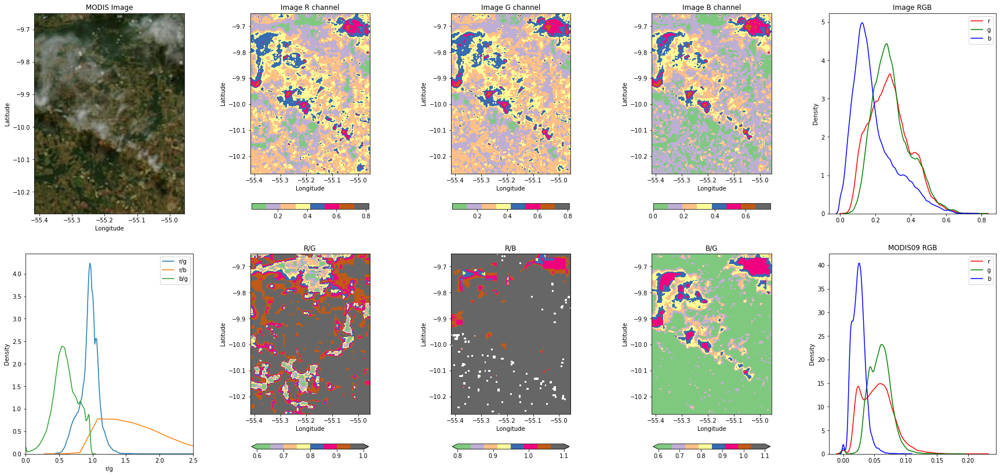

20150622_-1083_-1022
O2A band duration: 1.3615258406692496e-06  h
[-55.2941, -54.8341, -10.8333, -10.2166]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


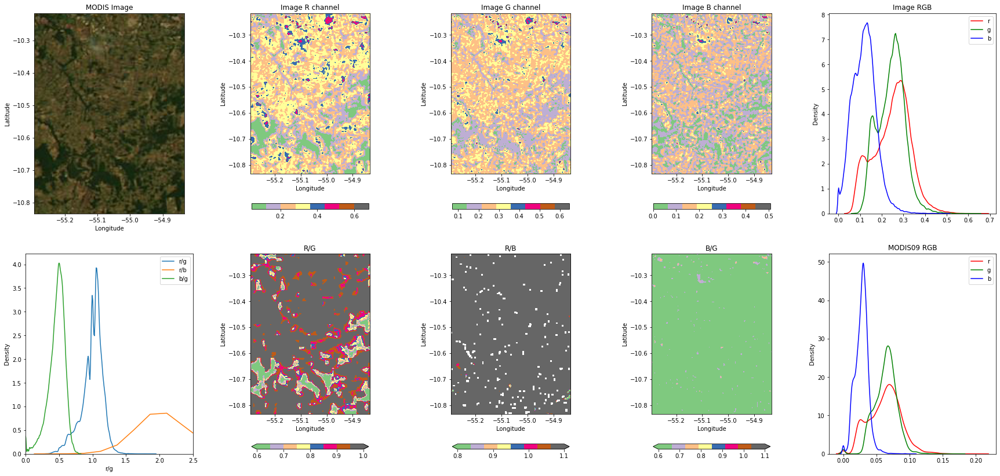

20150622_-1140_-1078
O2A band duration: 1.4401536059772803e-06  h
[-55.1726, -54.7126, -11.4, -10.7833]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


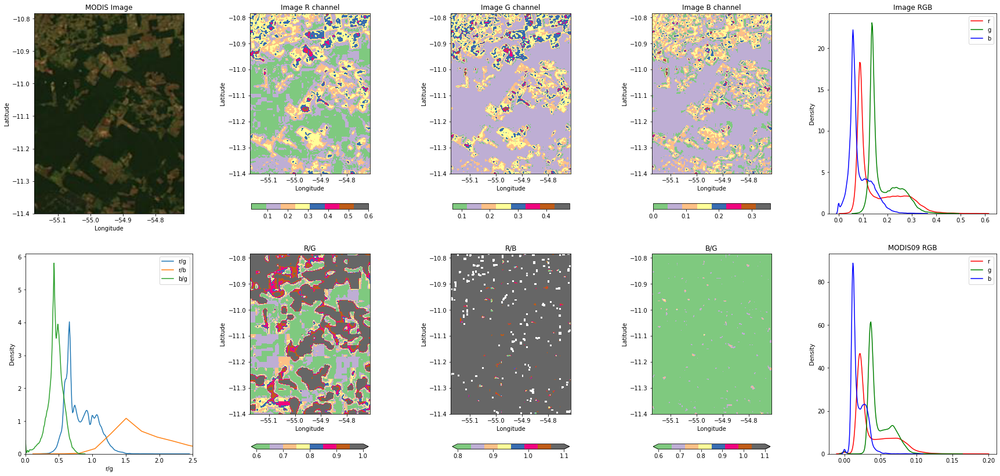

20150622_-1197_-1135
O2A band duration: 1.3840644452203479e-06  h
[-55.0511, -54.5911, -11.9668, -11.35]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: Runtim

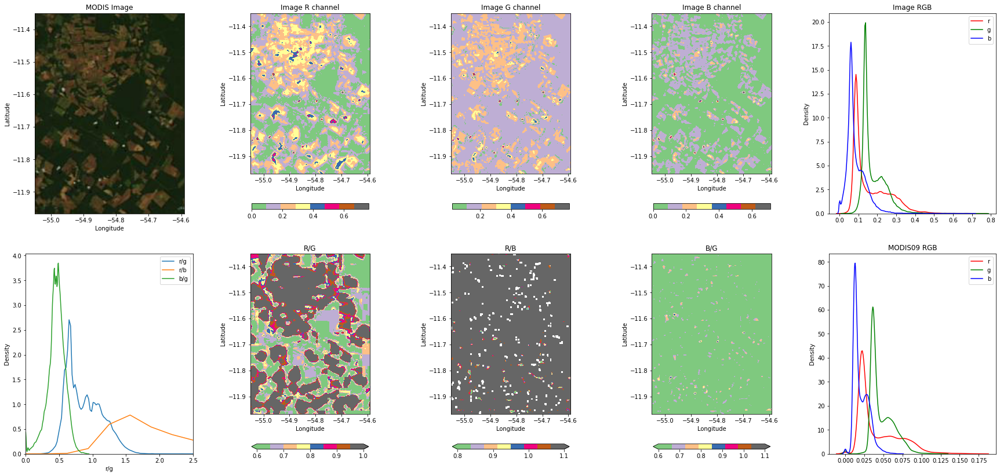

20150622_-1253_-1192
O2A band duration: 1.32724499659768e-06  h
[-54.9296, -54.4696, -12.5335, -11.9168]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


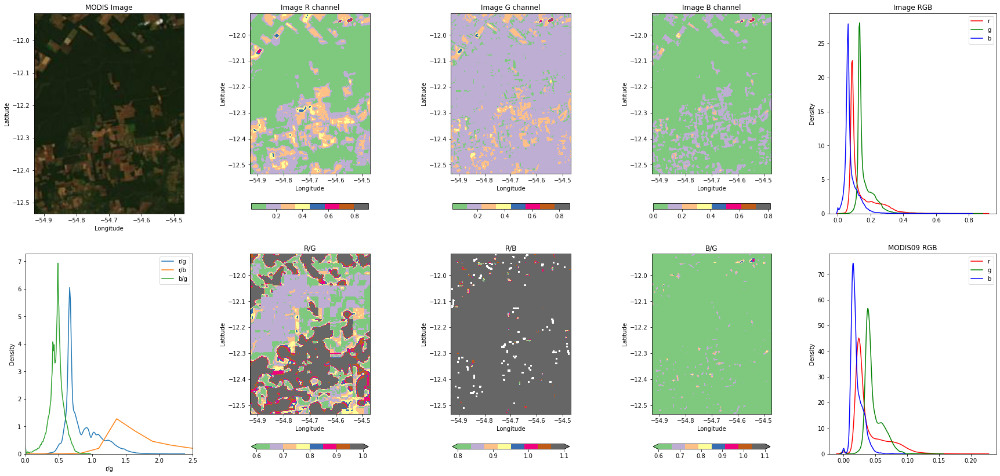

20150622_-1310_-1248
O2A band duration: 1.4900508378761717e-06  h
[-54.8082, -54.3482, -13.1002, -12.4835]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in true_divide


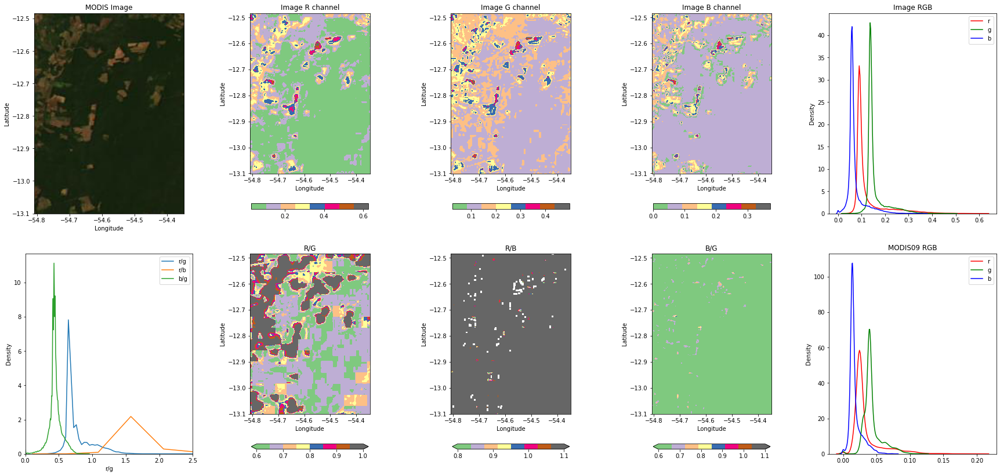

20150622_-1367_-1305
O2A band duration: 1.2181858296066316e-06  h
[-54.6867, -54.2267, -13.6669, -13.0502]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: Runtim

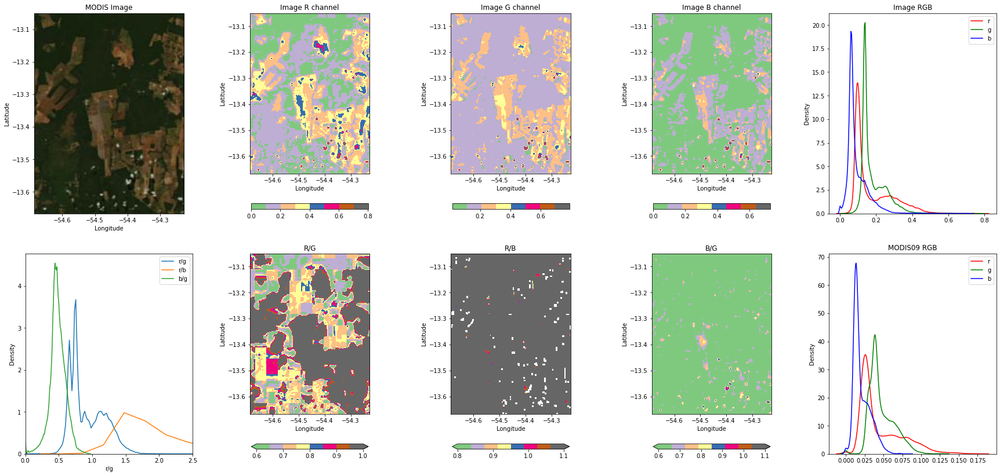

20150622_-1423_-1362
O2A band duration: 1.2618752791442806e-06  h
[-54.5652, -54.1052, -14.2336, -13.6169]


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in true_divide
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:106: Runtim

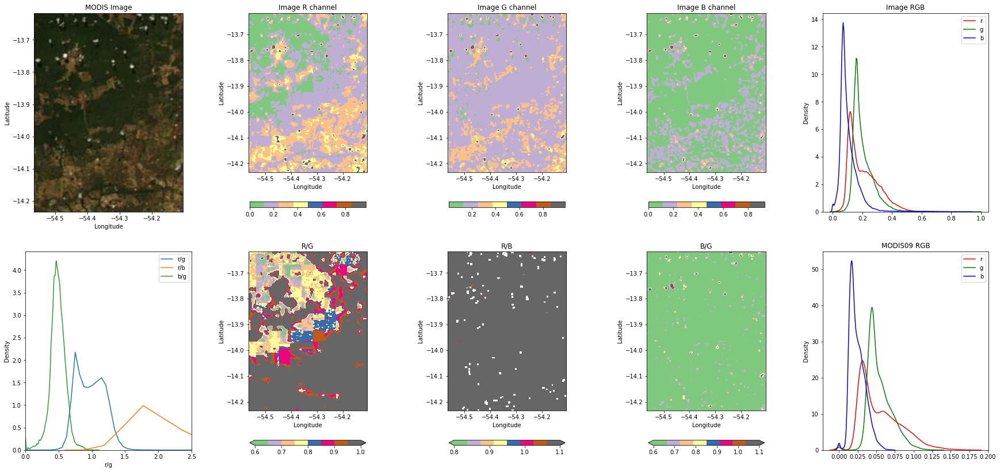

In [182]:
cfg_basename = 'cfg/20150622_{:.0f}_{:.0f}.csv'
sb = np.load('subdomain_list.npy')
img_r, img_g, img_b = [], [], []
mod09_band1, mod09_band2, mod09_band3 = [], [], []
mod09_band4, mod09_band6, mod09_band7 = [], [], []
for i in range(len(sb)):
    s, n = sb[i, 2:]
    cfg = cfg_basename.format(s*100, n*100)
    sat, cfg_info = run_sim(cfg)
    #png = [f'data/{cfg_basename[4:-4]}_20150622/aqua_rgb_2015-06-22_-55.66--55.20--9.13--8.52.png',
    #       [-57.97, -57.51, 1.63, 2.25]]
    mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][0, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][1, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band3 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][2, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band4 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][3, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band6 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][5, :], extent=sat.extent)
    lon_2d, lat_2d, mod_sfc_alb_2d_band7 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                          mod.data['ref']['data'][6, :], extent=sat.extent)

    
    f, ((ax11, ax12, ax13, ax14, ax15),
        (ax24, ax21, ax22, ax23, ax25)) =plt.subplots(2, 5, figsize=(30, 14))

    wesn= sat.extent#png[1]
    img = mpimg.imread(sat.fnames['mod_rgb'][0])
    lon_dom = sat.extent[:2]
    lat_dom = sat.extent[2:]
    print(wesn)


    ax11.imshow(img,extent=wesn)
    ax11.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax11.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax11.set_xlabel('Longitude')
    ax11.set_ylabel('Latitude')
    ax11.set_title('MODIS Image')

    cmap = 'Accent'
    cbar_karg = {'location':'bottom', 'fraction':0.05, 'shrink':0.7}
    im12 = ax12.imshow(img[:, :, 0], extent=wesn, cmap=cmap)
    ax12.set_xlabel('Longitude')
    ax12.set_ylabel('Latitude')
    ax12.set_title('Image R channel')
    f.colorbar(im12, ax=ax12, **cbar_karg)

    im13 = ax13.imshow(img[:, :, 1], extent=wesn, cmap=cmap)
    ax13.set_xlabel('Longitude')
    ax13.set_ylabel('Latitude')
    ax13.set_title('Image G channel')
    f.colorbar(im13, ax=ax13, **cbar_karg)

    im14 = ax14.imshow(img[:, :, 2], extent=wesn, cmap=cmap)
    ax14.set_xlabel('Longitude')
    ax14.set_ylabel('Latitude')
    ax14.set_title('Image B channel')
    f.colorbar(im14, ax=ax14, **cbar_karg)

    sns.kdeplot(img[:, :, 0].flatten(), ax=ax15, color='r', label='r')
    sns.kdeplot(img[:, :, 1].flatten(), ax=ax15, color='g', label='g')
    sns.kdeplot(img[:, :, 2].flatten(), ax=ax15, color='b', label='b')
    ax15.legend()
    ax15.set_title('Image RGB')

    array21 = img[:, :, 0]/img[:, :, 1]
    array21[img[:, :, 0]==0] = np.nan
    #threshold21 = 1
    #array21[array21>threshold21] = threshold21
    im21 = ax21.imshow(array21, extent=wesn, cmap=cmap, vmin=0.6, vmax=1)
    ax21.set_xlabel('Longitude')
    ax21.set_ylabel('Latitude')
    ax21.set_title('R/G')
    f.colorbar(im21, ax=ax21, extend='both', **cbar_karg)

    array22 = img[:, :, 0]/img[:, :, 2]
    array22[img[:, :, 0]==0] = np.nan
    threshold22 = 1.1
    #array22[array22>threshold22] = threshold22
    im22 = ax22.imshow(array22, extent=wesn, cmap=cmap, vmin=0.8, vmax=1.1)
    ax22.set_xlabel('Longitude')
    ax22.set_ylabel('Latitude')
    ax22.set_title('R/B')
    f.colorbar(im22, ax=ax22, extend='both', **cbar_karg)

    array23 = img[:, :, 2]/img[:, :, 1]
    array23[img[:, :, 1]==0] = np.nan
    threshold23 = 1.2
    #array23[array23>threshold23] = threshold23
    im23 = ax23.imshow(array23, extent=wesn, cmap=cmap, vmin=0.6, vmax=1.1)
    ax23.set_xlabel('Longitude')
    ax23.set_ylabel('Latitude')
    ax23.set_title('B/G')
    f.colorbar(im23, ax=ax23, extend='both', **cbar_karg)

    rgb_array = pd.DataFrame(img[:, :, :3].reshape(img.shape[0]*img.shape[1], 3),
                            columns=['r', 'g', 'b'])
    rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
    rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
    rgb_array['g/r'] = np.array(rgb_array[['g']])/np.array(rgb_array[['r']])
    rgb_array['b/r'] = np.array(rgb_array[['b']])/np.array(rgb_array[['r']])
    rgb_array['g/b'] = np.array(rgb_array[['g']])/np.array(rgb_array[['b']])
    rgb_array['b/g'] = np.array(rgb_array[['b']])/np.array(rgb_array[['g']])
    sns.kdeplot(rgb_array['r/g'], ax=ax24, label='r/g')
    sns.kdeplot(rgb_array['r/b'], ax=ax24, label='r/b')
    sns.kdeplot(rgb_array['b/g'], ax=ax24, label='b/g')
    ax24.legend()
    ax24.set_xlim(0, 2.5)

    sns.kdeplot(mod_sfc_alb_2d_band1.flatten(), ax=ax25, color='r', label='r')
    sns.kdeplot(mod_sfc_alb_2d_band4.flatten(), ax=ax25, color='g', label='g')
    sns.kdeplot(mod_sfc_alb_2d_band3.flatten(), ax=ax25, color='b', label='b')
    ax25.legend()
    ax25.set_title('MODIS09 RGB')

    plt.show()
    

In [263]:
same_lon, same_lat = [i[0] for i in same_list], [i[1] for i in same_list]
only_rgb_lon, only_rgb_lat = [i[0] for i in only_rgb], [i[1] for i in only_rgb]
only_ori_lon, only_ori_lat = [i[0] for i in only_ori], [i[1] for i in only_ori]

NameError: name 'same_lon' is not defined

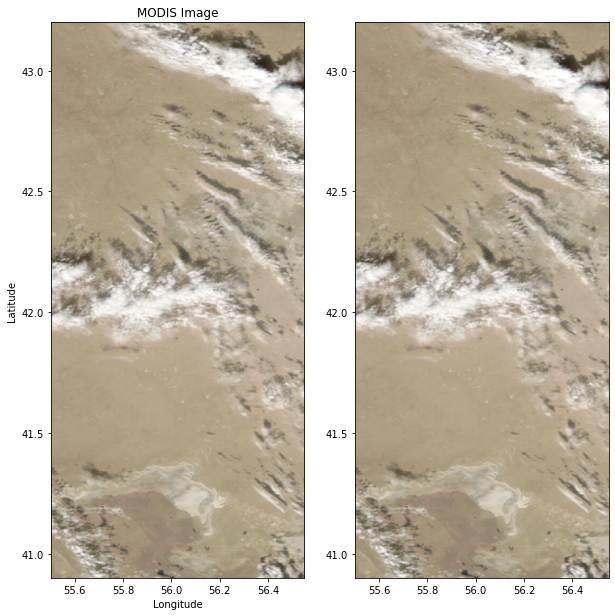

In [257]:
f, (frame1, frame2)=plt.subplots(1, 2, figsize=(10, 40))
img = png[0]
wesn= sat.extent#png[1]
img = mpimg.imread(sat.fnames['mod_rgb'][0])
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]

frame1.imshow(img,extent=wesn)
frame1.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame1.set_ylim(np.min(lat_dom), np.max(lat_dom))

frame1.set_xlabel('Longitude')
frame1.set_ylabel('Latitude')
frame1.set_title('MODIS Image')

frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))

frame2.scatter(same_lon, same_lat, s=10, edgecolor='blue', facecolor='blue',
               alpha=0.5, label='same')
frame2.scatter(only_rgb_lon, only_rgb_lat, s=10, edgecolor='r', facecolor='r',
               alpha=0.5, label='only rgb')
frame2.scatter(only_ori_lon, only_ori_lat, s=10, edgecolor='lime', facecolor='lime',
               alpha=0.5, label='only original')
frame2.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize=13)
frame2.set_xlabel('Longitude')
frame2.set_ylabel('Latitude')
frame2.set_title('Difference')

plt.show()

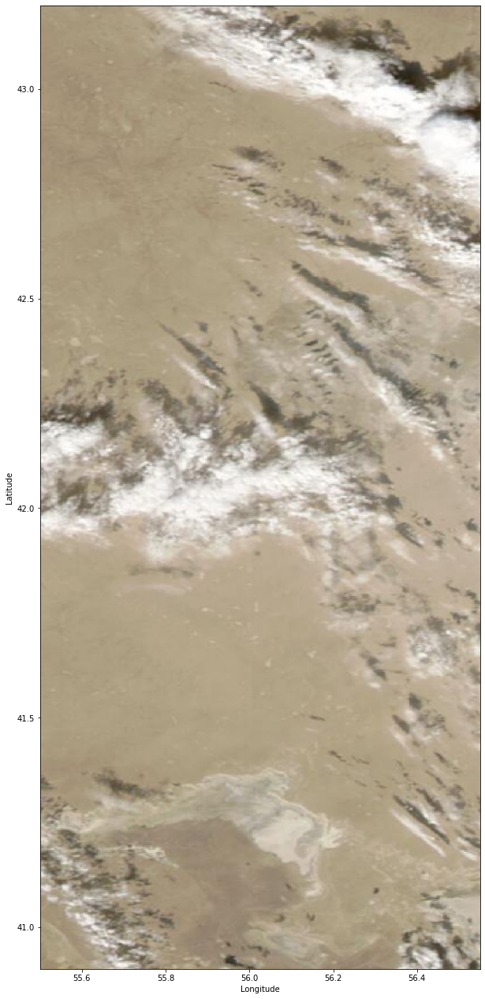

In [258]:
f,frame=plt.subplots(figsize=(10, 40))
img = png[0]
wesn= png[1]
img = mpimg.imread(sat.fnames['mod_rgb'][0])
frame.imshow(img,extent=sat.extent)
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))


"""for i in range(len(boundary_list)):
    boundary = boundary_list[i]
    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
             0.5, lat_interval, 
             frame, 'r')"""
"""for i in range(len(lon)-1):
    #frame.axvspan(lon[i], lon[i+1], lat[i], lat[i+1], alpha=0.5, color='r')
    frame.scatter(lon[i], lat[i], edgecolor='r', facecolor='none', alpha=0.5)"""
    
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

In [260]:
"""plt.hist(mod_r.flatten(), label='r', bins=100)
plt.hist(mod_g.flatten(), label='g', bins=100)
plt.hist(mod_b.flatten(), label='b', bins=100)
plt.legend()
plt.show()"""

"plt.hist(mod_r.flatten(), label='r', bins=100)\nplt.hist(mod_g.flatten(), label='g', bins=100)\nplt.hist(mod_b.flatten(), label='b', bins=100)\nplt.legend()\nplt.show()"

In [53]:
mod_rgb = mpl_img.imread(sat.fnames['mod_rgb'][0])

lon_rgb0 = np.linspace(sat.extent[0], sat.extent[1], mod_rgb.shape[1]+1)
lat_rgb0 = np.linspace(sat.extent[2], sat.extent[3], mod_rgb.shape[0]+1)
lon_rgb = (lon_rgb0[1:]+lon_rgb0[:-1])/2.0
lat_rgb = (lat_rgb0[1:]+lat_rgb0[:-1])/2.0

mod_r = mod_rgb[:, :, 0]
mod_g = mod_rgb[:, :, 1]
mod_b = mod_rgb[:, :, 2]
rgb_array = pd.DataFrame(mod_rgb.reshape(mod_rgb.shape[0]*mod_rgb.shape[1], mod_rgb.shape[2]),
                        columns=['r', 'g', 'b', 'scale'])
rgb_array['r/g'] = np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
rgb_array['r/b'] = np.array(rgb_array[['r']])/np.array(rgb_array[['b']])
rgb_array

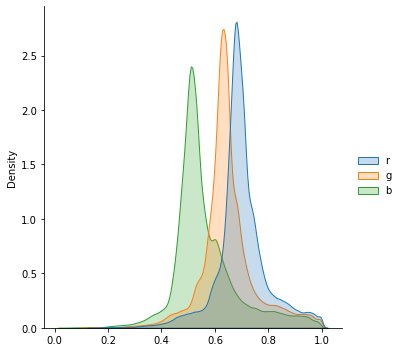

In [263]:
sns.displot(rgb_array[['r', 'g', 'b']], kind="kde", fill=True)

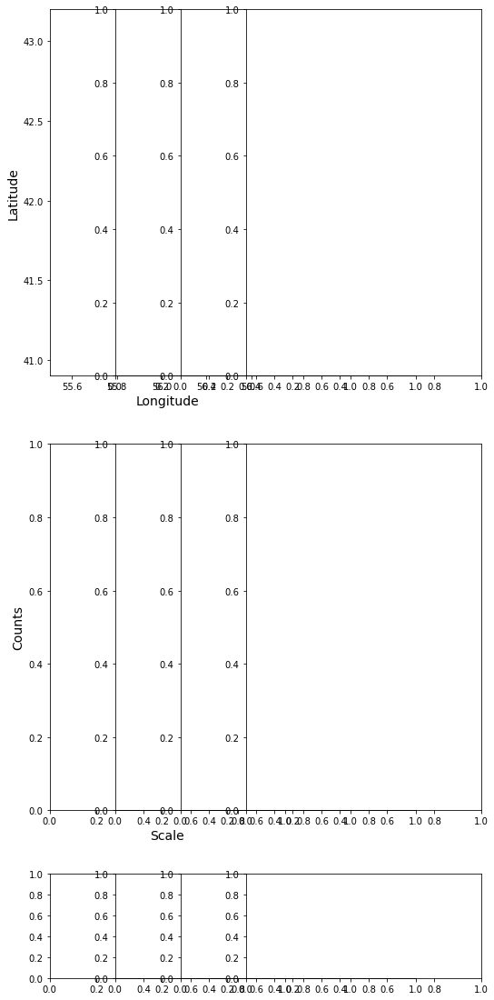

In [266]:
mod = modis_09a1(fnames=sat.fnames['mod_09'], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band1 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][0, :], extent=sat.extent)
lon_2d, lat_2d, mod_sfc_alb_2d_band2 = grid_modis_by_extent(mod.data['lon']['data'], mod.data['lat']['data'], 
                                                      mod.data['ref']['data'][1, :], extent=sat.extent)

fig = plt.figure(figsize=(4, 16))

x_interval = 0.25
ax10 = fig.add_axes([0.05+x_interval*0, 0.6, 0.9, 0.35])
ax20 = fig.add_axes([0.05+x_interval*0, 0.185, 0.9, 0.35])
ax30 = fig.add_axes([0.05+x_interval*0, 0.025, 0.9, 0.1])

ax11 = fig.add_axes([0.05+x_interval*1, 0.6, 0.9, 0.35])
ax21 = fig.add_axes([0.05+x_interval*1, 0.185, 0.9, 0.35])
ax31 = fig.add_axes([0.05+x_interval*1, 0.025, 0.9, 0.1])

ax12 = fig.add_axes([0.05+x_interval*2, 0.6, 0.9, 0.35])
ax22 = fig.add_axes([0.05+x_interval*2, 0.185, 0.9, 0.35])
ax32 = fig.add_axes([0.05+x_interval*2, 0.025, 0.9, 0.1])

ax13 = fig.add_axes([0.05+x_interval*3, 0.6, 0.9, 0.35])
ax23 = fig.add_axes([0.05+x_interval*3, 0.185, 0.9, 0.35])
ax33 = fig.add_axes([0.05+x_interval*3, 0.025, 0.9, 0.1])


label_size = 14

img = mpimg.imread(sat.fnames['mod_rgb'][0])
ax1.imshow(img,extent=sat.extent)
lon_dom = sat.extent[:2]
lat_dom = sat.extent[2:]
ax10.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax10.set_ylim(np.min(lat_dom), np.max(lat_dom))
ax10.set_xlabel('Longitude', fontsize=label_size)
ax10.set_ylabel('Latitude', fontsize=label_size)

sns.histplot(rgb_array[['r', 'g', 'b']], kde=True, fill=False, ax=ax2, color=['lightcoral', 'lightgreen', 'lightblue'])
ax20.set_xlabel('Scale', fontsize=label_size)
ax20.set_ylabel('Counts', fontsize=label_size)
ax20.set_xlim(0, 1)

#ax11.


sns.histplot(mod_sfc_alb_2d_band1.flatten(), kde=True, fill=False, ax=ax3, label='band 1:620-670nm', color='lightcoral')
sns.histplot(mod_sfc_alb_2d_band4.flatten(), kde=True, fill=False, ax=ax3, label='band 2:545-565nm')
sns.histplot(mod_sfc_alb_2d_band3.flatten(), kde=True, fill=False, ax=ax3, label='band 3:459-479nm')
ax3.set_xlabel('Mod09', fontsize=label_size)
ax3.set_ylabel('Counts', fontsize=label_size)
ax3.legend()
ax3.set_xlim(0, 1)
plt.show()

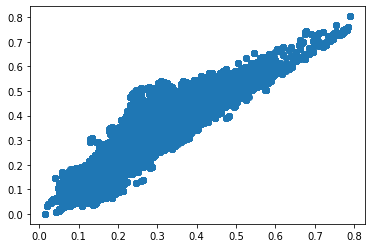

In [172]:
plt.scatter(rgb_array[['g']], rgb_array[['r']])

In [178]:
np.array(rgb_array[['r']])/np.array(rgb_array[['g']])

array([[0.75      ],
       [0.75      ],
       [0.75      ],
       ...,
       [0.87931037],
       [0.87931037],
       [0.87931037]], dtype=float32)

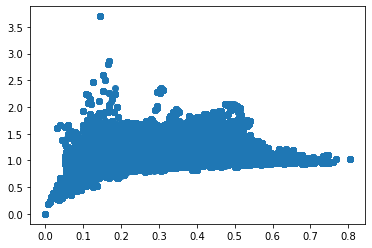

In [185]:
plt.scatter(np.array(rgb_array[['r']]), np.array(rgb_array[['r']])/np.array(rgb_array[['g']])
           )
#plt.plot([0,10], [0,10])

In [197]:
rgb_array

,r,g,b,scale,roverg
0,0.105882,0.141176,0.066667,1.0,0.750000
1,0.105882,0.141176,0.066667,1.0,0.750000
2,0.105882,0.141176,0.066667,1.0,0.750000
3,0.105882,0.141176,0.066667,1.0,0.750000
4,0.105882,0.141176,0.066667,1.0,0.750000
...,...,...,...,...,...
1376662,0.231373,0.290196,0.215686,1.0,0.797297
1376663,0.227451,0.282353,0.207843,1.0,0.805556
1376664,0.200000,0.227451,0.164706,1.0,0.879310
1376665,0.200000,0.227451,0.164706,1.0,0.879310


/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  
/Users/steven/opt/anaconda3/envs/er3t/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  


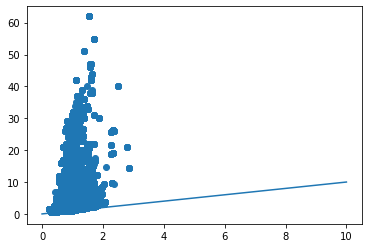

In [183]:
plt.scatter(np.array(rgb_array[['r']])/np.array(rgb_array[['g']]), 
            np.array(rgb_array[['r']])/np.array(rgb_array[['b']]))
plt.plot([0,10], [0,10])

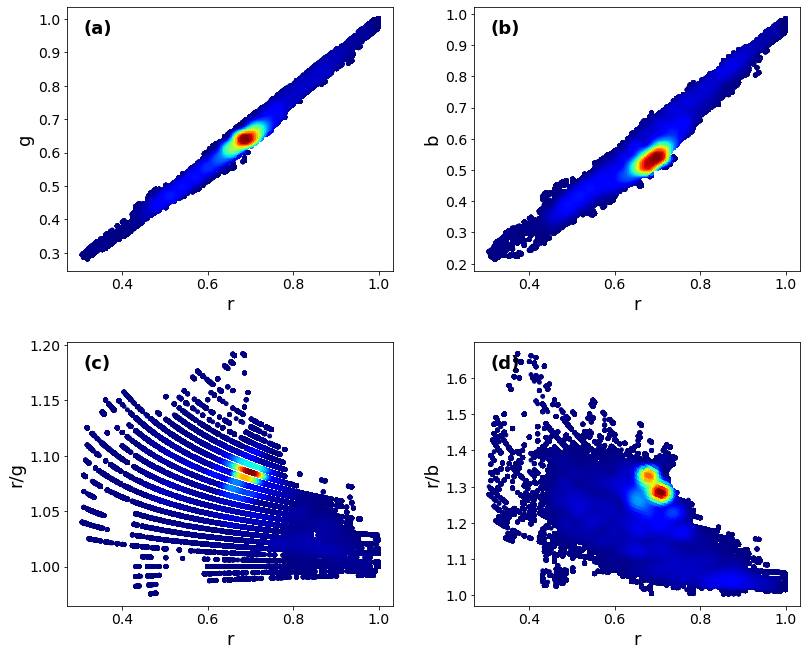

In [55]:
fig, ((ax11, ax12), (ax21, ax22)) = plt.subplots(2, 2, figsize=(12, 10), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax12, ax21, ax22]
label_size = 18
tick_size = 14
xy_list = [('r', 'g'), ('r', 'b'), ('r', 'r/g'), ('r', 'r/b')]
for i in range(4):
    ax = ax_list[i]

    x = rgb_array[xy_list[i][0]]
    y = rgb_array[xy_list[i][1]]
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=25, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    
    # plot figure
    ax.scatter(plot_x, plot_y, c=z, s=15, cmap=light_jet)
    x_array = np.array([np.min(x), np.max(x)])
    
    """
    ax.plot(x_array, x_array, 'r', label='ideal')
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
    """
    ax.set_xlabel(xy_list[i][0], fontsize=label_size)
    ax.set_ylabel(xy_list[i][1], fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    if ymax>3.8:
        ymax = 3.8
        ax.set_ylim(ymin, ymax)
    if ymin<-0.2:
        ymin = -0.2
        ax.set_ylim(ymin, ymax)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
            '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')